# Первая часть. Исследование

In [4]:
data = pd.read_csv('./train.csv')

In [6]:

# Числовые признаки
num_cols = [
    'ClientPeriod',
    'MonthlySpending',
    'TotalSpent'
]

# Категориальные признаки
cat_cols = [
    'Sex',
    'IsSeniorCitizen',
    'HasPartner',
    'HasChild',
    'HasPhoneService',
    'HasMultiplePhoneNumbers',
    'HasInternetService',
    'HasOnlineSecurityService',
    'HasOnlineBackup',
    'HasDeviceProtection',
    'HasTechSupportAccess',
    'HasOnlineTV',
    'HasMovieSubscription',
    'HasContractPhone',
    'IsBillingPaperless',
    'PaymentMethod'
]

feature_cols = num_cols + cat_cols
target_col = 'Churn'

In [10]:
data.tail()

,ClientPeriod,MonthlySpending,TotalSpent,Sex,IsSeniorCitizen,HasPartner,HasChild,HasPhoneService,HasMultiplePhoneNumbers,HasInternetService,HasOnlineSecurityService,HasOnlineBackup,HasDeviceProtection,HasTechSupportAccess,HasOnlineTV,HasMovieSubscription,HasContractPhone,IsBillingPaperless,PaymentMethod,Churn
5277,3,30.40,82.15,Male,0,No,No,No,No phone service,DSL,No,No,No,Yes,No,No,Month-to-month,No,Electronic check,0
5278,50,44.45,2188.45,Male,0,Yes,No,No,No phone service,DSL,Yes,No,No,Yes,Yes,No,One year,Yes,Bank transfer (automatic),0
5279,1,55.05,55.05,Male,0,No,No,Yes,No,DSL,No,No,Yes,Yes,No,No,Month-to-month,No,Mailed check,0
5280,29,76.00,2215.25,Female,0,No,No,Yes,Yes,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Credit card (automatic),0
5281,19,75.90,1375.6,Female,0,No,Yes,Yes,Yes,DSL,Yes,Yes,No,Yes,Yes,No,Month-to-month,Yes,Mailed check,0


In [11]:
#Подсчет кол - ва NaN по колонкам
data.isna().sum()

ClientPeriod                0
MonthlySpending             0
TotalSpent                  0
Sex                         0
IsSeniorCitizen             0
HasPartner                  0
HasChild                    0
HasPhoneService             0
HasMultiplePhoneNumbers     0
HasInternetService          0
HasOnlineSecurityService    0
HasOnlineBackup             0
HasDeviceProtection         0
HasTechSupportAccess        0
HasOnlineTV                 0
HasMovieSubscription        0
HasContractPhone            0
IsBillingPaperless          0
PaymentMethod               0
Churn                       0
dtype: int64

NaNы отсутствуют

In [14]:
#Проверка на дубликаты
data.duplicated().sum()

14

In [43]:
#Удаление дубликатов
data = data.drop_duplicates().reset_index(drop=True)
data.tail()

,ClientPeriod,MonthlySpending,TotalSpent,Sex,IsSeniorCitizen,HasPartner,HasChild,HasPhoneService,HasMultiplePhoneNumbers,HasInternetService,HasOnlineSecurityService,HasOnlineBackup,HasDeviceProtection,HasTechSupportAccess,HasOnlineTV,HasMovieSubscription,HasContractPhone,IsBillingPaperless,PaymentMethod,Churn
5263,3,30.40,82.15,Male,0,No,No,No,No phone service,DSL,No,No,No,Yes,No,No,Month-to-month,No,Electronic check,0
5264,50,44.45,2188.45,Male,0,Yes,No,No,No phone service,DSL,Yes,No,No,Yes,Yes,No,One year,Yes,Bank transfer (automatic),0
5265,1,55.05,55.05,Male,0,No,No,Yes,No,DSL,No,No,Yes,Yes,No,No,Month-to-month,No,Mailed check,0
5266,29,76.00,2215.25,Female,0,No,No,Yes,Yes,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Credit card (automatic),0
5267,19,75.90,1375.6,Female,0,No,Yes,Yes,Yes,DSL,Yes,Yes,No,Yes,Yes,No,Month-to-month,Yes,Mailed check,0


In [69]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5268 entries, 0 to 5267
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ClientPeriod              5268 non-null   int64  
 1   MonthlySpending           5268 non-null   float64
 2   TotalSpent                5268 non-null   object 
 3   Sex                       5268 non-null   object 
 4   IsSeniorCitizen           5268 non-null   int64  
 5   HasPartner                5268 non-null   object 
 6   HasChild                  5268 non-null   object 
 7   HasPhoneService           5268 non-null   object 
 8   HasMultiplePhoneNumbers   5268 non-null   object 
 9   HasInternetService        5268 non-null   object 
 10  HasOnlineSecurityService  5268 non-null   object 
 11  HasOnlineBackup           5268 non-null   object 
 12  HasDeviceProtection       5268 non-null   object 
 13  HasTechSupportAccess      5268 non-null   object 
 14  HasOnlin

Заметим, что тип данных признака "TotalSpent" - object

In [71]:
data['TotalSpent'] = pd.to_numeric(data['TotalSpent'], errors='coerce')

In [72]:
data.isna().sum()

ClientPeriod                0
MonthlySpending             0
TotalSpent                  9
Sex                         0
IsSeniorCitizen             0
HasPartner                  0
HasChild                    0
HasPhoneService             0
HasMultiplePhoneNumbers     0
HasInternetService          0
HasOnlineSecurityService    0
HasOnlineBackup             0
HasDeviceProtection         0
HasTechSupportAccess        0
HasOnlineTV                 0
HasMovieSubscription        0
HasContractPhone            0
IsBillingPaperless          0
PaymentMethod               0
Churn                       0
dtype: int64

После преобразования осталось 9 NaN

In [81]:
#Удаление NaN
data = data.dropna().reset_index(drop=True)
data.tail()


,level_0,index,ClientPeriod,MonthlySpending,TotalSpent,Sex,IsSeniorCitizen,HasPartner,HasChild,HasPhoneService,...,HasOnlineSecurityService,HasOnlineBackup,HasDeviceProtection,HasTechSupportAccess,HasOnlineTV,HasMovieSubscription,HasContractPhone,IsBillingPaperless,PaymentMethod,Churn
5254,5254,5254,3,30.40,82.15,Male,0,No,No,No,...,No,No,No,Yes,No,No,Month-to-month,No,Electronic check,0
5255,5255,5255,50,44.45,2188.45,Male,0,Yes,No,No,...,Yes,No,No,Yes,Yes,No,One year,Yes,Bank transfer (automatic),0
5256,5256,5256,1,55.05,55.05,Male,0,No,No,Yes,...,No,No,Yes,Yes,No,No,Month-to-month,No,Mailed check,0
5257,5257,5257,29,76.00,2215.25,Female,0,No,No,Yes,...,No,No,No,No,No,No,Month-to-month,Yes,Credit card (automatic),0
5258,5258,5258,19,75.90,1375.60,Female,0,No,Yes,Yes,...,Yes,Yes,No,Yes,Yes,No,Month-to-month,Yes,Mailed check,0


Построение гистограм для числовых признаков

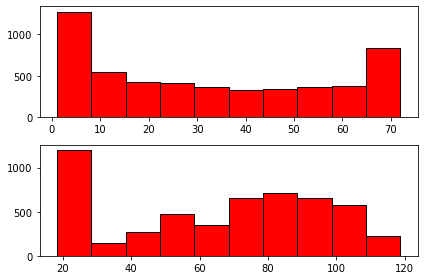

In [87]:

fig, (h1, h2) = plt.subplots(nrows=2)
h1.hist(data['ClientPeriod'], color='red', edgecolor='black')
h2.hist(data['MonthlySpending'], color='red', edgecolor='black')
fig.tight_layout()
plt.show()

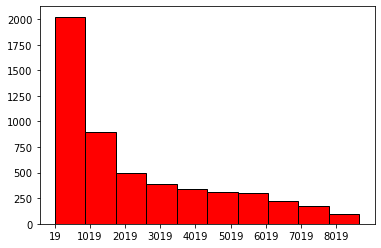

In [90]:
plt.hist(data['TotalSpent'], color='red', edgecolor='black')
plt.xticks(np.arange(min(data['TotalSpent']), max(data['TotalSpent'])+1, 1000.0))
plt.show()

Построение boxplot для числовых признаков

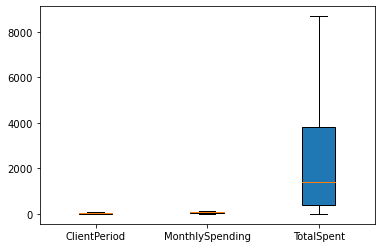

In [88]:
box_plot_data=[data['ClientPeriod'], data['MonthlySpending'], data['TotalSpent']]
plt.boxplot(box_plot_data,patch_artist=True,labels=['ClientPeriod', 'MonthlySpending', 'TotalSpent'])
plt.show()

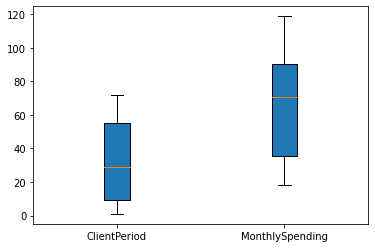

In [89]:
box_plot_data=[data['ClientPeriod'], data['MonthlySpending']]
plt.boxplot(box_plot_data,patch_artist=True,labels=['ClientPeriod', 'MonthlySpending'])
plt.show()

Построение bar для кат. признаков

In [93]:
cat_cols = [
    'Sex',
    'IsSeniorCitizen',
    'HasPartner',
    'HasChild',
    'HasPhoneService',
    'HasMultiplePhoneNumbers',
    'HasInternetService',
    'HasOnlineSecurityService',
    'HasOnlineBackup',
    'HasDeviceProtection',
    'HasTechSupportAccess',
    'HasOnlineTV',
    'HasMovieSubscription',
    'HasContractPhone',
    'IsBillingPaperless',
    'PaymentMethod'
]

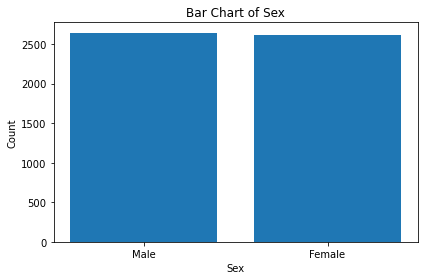

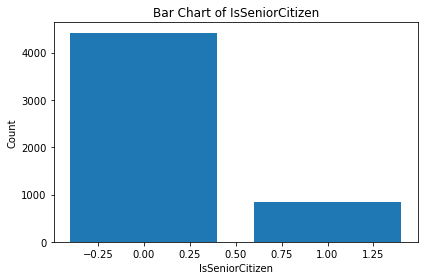

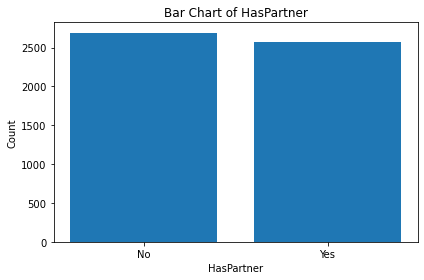

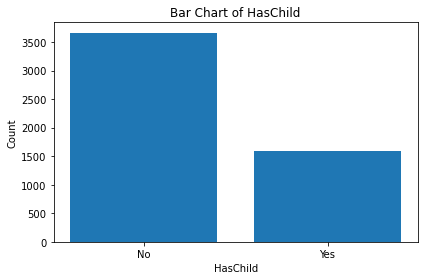

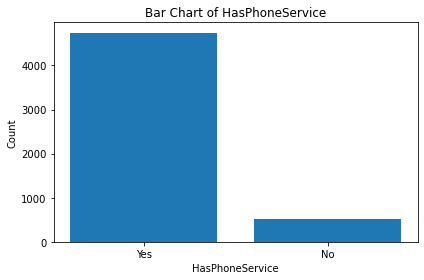

...

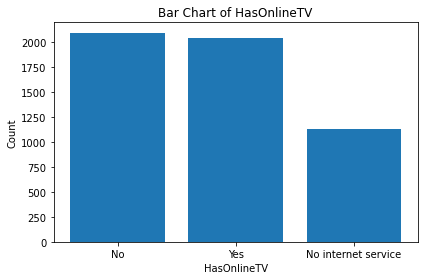

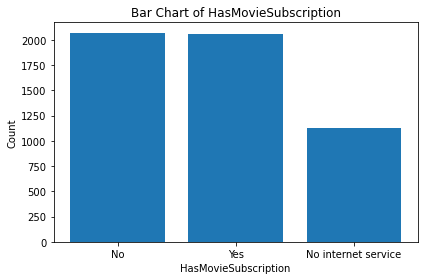

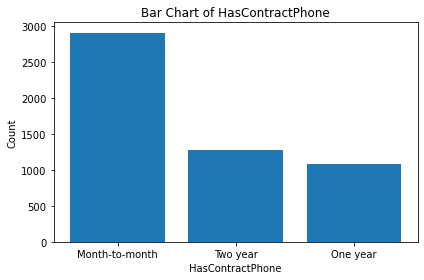

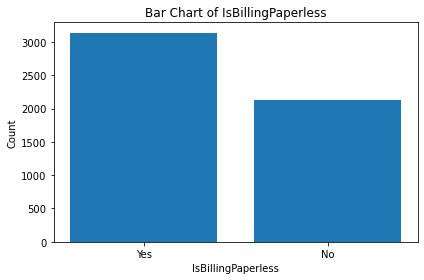

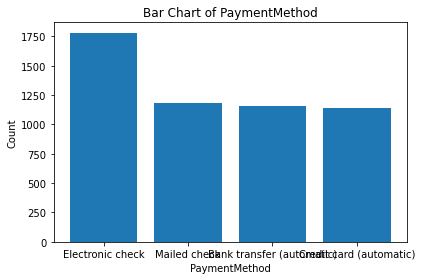

In [96]:
for col in cat_cols:
    df = data[col].value_counts()
    plt.bar(df.index, df.values)
    plt.xlabel(col)
    plt.ylabel('Count')
    plt.title(f'Bar Chart of {col}')
    plt.tight_layout()
    plt.show()

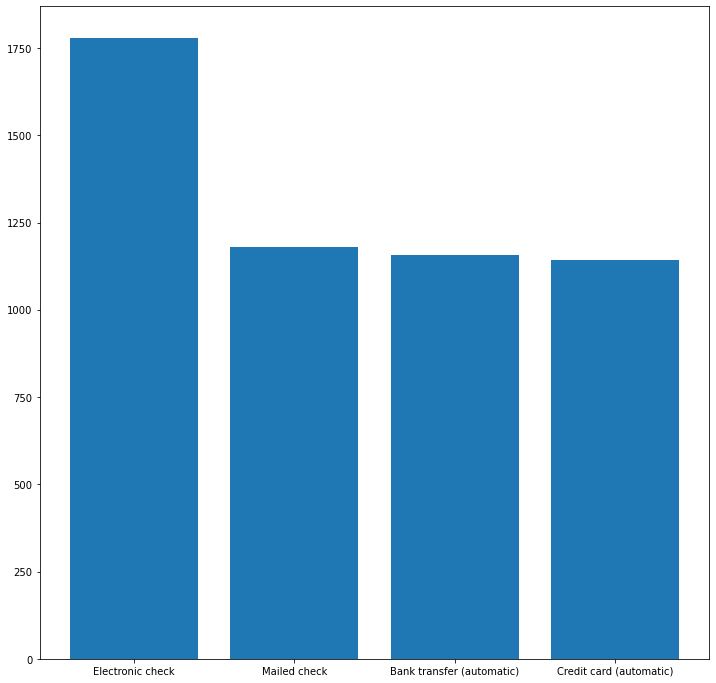

In [107]:
fig, ax = plt.subplots(figsize=(12,12))
col = 'PaymentMethod'
df = data[col].value_counts()
ax.bar(df.index, df.values)
plt.show()

Таргет

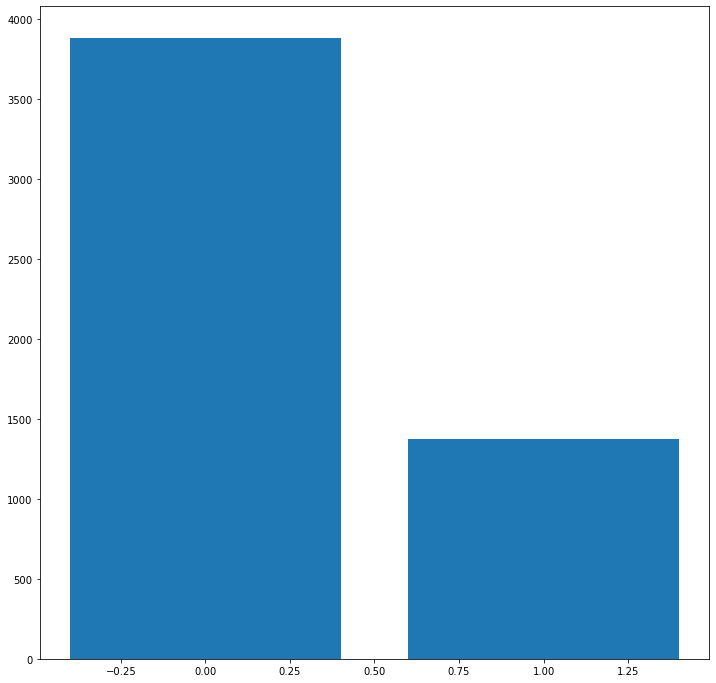

In [109]:
fig, ax = plt.subplots(figsize=(12,12))
col = 'Churn'
df = data[col].value_counts()
ax.bar(df.index, df.values)
plt.show()

Вывод: фичи  'HasContractPhone', 'IsSeniorCitizen', 'HasPhoneService', 'HasMultiplePhoneNumbers', а также целевой признак 'Churn' - являются несбалансированными

In [112]:
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, OneHotEncoder
from sklearn.pipeline import make_pipeline

1) Подготовка данных

In [125]:
test = pd.read_csv('./test.csv')

In [159]:
#Создадим копию дс
data1 = data
test1 = test

In [160]:
test1['TotalSpent'] = pd.to_numeric(test1['TotalSpent'], errors='coerce')
test1['TotalSpent'] = test1['TotalSpent'].fillna(test1['TotalSpent'].mean())
test1.tail()

,ClientPeriod,MonthlySpending,TotalSpent,Sex,IsSeniorCitizen,HasPartner,HasChild,HasPhoneService,HasMultiplePhoneNumbers,HasInternetService,HasOnlineSecurityService,HasOnlineBackup,HasDeviceProtection,HasTechSupportAccess,HasOnlineTV,HasMovieSubscription,HasContractPhone,IsBillingPaperless,PaymentMethod
1756,71,105.15,7555.00,Female,0,Yes,No,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,Yes,Two year,Yes,Bank transfer (automatic)
1757,13,20.85,272.35,Female,0,Yes,Yes,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check
1758,2,91.45,171.45,Male,0,Yes,No,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,No,Month-to-month,Yes,Electronic check
1759,19,89.10,1620.80,Female,0,Yes,No,Yes,Yes,Fiber optic,No,Yes,No,No,No,Yes,Month-to-month,Yes,Electronic check
1760,72,65.60,4566.50,Male,0,No,No,No,No phone service,DSL,Yes,Yes,Yes,Yes,Yes,Yes,Two year,Yes,Bank transfer (automatic)


In [161]:
scaler = StandardScaler()
data1[num_cols] = scaler.fit_transform(data[num_cols])
test1[num_cols] = scaler.fit_transform(test1[num_cols])
print(data1.tail())
print(test1.tail())

      level_0  index  ClientPeriod  MonthlySpending  TotalSpent     Sex  \
5254     5254   5254     -1.205000        -1.146985   -0.976363    Male   
5255     5255   5255      0.712489        -0.681361   -0.048007    Male   
5256     5256   5256     -1.286596        -0.330071   -0.988307    Male   
5257     5257   5257     -0.144262         0.364222   -0.036195  Female   
5258     5258   5258     -0.552238         0.360908   -0.406272  Female   

      IsSeniorCitizen HasPartner HasChild HasPhoneService  ...  \
5254                0         No       No              No  ...   
5255                0        Yes       No              No  ...   
5256                0         No       No             Yes  ...   
5257                0         No       No             Yes  ...   
5258                0         No      Yes             Yes  ...   

     HasOnlineSecurityService HasOnlineBackup HasDeviceProtection  \
5254                       No              No                  No   
5255          

In [162]:
data1 = data1.drop(columns=['level_0', 'index'])

In [163]:
data1 = pd.get_dummies(data1, columns=[
    'Sex',
    'IsSeniorCitizen',
    'HasPartner',
    'HasChild',
    'HasPhoneService',
    'HasMultiplePhoneNumbers',
    'HasInternetService',
    'HasOnlineSecurityService',
    'HasOnlineBackup',
    'HasDeviceProtection',
    'HasTechSupportAccess',
    'HasOnlineTV',
    'HasMovieSubscription',
    'HasContractPhone',
    'IsBillingPaperless',
    'PaymentMethod'
])
data1.tail()

,ClientPeriod,MonthlySpending,TotalSpent,Churn,Sex_Female,Sex_Male,IsSeniorCitizen_0,IsSeniorCitizen_1,HasPartner_No,HasPartner_Yes,...,HasMovieSubscription_Yes,HasContractPhone_Month-to-month,HasContractPhone_One year,HasContractPhone_Two year,IsBillingPaperless_No,IsBillingPaperless_Yes,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
5254,-1.205000,-1.146985,-0.976363,0,0,1,1,0,1,0,...,0,1,0,0,1,0,0,0,1,0
5255,0.712489,-0.681361,-0.048007,0,0,1,1,0,0,1,...,0,0,1,0,0,1,1,0,0,0
5256,-1.286596,-0.330071,-0.988307,0,0,1,1,0,1,0,...,0,1,0,0,1,0,0,0,0,1
5257,-0.144262,0.364222,-0.036195,0,1,0,1,0,1,0,...,0,1,0,0,0,1,0,1,0,0
5258,-0.552238,0.360908,-0.406272,0,1,0,1,0,1,0,...,0,1,0,0,0,1,0,0,0,1


In [165]:
test1 = pd.get_dummies(test1, columns=[
    'Sex',
    'IsSeniorCitizen',
    'HasPartner',
    'HasChild',
    'HasPhoneService',
    'HasMultiplePhoneNumbers',
    'HasInternetService',
    'HasOnlineSecurityService',
    'HasOnlineBackup',
    'HasDeviceProtection',
    'HasTechSupportAccess',
    'HasOnlineTV',
    'HasMovieSubscription',
    'HasContractPhone',
    'IsBillingPaperless',
    'PaymentMethod'
])
test1.tail()

,ClientPeriod,MonthlySpending,TotalSpent,Sex_Female,Sex_Male,IsSeniorCitizen_0,IsSeniorCitizen_1,HasPartner_No,HasPartner_Yes,HasChild_No,...,HasMovieSubscription_Yes,HasContractPhone_Month-to-month,HasContractPhone_One year,HasContractPhone_Two year,IsBillingPaperless_No,IsBillingPaperless_Yes,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
1756,1.574279,1.370619,2.344816,1,0,1,0,0,1,1,...,1,0,0,1,0,1,1,0,0,0
1757,-0.784715,-1.455959,-0.879623,1,0,1,0,0,1,0,...,0,0,0,1,1,0,0,0,0,1
1758,-1.232110,0.911258,-0.924298,0,1,1,0,0,1,1,...,0,1,0,0,0,1,0,0,1,0
1759,-0.540681,0.832463,-0.282589,1,0,1,0,0,1,1,...,1,1,0,0,0,1,0,0,1,0
1760,1.614952,0.044508,1.021639,0,1,1,0,1,0,1,...,1,0,0,1,0,1,1,0,0,0


Сверим колонки датасетов

In [143]:
print(data1.columns)

Index(['ClientPeriod', 'MonthlySpending', 'TotalSpent', 'Churn', 'Sex_Female',
       'Sex_Male', 'IsSeniorCitizen_0', 'IsSeniorCitizen_1', 'HasPartner_No',
       'HasPartner_Yes', 'HasChild_No', 'HasChild_Yes', 'HasPhoneService_No',
       'HasPhoneService_Yes', 'HasMultiplePhoneNumbers_No',
       'HasMultiplePhoneNumbers_No phone service',
       'HasMultiplePhoneNumbers_Yes', 'HasInternetService_DSL',
       'HasInternetService_Fiber optic', 'HasInternetService_No',
       'HasOnlineSecurityService_No',
       'HasOnlineSecurityService_No internet service',
       'HasOnlineSecurityService_Yes', 'HasOnlineBackup_No',
       'HasOnlineBackup_No internet service', 'HasOnlineBackup_Yes',
       'HasDeviceProtection_No', 'HasDeviceProtection_No internet service',
       'HasDeviceProtection_Yes', 'HasTechSupportAccess_No',
       'HasTechSupportAccess_No internet service', 'HasTechSupportAccess_Yes',
       'HasOnlineTV_No', 'HasOnlineTV_No internet service', 'HasOnlineTV_Yes',
      

In [144]:
print(test1.columns)

Index(['ClientPeriod', 'MonthlySpending', 'TotalSpent', 'Sex_Female',
       'Sex_Male', 'IsSeniorCitizen_0', 'IsSeniorCitizen_1', 'HasPartner_No',
       'HasPartner_Yes', 'HasChild_No', 'HasChild_Yes', 'HasPhoneService_No',
       'HasPhoneService_Yes', 'HasMultiplePhoneNumbers_No',
       'HasMultiplePhoneNumbers_No phone service',
       'HasMultiplePhoneNumbers_Yes', 'HasInternetService_DSL',
       'HasInternetService_Fiber optic', 'HasInternetService_No',
       'HasOnlineSecurityService_No',
       'HasOnlineSecurityService_No internet service',
       'HasOnlineSecurityService_Yes', 'HasOnlineBackup_No',
       'HasOnlineBackup_No internet service', 'HasOnlineBackup_Yes',
       'HasDeviceProtection_No', 'HasDeviceProtection_No internet service',
       'HasDeviceProtection_Yes', 'HasTechSupportAccess_No',
       'HasTechSupportAccess_No internet service', 'HasTechSupportAccess_Yes',
       'HasOnlineTV_No', 'HasOnlineTV_No internet service', 'HasOnlineTV_Yes',
       'HasMovi

In [166]:
y_train = data1['Churn']
X_train = data1.drop(columns=['Churn'])
X_train.tail()

,ClientPeriod,MonthlySpending,TotalSpent,Sex_Female,Sex_Male,IsSeniorCitizen_0,IsSeniorCitizen_1,HasPartner_No,HasPartner_Yes,HasChild_No,...,HasMovieSubscription_Yes,HasContractPhone_Month-to-month,HasContractPhone_One year,HasContractPhone_Two year,IsBillingPaperless_No,IsBillingPaperless_Yes,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
5254,-1.205000,-1.146985,-0.976363,0,1,1,0,1,0,1,...,0,1,0,0,1,0,0,0,1,0
5255,0.712489,-0.681361,-0.048007,0,1,1,0,0,1,1,...,0,0,1,0,0,1,1,0,0,0
5256,-1.286596,-0.330071,-0.988307,0,1,1,0,1,0,1,...,0,1,0,0,1,0,0,0,0,1
5257,-0.144262,0.364222,-0.036195,1,0,1,0,1,0,1,...,0,1,0,0,0,1,0,1,0,0
5258,-0.552238,0.360908,-0.406272,1,0,1,0,1,0,0,...,0,1,0,0,0,1,0,0,0,1


In [167]:
#Реализация подбора гиперпараметров, оценки точности кросс - валидацией
lreg1_grid_search = GridSearchCV(LogisticRegression(),
                               [{'penalty': ['l1', 'l2', 'elasticnet'], 'C': [0.001, 0.01, 0.1, 1, 10, 100]  }],
                               cv=5,
                               verbose=10,
                               scoring = 'roc_auc')

In [168]:
lreg1_grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 18 candidates, totalling 90 fits
[CV 1/5; 1/18] START C=0.001, penalty=l1........................................
[CV 1/5; 1/18] END ...........C=0.001, penalty=l1;, score=nan total time=   0.0s
[CV 2/5; 1/18] START C=0.001, penalty=l1........................................
[CV 2/5; 1/18] END ...........C=0.001, penalty=l1;, score=nan total time=   0.0s
[CV 3/5; 1/18] START C=0.001, penalty=l1........................................
[CV 3/5; 1/18] END ...........C=0.001, penalty=l1;, score=nan total time=   0.0s
[CV 4/5; 1/18] START C=0.001, penalty=l1........................................
[CV 4/5; 1/18] END ...........C=0.001, penalty=l1;, score=nan total time=   0.0s
[CV 5/5; 1/18] START C=0.001, penalty=l1........................................
[CV 5/5; 1/18] END ...........C=0.001, penalty=l1;, score=nan total time=   0.0s
[CV 1/5; 2/18] START C=0.001, penalty=l2........................................
[CV 1/5; 2/18] END .........C=0.001, penalty=l2;

c:\Users\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_o

[CV 3/5; 14/18] START C=10, penalty=l2..........................................
[CV 3/5; 14/18] END ...........C=10, penalty=l2;, score=0.836 total time=   0.0s
[CV 4/5; 14/18] START C=10, penalty=l2..........................................
[CV 4/5; 14/18] END ...........C=10, penalty=l2;, score=0.855 total time=   0.0s
[CV 5/5; 14/18] START C=10, penalty=l2..........................................
[CV 5/5; 14/18] END ...........C=10, penalty=l2;, score=0.835 total time=   0.0s
[CV 1/5; 15/18] START C=10, penalty=elasticnet..................................
[CV 1/5; 15/18] END .....C=10, penalty=elasticnet;, score=nan total time=   0.0s
[CV 2/5; 15/18] START C=10, penalty=elasticnet..................................
[CV 2/5; 15/18] END .....C=10, penalty=elasticnet;, score=nan total time=   0.0s
[CV 3/5; 15/18] START C=10, penalty=elasticnet..................................
[CV 3/5; 15/18] END .....C=10, penalty=elasticnet;, score=nan total time=   0.0s
[CV 4/5; 15/18] START C=10, 

c:\Users\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
60 fits failed out of a total of 90.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
30 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py", line 1461, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "c:\Users\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py", line 447, in _check_solver
    raise ValueError(
ValueError: Solver lbfgs sup

GridSearchCV(cv=5, estimator=LogisticRegression(),
             param_grid=[{'C': [0.001, 0.01, 0.1, 1, 10, 100],
                          'penalty': ['l1', 'l2', 'elasticnet']}],
             scoring='roc_auc', verbose=10)

In [169]:
print(lreg1_grid_search.best_params_)
print(lreg1_grid_search.best_score_)
print(lreg1_grid_search.best_estimator_)

{'C': 10, 'penalty': 'l2'}
0.844337401008934
LogisticRegression(C=10)


Создадим файл для проверки

In [170]:
ex = pd.read_csv(r'./submission.csv')
ex.tail()

,Id,Churn
1756,1756,0.5
1757,1757,0.5
1758,1758,0.5
1759,1759,0.5
1760,1760,0.5


In [171]:
y_pred_proba = lreg1_grid_search.predict_proba(test1)[:, 1]
submission = pd.DataFrame({'Churn': y_pred_proba})
submission.tail()

,Churn
1756,0.094675
1757,0.025545
1758,0.742247
1759,0.630246
1760,0.009861


In [172]:
submission.to_csv('C:\\Users\\Максем\\Downloads\\Telegram Desktop\\submission1.csv')

In [179]:
from catboost import CatBoostClassifier
import optuna
from sklearn.model_selection import cross_val_score

In [183]:
#Реализация подбора гиперпараметров при помощи optuna
def objective(trial):
    params = {
        'iterations': trial.suggest_int('iterations', 100, 1000),
        'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),
        'depth': trial.suggest_int('depth', 3, 10)
    }
    model = CatBoostClassifier(**params)
    scores = cross_val_score(model, X_train, y_train, cv=5, scoring='roc_auc')
    return scores.mean()

In [184]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=100)

[I 2023-10-23 22:42:53,845] A new study created in memory with name: no-name-035ac9e2-14af-4833-bf5e-acb6ed724e6b
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6735365	total: 2.61ms	remaining: 2.09s
1:	learn: 0.6566005	total: 5.58ms	remaining: 2.22s
2:	learn: 0.6442915	total: 7.9ms	remaining: 2.1s
3:	learn: 0.6286335	total: 10.3ms	remaining: 2.04s
4:	learn: 0.6149821	total: 12.6ms	remaining: 2s
5:	learn: 0.6021632	total: 15.1ms	remaining: 1.99s
6:	learn: 0.5911226	total: 17.2ms	remaining: 1.95s
7:	learn: 0.5796661	total: 19.3ms	remaining: 1.91s
8:	learn: 0.5690916	total: 22ms	remaining: 1.93s
9:	learn: 0.5610932	total: 24.2ms	remaining: 1.91s
10:	learn: 0.5542578	total: 26.6ms	remaining: 1.9s
11:	learn: 0.5461199	total: 28.9ms	remaining: 1.89s
12:	learn: 0.5380438	total: 31ms	remaining: 1.88s
13:	learn: 0.5315556	total: 33ms	remaining: 1.85s
14:	learn: 0.5252229	total: 35.1ms	remaining: 1.84s
15:	learn: 0.5190977	total: 37.5ms	remaining: 1.84s
16:	learn: 0.5137830	total: 39.5ms	remaining: 1.82s
17:	learn: 0.5091108	total: 41.5ms	remaining: 1.8s
18:	learn: 0.5050998	total: 43.7ms	remaining: 1.79s
19:	learn: 0.5002818	total: 45.9ms	

[I 2023-10-23 22:43:04,148] Trial 0 finished with value: 0.8396892169446915 and parameters: {'iterations': 799, 'learning_rate': 0.03107637481907339, 'depth': 3}. Best is trial 0 with value: 0.8396892169446915.


777:	learn: 0.3639816	total: 1.75s	remaining: 47.2ms
778:	learn: 0.3639451	total: 1.75s	remaining: 45ms
779:	learn: 0.3639048	total: 1.75s	remaining: 42.7ms
780:	learn: 0.3638532	total: 1.75s	remaining: 40.5ms
781:	learn: 0.3638059	total: 1.76s	remaining: 38.2ms
782:	learn: 0.3637694	total: 1.76s	remaining: 36ms
783:	learn: 0.3637315	total: 1.76s	remaining: 33.7ms
784:	learn: 0.3636806	total: 1.76s	remaining: 31.5ms
785:	learn: 0.3636258	total: 1.77s	remaining: 29.2ms
786:	learn: 0.3635804	total: 1.77s	remaining: 27ms
787:	learn: 0.3635020	total: 1.77s	remaining: 24.7ms
788:	learn: 0.3634560	total: 1.77s	remaining: 22.5ms
789:	learn: 0.3634132	total: 1.77s	remaining: 20.2ms
790:	learn: 0.3633784	total: 1.78s	remaining: 18ms
791:	learn: 0.3633247	total: 1.78s	remaining: 15.7ms
792:	learn: 0.3632574	total: 1.78s	remaining: 13.5ms
793:	learn: 0.3632208	total: 1.78s	remaining: 11.2ms
794:	learn: 0.3631719	total: 1.79s	remaining: 8.99ms
795:	learn: 0.3631016	total: 1.79s	remaining: 6.74ms
7

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


14:	learn: 0.4103787	total: 78.3ms	remaining: 2.78s
15:	learn: 0.4069513	total: 83.4ms	remaining: 2.77s
16:	learn: 0.4031355	total: 89.2ms	remaining: 2.78s
17:	learn: 0.4000197	total: 94.5ms	remaining: 2.78s
18:	learn: 0.3966207	total: 99.9ms	remaining: 2.78s
19:	learn: 0.3946496	total: 107ms	remaining: 2.81s
20:	learn: 0.3921465	total: 113ms	remaining: 2.83s
21:	learn: 0.3896877	total: 119ms	remaining: 2.84s
22:	learn: 0.3869262	total: 125ms	remaining: 2.85s
23:	learn: 0.3845863	total: 130ms	remaining: 2.84s
24:	learn: 0.3831448	total: 136ms	remaining: 2.83s
25:	learn: 0.3816800	total: 141ms	remaining: 2.83s
26:	learn: 0.3800617	total: 146ms	remaining: 2.81s
27:	learn: 0.3790055	total: 152ms	remaining: 2.81s
28:	learn: 0.3775421	total: 158ms	remaining: 2.81s
29:	learn: 0.3774275	total: 160ms	remaining: 2.76s
30:	learn: 0.3755923	total: 165ms	remaining: 2.75s
31:	learn: 0.3742826	total: 170ms	remaining: 2.74s
32:	learn: 0.3728450	total: 176ms	remaining: 2.74s
33:	learn: 0.3716132	total

[I 2023-10-23 22:43:20,112] Trial 1 finished with value: 0.8124907001987294 and parameters: {'iterations': 547, 'learning_rate': 0.09260073422449153, 'depth': 7}. Best is trial 0 with value: 0.8396892169446915.


540:	learn: 0.1276480	total: 2.89s	remaining: 32.1ms
541:	learn: 0.1274027	total: 2.9s	remaining: 26.7ms
542:	learn: 0.1272374	total: 2.9s	remaining: 21.4ms
543:	learn: 0.1271856	total: 2.91s	remaining: 16ms
544:	learn: 0.1268478	total: 2.92s	remaining: 10.7ms
545:	learn: 0.1266822	total: 2.92s	remaining: 5.35ms
546:	learn: 0.1264935	total: 2.93s	remaining: 0us
0:	learn: 0.6478342	total: 8.14ms	remaining: 5.34s
1:	learn: 0.6138074	total: 16.8ms	remaining: 5.52s
2:	learn: 0.5826126	total: 24.2ms	remaining: 5.28s
3:	learn: 0.5542039	total: 31.2ms	remaining: 5.09s
4:	learn: 0.5327014	total: 38.5ms	remaining: 5.02s
5:	learn: 0.5144873	total: 45.7ms	remaining: 4.96s
6:	learn: 0.4981657	total: 52.7ms	remaining: 4.89s
7:	learn: 0.4859859	total: 59.9ms	remaining: 4.86s
8:	learn: 0.4750584	total: 67.4ms	remaining: 4.85s
9:	learn: 0.4653906	total: 75ms	remaining: 4.85s
10:	learn: 0.4566498	total: 82ms	remaining: 4.82s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


11:	learn: 0.4489060	total: 89.9ms	remaining: 4.83s
12:	learn: 0.4416251	total: 97.3ms	remaining: 4.82s
13:	learn: 0.4351872	total: 106ms	remaining: 4.85s
14:	learn: 0.4306633	total: 111ms	remaining: 4.76s
15:	learn: 0.4251508	total: 118ms	remaining: 4.75s
16:	learn: 0.4206893	total: 126ms	remaining: 4.76s
17:	learn: 0.4161386	total: 134ms	remaining: 4.76s
18:	learn: 0.4107654	total: 142ms	remaining: 4.78s
19:	learn: 0.4073212	total: 151ms	remaining: 4.8s
20:	learn: 0.4040199	total: 159ms	remaining: 4.81s
21:	learn: 0.3999433	total: 167ms	remaining: 4.83s
22:	learn: 0.3973303	total: 176ms	remaining: 4.84s
23:	learn: 0.3941447	total: 184ms	remaining: 4.85s
24:	learn: 0.3911357	total: 192ms	remaining: 4.86s
25:	learn: 0.3905641	total: 195ms	remaining: 4.74s
26:	learn: 0.3880493	total: 202ms	remaining: 4.72s
27:	learn: 0.3856441	total: 210ms	remaining: 4.71s
28:	learn: 0.3834245	total: 217ms	remaining: 4.7s
29:	learn: 0.3809603	total: 227ms	remaining: 4.74s
30:	learn: 0.3796964	total: 234

[I 2023-10-23 22:43:48,687] Trial 2 finished with value: 0.8162890227415774 and parameters: {'iterations': 657, 'learning_rate': 0.06223095773136549, 'depth': 8}. Best is trial 0 with value: 0.8396892169446915.


653:	learn: 0.1107828	total: 5.33s	remaining: 24.4ms
654:	learn: 0.1106783	total: 5.33s	remaining: 16.3ms
655:	learn: 0.1105807	total: 5.34s	remaining: 8.14ms
656:	learn: 0.1104760	total: 5.35s	remaining: 0us
0:	learn: 0.6725537	total: 6.7ms	remaining: 4.71s
1:	learn: 0.6546907	total: 14.4ms	remaining: 5.06s
2:	learn: 0.6376041	total: 23.1ms	remaining: 5.4s
3:	learn: 0.6215378	total: 31.3ms	remaining: 5.48s
4:	learn: 0.6073690	total: 39.4ms	remaining: 5.51s
5:	learn: 0.5939917	total: 47.4ms	remaining: 5.51s
6:	learn: 0.5811521	total: 55.3ms	remaining: 5.5s
7:	learn: 0.5705279	total: 65.9ms	remaining: 5.73s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


8:	learn: 0.5595780	total: 74.3ms	remaining: 5.73s
9:	learn: 0.5499625	total: 83.2ms	remaining: 5.76s
10:	learn: 0.5403486	total: 91.2ms	remaining: 5.74s
11:	learn: 0.5311015	total: 99.5ms	remaining: 5.73s
12:	learn: 0.5218963	total: 109ms	remaining: 5.76s
13:	learn: 0.5139149	total: 117ms	remaining: 5.77s
14:	learn: 0.5082123	total: 123ms	remaining: 5.62s
15:	learn: 0.5012011	total: 132ms	remaining: 5.65s
16:	learn: 0.4942633	total: 140ms	remaining: 5.64s
17:	learn: 0.4886790	total: 148ms	remaining: 5.64s
18:	learn: 0.4834442	total: 156ms	remaining: 5.63s
19:	learn: 0.4775360	total: 168ms	remaining: 5.73s
20:	learn: 0.4721244	total: 176ms	remaining: 5.73s
21:	learn: 0.4671140	total: 185ms	remaining: 5.72s
22:	learn: 0.4627219	total: 194ms	remaining: 5.73s
23:	learn: 0.4591296	total: 202ms	remaining: 5.73s
24:	learn: 0.4552549	total: 211ms	remaining: 5.72s
25:	learn: 0.4516322	total: 219ms	remaining: 5.7s
26:	learn: 0.4482308	total: 227ms	remaining: 5.69s
27:	learn: 0.4445998	total: 23

[I 2023-10-23 22:44:20,121] Trial 3 finished with value: 0.8248886611514349 and parameters: {'iterations': 703, 'learning_rate': 0.02731151317235613, 'depth': 8}. Best is trial 0 with value: 0.8396892169446915.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6481520	total: 4.95ms	remaining: 4.87s
1:	learn: 0.6132888	total: 10.6ms	remaining: 5.22s
2:	learn: 0.5820550	total: 16.4ms	remaining: 5.36s
3:	learn: 0.5563461	total: 22ms	remaining: 5.38s
4:	learn: 0.5353722	total: 26.9ms	remaining: 5.28s
5:	learn: 0.5148330	total: 32.3ms	remaining: 5.27s
6:	learn: 0.4991277	total: 37.3ms	remaining: 5.21s
7:	learn: 0.4860736	total: 42.2ms	remaining: 5.16s
8:	learn: 0.4744684	total: 47.4ms	remaining: 5.14s
9:	learn: 0.4653113	total: 52.6ms	remaining: 5.13s
10:	learn: 0.4563132	total: 57.4ms	remaining: 5.08s
11:	learn: 0.4480639	total: 62.9ms	remaining: 5.1s
12:	learn: 0.4424522	total: 68.4ms	remaining: 5.12s
13:	learn: 0.4369805	total: 73.9ms	remaining: 5.12s
14:	learn: 0.4321373	total: 79.6ms	remaining: 5.14s
15:	learn: 0.4275161	total: 84.8ms	remaining: 5.14s
16:	learn: 0.4234498	total: 89.9ms	remaining: 5.12s
17:	learn: 0.4198286	total: 95.6ms	remaining: 5.14s
18:	learn: 0.4164639	total: 101ms	remaining: 5.13s
19:	learn: 0.4135497	total

[I 2023-10-23 22:44:49,204] Trial 4 finished with value: 0.8109305027845174 and parameters: {'iterations': 985, 'learning_rate': 0.06514606394931909, 'depth': 7}. Best is trial 0 with value: 0.8396892169446915.


966:	learn: 0.1030429	total: 5.31s	remaining: 98.9ms
967:	learn: 0.1029706	total: 5.32s	remaining: 93.4ms
968:	learn: 0.1028768	total: 5.32s	remaining: 87.9ms
969:	learn: 0.1027459	total: 5.33s	remaining: 82.4ms
970:	learn: 0.1027142	total: 5.33s	remaining: 76.9ms
971:	learn: 0.1025144	total: 5.34s	remaining: 71.4ms
972:	learn: 0.1024189	total: 5.35s	remaining: 66ms
973:	learn: 0.1023476	total: 5.35s	remaining: 60.5ms
974:	learn: 0.1022261	total: 5.36s	remaining: 55ms
975:	learn: 0.1021380	total: 5.36s	remaining: 49.5ms
976:	learn: 0.1020812	total: 5.37s	remaining: 44ms
977:	learn: 0.1020257	total: 5.38s	remaining: 38.5ms
978:	learn: 0.1019379	total: 5.38s	remaining: 33ms
979:	learn: 0.1018072	total: 5.39s	remaining: 27.5ms
980:	learn: 0.1016892	total: 5.39s	remaining: 22ms
981:	learn: 0.1016222	total: 5.4s	remaining: 16.5ms
982:	learn: 0.1015229	total: 5.4s	remaining: 11ms
983:	learn: 0.1014828	total: 5.41s	remaining: 5.5ms
984:	learn: 0.1013874	total: 5.41s	remaining: 0us


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6835472	total: 2.26ms	remaining: 1.25s
1:	learn: 0.6748745	total: 5.01ms	remaining: 1.38s
2:	learn: 0.6655241	total: 7.8ms	remaining: 1.43s
3:	learn: 0.6574114	total: 10.5ms	remaining: 1.44s
4:	learn: 0.6495039	total: 13ms	remaining: 1.43s
5:	learn: 0.6419665	total: 15.5ms	remaining: 1.41s
6:	learn: 0.6342727	total: 17.7ms	remaining: 1.38s
7:	learn: 0.6277014	total: 20.2ms	remaining: 1.38s
8:	learn: 0.6208585	total: 22.9ms	remaining: 1.39s
9:	learn: 0.6148217	total: 26.3ms	remaining: 1.43s
10:	learn: 0.6084130	total: 29.3ms	remaining: 1.45s
11:	learn: 0.6022861	total: 31.9ms	remaining: 1.44s
12:	learn: 0.5961656	total: 34.7ms	remaining: 1.45s
13:	learn: 0.5903791	total: 37.9ms	remaining: 1.46s
14:	learn: 0.5858536	total: 40.2ms	remaining: 1.45s
15:	learn: 0.5803035	total: 42.8ms	remaining: 1.44s
16:	learn: 0.5752534	total: 45.5ms	remaining: 1.44s
17:	learn: 0.5702795	total: 48ms	remaining: 1.43s
18:	learn: 0.5657454	total: 50.5ms	remaining: 1.42s
19:	learn: 0.5615920	total:

[I 2023-10-23 22:44:56,731] Trial 5 finished with value: 0.8477408592591074 and parameters: {'iterations': 554, 'learning_rate': 0.014995135521515393, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


538:	learn: 0.3925662	total: 1.22s	remaining: 34ms
539:	learn: 0.3925440	total: 1.22s	remaining: 31.7ms
540:	learn: 0.3925252	total: 1.23s	remaining: 29.4ms
541:	learn: 0.3925082	total: 1.23s	remaining: 27.2ms
542:	learn: 0.3924815	total: 1.23s	remaining: 24.9ms
543:	learn: 0.3924510	total: 1.23s	remaining: 22.6ms
544:	learn: 0.3924138	total: 1.23s	remaining: 20.4ms
545:	learn: 0.3923924	total: 1.24s	remaining: 18.1ms
546:	learn: 0.3923498	total: 1.24s	remaining: 15.9ms
547:	learn: 0.3923173	total: 1.24s	remaining: 13.6ms
548:	learn: 0.3922805	total: 1.24s	remaining: 11.3ms
549:	learn: 0.3922427	total: 1.25s	remaining: 9.07ms
550:	learn: 0.3922112	total: 1.25s	remaining: 6.81ms
551:	learn: 0.3921698	total: 1.25s	remaining: 4.54ms
552:	learn: 0.3921572	total: 1.25s	remaining: 2.27ms
553:	learn: 0.3921274	total: 1.26s	remaining: 0us
0:	learn: 0.6358430	total: 1.82ms	remaining: 1.33s
1:	learn: 0.5945133	total: 4.2ms	remaining: 1.53s
2:	learn: 0.5596988	total: 7.13ms	remaining: 1.73s
3:	le

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


35:	learn: 0.4123329	total: 76.8ms	remaining: 1.48s
36:	learn: 0.4119334	total: 78.8ms	remaining: 1.48s
37:	learn: 0.4114975	total: 81.2ms	remaining: 1.48s
38:	learn: 0.4109398	total: 83.3ms	remaining: 1.48s
39:	learn: 0.4103963	total: 85.1ms	remaining: 1.47s
40:	learn: 0.4098759	total: 87.3ms	remaining: 1.47s
41:	learn: 0.4095757	total: 89.5ms	remaining: 1.47s
42:	learn: 0.4091290	total: 91.6ms	remaining: 1.47s
43:	learn: 0.4087197	total: 93.8ms	remaining: 1.47s
44:	learn: 0.4082699	total: 96.6ms	remaining: 1.47s
45:	learn: 0.4081126	total: 98.9ms	remaining: 1.48s
46:	learn: 0.4079094	total: 101ms	remaining: 1.47s
47:	learn: 0.4075798	total: 103ms	remaining: 1.47s
48:	learn: 0.4074097	total: 105ms	remaining: 1.47s
49:	learn: 0.4070203	total: 107ms	remaining: 1.46s
50:	learn: 0.4066606	total: 109ms	remaining: 1.45s
51:	learn: 0.4063062	total: 111ms	remaining: 1.46s
52:	learn: 0.4060286	total: 114ms	remaining: 1.46s
53:	learn: 0.4055859	total: 117ms	remaining: 1.47s
54:	learn: 0.4053884

[I 2023-10-23 22:45:06,709] Trial 6 finished with value: 0.8288206746892877 and parameters: {'iterations': 732, 'learning_rate': 0.0964614920298884, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


715:	learn: 0.3110515	total: 1.69s	remaining: 37.7ms
716:	learn: 0.3109521	total: 1.69s	remaining: 35.4ms
717:	learn: 0.3108223	total: 1.69s	remaining: 33ms
718:	learn: 0.3106940	total: 1.7s	remaining: 30.7ms
719:	learn: 0.3105955	total: 1.7s	remaining: 28.3ms
720:	learn: 0.3105611	total: 1.7s	remaining: 25.9ms
721:	learn: 0.3105377	total: 1.7s	remaining: 23.6ms
722:	learn: 0.3104263	total: 1.71s	remaining: 21.2ms
723:	learn: 0.3103026	total: 1.71s	remaining: 18.9ms
724:	learn: 0.3101592	total: 1.71s	remaining: 16.5ms
725:	learn: 0.3100991	total: 1.71s	remaining: 14.2ms
726:	learn: 0.3100119	total: 1.72s	remaining: 11.8ms
727:	learn: 0.3099724	total: 1.72s	remaining: 9.44ms
728:	learn: 0.3099000	total: 1.72s	remaining: 7.08ms
729:	learn: 0.3098496	total: 1.72s	remaining: 4.72ms
730:	learn: 0.3097375	total: 1.73s	remaining: 2.36ms
731:	learn: 0.3096615	total: 1.73s	remaining: 0us
0:	learn: 0.6583642	total: 7.67ms	remaining: 6.6s
1:	learn: 0.6298418	total: 17.2ms	remaining: 7.4s
2:	learn

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


9:	learn: 0.4946856	total: 77ms	remaining: 6.56s
10:	learn: 0.4853699	total: 84.4ms	remaining: 6.53s
11:	learn: 0.4769675	total: 92.5ms	remaining: 6.55s
12:	learn: 0.4713969	total: 97.4ms	remaining: 6.36s
13:	learn: 0.4633603	total: 104ms	remaining: 6.31s
14:	learn: 0.4566255	total: 112ms	remaining: 6.33s
15:	learn: 0.4501080	total: 120ms	remaining: 6.37s
16:	learn: 0.4434686	total: 129ms	remaining: 6.43s
17:	learn: 0.4382911	total: 137ms	remaining: 6.42s
18:	learn: 0.4332253	total: 145ms	remaining: 6.42s
19:	learn: 0.4284220	total: 152ms	remaining: 6.42s
20:	learn: 0.4233693	total: 162ms	remaining: 6.49s
21:	learn: 0.4211396	total: 168ms	remaining: 6.4s
22:	learn: 0.4176709	total: 175ms	remaining: 6.4s
23:	learn: 0.4141718	total: 183ms	remaining: 6.38s
24:	learn: 0.4109974	total: 190ms	remaining: 6.37s
25:	learn: 0.4086103	total: 199ms	remaining: 6.38s
26:	learn: 0.4057299	total: 207ms	remaining: 6.39s
27:	learn: 0.4020157	total: 214ms	remaining: 6.39s
28:	learn: 0.3993666	total: 222m

[I 2023-10-23 22:45:44,493] Trial 7 finished with value: 0.816877340322596 and parameters: {'iterations': 862, 'learning_rate': 0.04704752944355174, 'depth': 8}. Best is trial 5 with value: 0.8477408592591074.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6839400	total: 3.32ms	remaining: 2.85s
1:	learn: 0.6764255	total: 7.49ms	remaining: 3.22s
2:	learn: 0.6668230	total: 11.6ms	remaining: 3.31s
3:	learn: 0.6590261	total: 15.5ms	remaining: 3.31s
4:	learn: 0.6510466	total: 19.5ms	remaining: 3.34s
5:	learn: 0.6434466	total: 23.7ms	remaining: 3.37s
6:	learn: 0.6359647	total: 27.7ms	remaining: 3.38s
7:	learn: 0.6292697	total: 31.4ms	remaining: 3.35s
8:	learn: 0.6222307	total: 35ms	remaining: 3.32s
9:	learn: 0.6159113	total: 39.1ms	remaining: 3.33s
10:	learn: 0.6094997	total: 42.9ms	remaining: 3.31s
11:	learn: 0.6030731	total: 46.5ms	remaining: 3.29s
12:	learn: 0.5969408	total: 50.1ms	remaining: 3.27s
13:	learn: 0.5909430	total: 53.9ms	remaining: 3.26s
14:	learn: 0.5858452	total: 57.5ms	remaining: 3.24s
15:	learn: 0.5799343	total: 61.4ms	remaining: 3.24s
16:	learn: 0.5749234	total: 65ms	remaining: 3.23s
17:	learn: 0.5699954	total: 68.7ms	remaining: 3.22s
18:	learn: 0.5649207	total: 72.9ms	remaining: 3.23s
19:	learn: 0.5607833	total

[I 2023-10-23 22:46:03,773] Trial 8 finished with value: 0.8400117444205035 and parameters: {'iterations': 861, 'learning_rate': 0.012981966525884549, 'depth': 6}. Best is trial 5 with value: 0.8477408592591074.


854:	learn: 0.3175739	total: 3.64s	remaining: 25.6ms
855:	learn: 0.3174942	total: 3.65s	remaining: 21.3ms
856:	learn: 0.3174266	total: 3.65s	remaining: 17.1ms
857:	learn: 0.3173608	total: 3.66s	remaining: 12.8ms
858:	learn: 0.3173056	total: 3.66s	remaining: 8.52ms
859:	learn: 0.3172028	total: 3.67s	remaining: 4.26ms
860:	learn: 0.3171183	total: 3.67s	remaining: 0us
0:	learn: 0.6466417	total: 4.83ms	remaining: 4.35s
1:	learn: 0.6108471	total: 10.2ms	remaining: 4.6s
2:	learn: 0.5789775	total: 15.9ms	remaining: 4.75s
3:	learn: 0.5529316	total: 20.9ms	remaining: 4.68s
4:	learn: 0.5317855	total: 26.4ms	remaining: 4.73s
5:	learn: 0.5111722	total: 31.8ms	remaining: 4.74s
6:	learn: 0.4955150	total: 37ms	remaining: 4.72s
7:	learn: 0.4825438	total: 41.9ms	remaining: 4.67s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


8:	learn: 0.4721538	total: 47.2ms	remaining: 4.68s
9:	learn: 0.4630776	total: 52.5ms	remaining: 4.67s
10:	learn: 0.4541113	total: 57.5ms	remaining: 4.66s
11:	learn: 0.4458576	total: 63.4ms	remaining: 4.7s
12:	learn: 0.4402941	total: 69.1ms	remaining: 4.72s
13:	learn: 0.4351742	total: 75.2ms	remaining: 4.76s
14:	learn: 0.4303702	total: 81ms	remaining: 4.78s
15:	learn: 0.4257826	total: 86.8ms	remaining: 4.8s
16:	learn: 0.4217922	total: 92ms	remaining: 4.79s
17:	learn: 0.4180508	total: 97.5ms	remaining: 4.78s
18:	learn: 0.4147295	total: 103ms	remaining: 4.79s
19:	learn: 0.4113223	total: 108ms	remaining: 4.78s
20:	learn: 0.4085560	total: 114ms	remaining: 4.78s
21:	learn: 0.4056154	total: 119ms	remaining: 4.76s
22:	learn: 0.4020866	total: 124ms	remaining: 4.74s
23:	learn: 0.3996707	total: 129ms	remaining: 4.73s
24:	learn: 0.3975181	total: 135ms	remaining: 4.72s
25:	learn: 0.3956993	total: 140ms	remaining: 4.71s
26:	learn: 0.3938674	total: 146ms	remaining: 4.72s
27:	learn: 0.3923569	total: 1

[I 2023-10-23 22:46:30,427] Trial 9 finished with value: 0.8129544476697761 and parameters: {'iterations': 901, 'learning_rate': 0.0674897061037065, 'depth': 7}. Best is trial 5 with value: 0.8477408592591074.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6900982	total: 3.06ms	remaining: 885ms
1:	learn: 0.6873115	total: 6.53ms	remaining: 941ms
2:	learn: 0.6843392	total: 9.76ms	remaining: 934ms
3:	learn: 0.6814882	total: 12.8ms	remaining: 918ms
4:	learn: 0.6786579	total: 16.1ms	remaining: 919ms
5:	learn: 0.6755560	total: 19.9ms	remaining: 940ms
6:	learn: 0.6727975	total: 23.7ms	remaining: 956ms
7:	learn: 0.6701024	total: 26.9ms	remaining: 948ms
8:	learn: 0.6675400	total: 30.1ms	remaining: 939ms
9:	learn: 0.6647769	total: 33.1ms	remaining: 925ms
10:	learn: 0.6622281	total: 36.5ms	remaining: 926ms
11:	learn: 0.6596848	total: 39.7ms	remaining: 919ms
12:	learn: 0.6570433	total: 42.7ms	remaining: 911ms
13:	learn: 0.6543280	total: 45.8ms	remaining: 903ms
14:	learn: 0.6518014	total: 49.1ms	remaining: 900ms
15:	learn: 0.6493275	total: 52.6ms	remaining: 900ms
16:	learn: 0.6469781	total: 55.6ms	remaining: 893ms
17:	learn: 0.6451570	total: 58.4ms	remaining: 882ms
18:	learn: 0.6427276	total: 61.4ms	remaining: 876ms
19:	learn: 0.6404544	t

[I 2023-10-23 22:46:35,970] Trial 10 finished with value: 0.8441065879606026 and parameters: {'iterations': 290, 'learning_rate': 0.004425036497427329, 'depth': 5}. Best is trial 5 with value: 0.8477408592591074.


278:	learn: 0.4269301	total: 949ms	remaining: 37.4ms
279:	learn: 0.4267535	total: 952ms	remaining: 34ms
280:	learn: 0.4265567	total: 956ms	remaining: 30.6ms
281:	learn: 0.4263606	total: 960ms	remaining: 27.2ms
282:	learn: 0.4261672	total: 964ms	remaining: 23.8ms
283:	learn: 0.4259442	total: 968ms	remaining: 20.5ms
284:	learn: 0.4257015	total: 973ms	remaining: 17.1ms
285:	learn: 0.4255212	total: 976ms	remaining: 13.7ms
286:	learn: 0.4253611	total: 980ms	remaining: 10.2ms
287:	learn: 0.4251610	total: 984ms	remaining: 6.83ms
288:	learn: 0.4249612	total: 987ms	remaining: 3.42ms
289:	learn: 0.4247398	total: 991ms	remaining: 0us
0:	learn: 0.6891006	total: 3.07ms	remaining: 950ms
1:	learn: 0.6854145	total: 6.43ms	remaining: 990ms
2:	learn: 0.6814978	total: 9.87ms	remaining: 1.01s
3:	learn: 0.6777460	total: 13.1ms	remaining: 1s
4:	learn: 0.6740463	total: 16.9ms	remaining: 1.03s
5:	learn: 0.6700039	total: 20.4ms	remaining: 1.04s
6:	learn: 0.6663937	total: 24ms	remaining: 1.04s
7:	learn: 0.66291

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


17:	learn: 0.6313237	total: 61ms	remaining: 990ms
18:	learn: 0.6283033	total: 64.8ms	remaining: 993ms
19:	learn: 0.6254877	total: 68.2ms	remaining: 989ms
20:	learn: 0.6226953	total: 71.5ms	remaining: 983ms
21:	learn: 0.6198121	total: 75.1ms	remaining: 983ms
22:	learn: 0.6168189	total: 78.7ms	remaining: 983ms
23:	learn: 0.6139423	total: 82.3ms	remaining: 981ms
24:	learn: 0.6111624	total: 86.1ms	remaining: 981ms
25:	learn: 0.6083275	total: 89.6ms	remaining: 979ms
26:	learn: 0.6057092	total: 93.9ms	remaining: 984ms
27:	learn: 0.6032616	total: 98ms	remaining: 987ms
28:	learn: 0.6006928	total: 103ms	remaining: 1s
29:	learn: 0.5981863	total: 107ms	remaining: 1000ms
30:	learn: 0.5958603	total: 111ms	remaining: 999ms
31:	learn: 0.5933264	total: 115ms	remaining: 999ms
32:	learn: 0.5910390	total: 119ms	remaining: 998ms
33:	learn: 0.5885404	total: 123ms	remaining: 997ms
34:	learn: 0.5863320	total: 127ms	remaining: 999ms
35:	learn: 0.5839890	total: 131ms	remaining: 999ms
36:	learn: 0.5814617	total

[I 2023-10-23 22:46:42,053] Trial 11 finished with value: 0.8451058987701323 and parameters: {'iterations': 310, 'learning_rate': 0.005882899735700527, 'depth': 5}. Best is trial 5 with value: 0.8477408592591074.


274:	learn: 0.4138727	total: 957ms	remaining: 122ms
275:	learn: 0.4137568	total: 960ms	remaining: 118ms
276:	learn: 0.4136306	total: 964ms	remaining: 115ms
277:	learn: 0.4135087	total: 967ms	remaining: 111ms
278:	learn: 0.4133441	total: 970ms	remaining: 108ms
279:	learn: 0.4132048	total: 974ms	remaining: 104ms
280:	learn: 0.4130881	total: 977ms	remaining: 101ms
281:	learn: 0.4129271	total: 981ms	remaining: 97.4ms
282:	learn: 0.4127943	total: 985ms	remaining: 94ms
283:	learn: 0.4126367	total: 988ms	remaining: 90.5ms
284:	learn: 0.4124989	total: 991ms	remaining: 87ms
285:	learn: 0.4123575	total: 995ms	remaining: 83.5ms
286:	learn: 0.4122031	total: 999ms	remaining: 80ms
287:	learn: 0.4120534	total: 1s	remaining: 76.5ms
288:	learn: 0.4118703	total: 1s	remaining: 73.1ms
289:	learn: 0.4117071	total: 1.01s	remaining: 69.6ms
290:	learn: 0.4115929	total: 1.01s	remaining: 66.1ms
291:	learn: 0.4114738	total: 1.01s	remaining: 62.6ms
292:	learn: 0.4113683	total: 1.02s	remaining: 59.1ms
293:	learn: 

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6907574	total: 2.78ms	remaining: 938ms
1:	learn: 0.6884747	total: 5.56ms	remaining: 934ms
2:	learn: 0.6861914	total: 8.77ms	remaining: 980ms
3:	learn: 0.6838703	total: 11.5ms	remaining: 962ms
4:	learn: 0.6815592	total: 14.4ms	remaining: 962ms
5:	learn: 0.6793719	total: 18ms	remaining: 995ms
6:	learn: 0.6772798	total: 20.9ms	remaining: 990ms
7:	learn: 0.6754135	total: 24ms	remaining: 992ms
8:	learn: 0.6733321	total: 27.1ms	remaining: 990ms
9:	learn: 0.6711387	total: 30ms	remaining: 983ms
10:	learn: 0.6691629	total: 32.8ms	remaining: 974ms
11:	learn: 0.6672076	total: 35.6ms	remaining: 966ms
12:	learn: 0.6650553	total: 38.6ms	remaining: 964ms
13:	learn: 0.6628719	total: 41ms	remaining: 949ms
14:	learn: 0.6607572	total: 43.7ms	remaining: 940ms
15:	learn: 0.6587261	total: 46.6ms	remaining: 938ms
16:	learn: 0.6565419	total: 49ms	remaining: 926ms
17:	learn: 0.6545459	total: 51.5ms	remaining: 915ms
18:	learn: 0.6525434	total: 54.1ms	remaining: 909ms
19:	learn: 0.6505775	total: 56.7

[I 2023-10-23 22:46:47,557] Trial 12 finished with value: 0.8426396097490988 and parameters: {'iterations': 338, 'learning_rate': 0.003517959126961133, 'depth': 4}. Best is trial 5 with value: 0.8477408592591074.


320:	learn: 0.4395261	total: 876ms	remaining: 46.4ms
321:	learn: 0.4393201	total: 878ms	remaining: 43.6ms
322:	learn: 0.4391597	total: 881ms	remaining: 40.9ms
323:	learn: 0.4389495	total: 883ms	remaining: 38.2ms
324:	learn: 0.4387866	total: 886ms	remaining: 35.4ms
325:	learn: 0.4386489	total: 889ms	remaining: 32.7ms
326:	learn: 0.4384486	total: 892ms	remaining: 30ms
327:	learn: 0.4382888	total: 894ms	remaining: 27.3ms
328:	learn: 0.4380645	total: 898ms	remaining: 24.6ms
329:	learn: 0.4378793	total: 900ms	remaining: 21.8ms
330:	learn: 0.4376667	total: 904ms	remaining: 19.1ms
331:	learn: 0.4374657	total: 907ms	remaining: 16.4ms
332:	learn: 0.4372785	total: 910ms	remaining: 13.7ms
333:	learn: 0.4370889	total: 912ms	remaining: 10.9ms
334:	learn: 0.4369287	total: 915ms	remaining: 8.19ms
335:	learn: 0.4367421	total: 918ms	remaining: 5.46ms
336:	learn: 0.4365929	total: 921ms	remaining: 2.73ms
337:	learn: 0.4364388	total: 924ms	remaining: 0us
0:	learn: 0.6795573	total: 22.6ms	remaining: 3.44s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


3:	learn: 0.6434823	total: 71ms	remaining: 2.65s
4:	learn: 0.6331783	total: 94.3ms	remaining: 2.79s
5:	learn: 0.6228340	total: 117ms	remaining: 2.86s
6:	learn: 0.6125416	total: 139ms	remaining: 2.9s
7:	learn: 0.6034679	total: 147ms	remaining: 2.66s
8:	learn: 0.5942580	total: 170ms	remaining: 2.72s
9:	learn: 0.5849858	total: 210ms	remaining: 3.01s
10:	learn: 0.5766949	total: 250ms	remaining: 3.22s
11:	learn: 0.5681902	total: 278ms	remaining: 3.27s
12:	learn: 0.5605825	total: 301ms	remaining: 3.24s
13:	learn: 0.5529186	total: 324ms	remaining: 3.21s
14:	learn: 0.5460483	total: 346ms	remaining: 3.18s
15:	learn: 0.5389887	total: 368ms	remaining: 3.15s
16:	learn: 0.5328235	total: 390ms	remaining: 3.12s
17:	learn: 0.5266132	total: 413ms	remaining: 3.09s
18:	learn: 0.5200562	total: 435ms	remaining: 3.07s
19:	learn: 0.5142662	total: 457ms	remaining: 3.04s
20:	learn: 0.5084601	total: 480ms	remaining: 3.02s
21:	learn: 0.5031436	total: 503ms	remaining: 3s
22:	learn: 0.4979357	total: 526ms	remainin

[I 2023-10-23 22:47:05,160] Trial 13 finished with value: 0.837714658065023 and parameters: {'iterations': 153, 'learning_rate': 0.017453293301403827, 'depth': 10}. Best is trial 5 with value: 0.8477408592591074.


150:	learn: 0.2982073	total: 3.42s	remaining: 45.4ms
151:	learn: 0.2976630	total: 3.45s	remaining: 22.7ms
152:	learn: 0.2972067	total: 3.48s	remaining: 0us
0:	learn: 0.6916025	total: 3.55ms	remaining: 1.64s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6901845	total: 7.57ms	remaining: 1.74s
2:	learn: 0.6886640	total: 11.2ms	remaining: 1.72s
3:	learn: 0.6871961	total: 14.7ms	remaining: 1.69s
4:	learn: 0.6857300	total: 18.6ms	remaining: 1.7s
5:	learn: 0.6841155	total: 21.8ms	remaining: 1.66s
6:	learn: 0.6826717	total: 25.3ms	remaining: 1.65s
7:	learn: 0.6812516	total: 28.8ms	remaining: 1.64s
8:	learn: 0.6798977	total: 32.6ms	remaining: 1.65s
9:	learn: 0.6784265	total: 36.4ms	remaining: 1.65s
10:	learn: 0.6770639	total: 39.9ms	remaining: 1.64s
11:	learn: 0.6756422	total: 43.6ms	remaining: 1.64s
12:	learn: 0.6742127	total: 47.2ms	remaining: 1.64s
13:	learn: 0.6727363	total: 51ms	remaining: 1.63s
14:	learn: 0.6713530	total: 54.8ms	remaining: 1.64s
15:	learn: 0.6699907	total: 58.2ms	remaining: 1.63s
16:	learn: 0.6686903	total: 61.8ms	remaining: 1.62s
17:	learn: 0.6676724	total: 64.8ms	remaining: 1.6s
18:	learn: 0.6663143	total: 69ms	remaining: 1.61s
19:	learn: 0.6650384	total: 72.9ms	remaining: 1.61s
20:	learn: 0.6637604	total:

[I 2023-10-23 22:47:14,008] Trial 14 finished with value: 0.8432201113806952 and parameters: {'iterations': 463, 'learning_rate': 0.0022346130587486863, 'depth': 5}. Best is trial 5 with value: 0.8477408592591074.


430:	learn: 0.4427743	total: 1.45s	remaining: 108ms
431:	learn: 0.4426292	total: 1.45s	remaining: 104ms
432:	learn: 0.4424615	total: 1.46s	remaining: 101ms
433:	learn: 0.4423317	total: 1.46s	remaining: 97.7ms
434:	learn: 0.4421586	total: 1.47s	remaining: 94.3ms
435:	learn: 0.4420038	total: 1.47s	remaining: 91ms
436:	learn: 0.4418443	total: 1.47s	remaining: 87.7ms
437:	learn: 0.4416699	total: 1.48s	remaining: 84.3ms
438:	learn: 0.4415118	total: 1.48s	remaining: 80.9ms
439:	learn: 0.4413733	total: 1.48s	remaining: 77.6ms
440:	learn: 0.4412131	total: 1.49s	remaining: 74.2ms
441:	learn: 0.4410634	total: 1.49s	remaining: 70.9ms
442:	learn: 0.4409170	total: 1.5s	remaining: 67.5ms
443:	learn: 0.4407987	total: 1.5s	remaining: 64.1ms
444:	learn: 0.4406363	total: 1.5s	remaining: 60.8ms
445:	learn: 0.4404972	total: 1.5s	remaining: 57.4ms
446:	learn: 0.4403637	total: 1.51s	remaining: 54ms
447:	learn: 0.4402173	total: 1.51s	remaining: 50.7ms
448:	learn: 0.4400587	total: 1.52s	remaining: 47.3ms
449:

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6782504	total: 2.81ms	remaining: 1.11s
1:	learn: 0.6647501	total: 5.77ms	remaining: 1.14s
2:	learn: 0.6523652	total: 9.27ms	remaining: 1.21s
3:	learn: 0.6403983	total: 12.6ms	remaining: 1.23s
4:	learn: 0.6284986	total: 15.8ms	remaining: 1.23s
5:	learn: 0.6181564	total: 18.5ms	remaining: 1.2s
6:	learn: 0.6086790	total: 21.4ms	remaining: 1.19s
7:	learn: 0.6001392	total: 24.6ms	remaining: 1.19s
8:	learn: 0.5917002	total: 28ms	remaining: 1.2s
9:	learn: 0.5836460	total: 30.7ms	remaining: 1.19s
10:	learn: 0.5762980	total: 33.1ms	remaining: 1.16s
11:	learn: 0.5685802	total: 36ms	remaining: 1.15s
12:	learn: 0.5612084	total: 38.5ms	remaining: 1.13s
13:	learn: 0.5541505	total: 41.4ms	remaining: 1.13s
14:	learn: 0.5479973	total: 44.8ms	remaining: 1.14s
15:	learn: 0.5415926	total: 48ms	remaining: 1.14s
16:	learn: 0.5360212	total: 51ms	remaining: 1.14s
17:	learn: 0.5306106	total: 54ms	remaining: 1.13s
18:	learn: 0.5259082	total: 57.1ms	remaining: 1.13s
19:	learn: 0.5208786	total: 60.2ms

[I 2023-10-23 22:47:20,551] Trial 15 finished with value: 0.8464614501694794 and parameters: {'iterations': 396, 'learning_rate': 0.02231881200718619, 'depth': 4}. Best is trial 5 with value: 0.8477408592591074.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6767209	total: 2.43ms	remaining: 1.12s
1:	learn: 0.6619451	total: 4.94ms	remaining: 1.14s
2:	learn: 0.6484462	total: 7.43ms	remaining: 1.14s
3:	learn: 0.6369037	total: 9.93ms	remaining: 1.14s
4:	learn: 0.6259312	total: 13.1ms	remaining: 1.19s
5:	learn: 0.6158947	total: 15.5ms	remaining: 1.18s
6:	learn: 0.6051000	total: 17.9ms	remaining: 1.16s
7:	learn: 0.5947792	total: 20.4ms	remaining: 1.16s
8:	learn: 0.5847599	total: 22.9ms	remaining: 1.15s
9:	learn: 0.5756236	total: 25.3ms	remaining: 1.14s
10:	learn: 0.5674601	total: 28.1ms	remaining: 1.15s
11:	learn: 0.5592301	total: 31ms	remaining: 1.16s
12:	learn: 0.5516380	total: 33.5ms	remaining: 1.16s
13:	learn: 0.5443774	total: 35.8ms	remaining: 1.15s
14:	learn: 0.5381320	total: 38.3ms	remaining: 1.14s
15:	learn: 0.5316159	total: 40.7ms	remaining: 1.13s
16:	learn: 0.5257907	total: 43.5ms	remaining: 1.14s
17:	learn: 0.5202706	total: 46.1ms	remaining: 1.14s
18:	learn: 0.5153976	total: 48.4ms	remaining: 1.13s
19:	learn: 0.5108188	tot

[I 2023-10-23 22:47:28,216] Trial 16 finished with value: 0.8442968352749375 and parameters: {'iterations': 462, 'learning_rate': 0.02466020218457521, 'depth': 4}. Best is trial 5 with value: 0.8477408592591074.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6712585	total: 1.97ms	remaining: 1.18s
1:	learn: 0.6525320	total: 4.09ms	remaining: 1.22s
2:	learn: 0.6390450	total: 6.01ms	remaining: 1.2s
3:	learn: 0.6232861	total: 8.01ms	remaining: 1.2s
4:	learn: 0.6076715	total: 9.91ms	remaining: 1.18s
5:	learn: 0.5937848	total: 12.1ms	remaining: 1.2s
6:	learn: 0.5817943	total: 14.7ms	remaining: 1.24s
7:	learn: 0.5710497	total: 17.3ms	remaining: 1.28s
8:	learn: 0.5618521	total: 19.8ms	remaining: 1.3s
9:	learn: 0.5533727	total: 21.9ms	remaining: 1.3s
10:	learn: 0.5442442	total: 24.1ms	remaining: 1.29s
11:	learn: 0.5356780	total: 26.7ms	remaining: 1.31s
12:	learn: 0.5271577	total: 29.7ms	remaining: 1.34s
13:	learn: 0.5193195	total: 32ms	remaining: 1.34s
14:	learn: 0.5121767	total: 34.1ms	remaining: 1.33s
15:	learn: 0.5070761	total: 36.1ms	remaining: 1.32s
16:	learn: 0.5022311	total: 38.1ms	remaining: 1.31s
17:	learn: 0.4975062	total: 40ms	remaining: 1.3s
18:	learn: 0.4931266	total: 42ms	remaining: 1.29s
19:	learn: 0.4881985	total: 44ms	r

[I 2023-10-23 22:47:36,154] Trial 17 finished with value: 0.8417422666765735 and parameters: {'iterations': 601, 'learning_rate': 0.03480945484536301, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


552:	learn: 0.3706489	total: 1.24s	remaining: 108ms
553:	learn: 0.3706115	total: 1.25s	remaining: 106ms
554:	learn: 0.3705612	total: 1.25s	remaining: 103ms
555:	learn: 0.3704801	total: 1.25s	remaining: 101ms
556:	learn: 0.3704262	total: 1.25s	remaining: 99ms
557:	learn: 0.3703854	total: 1.25s	remaining: 96.7ms
558:	learn: 0.3703390	total: 1.26s	remaining: 94.5ms
559:	learn: 0.3702903	total: 1.26s	remaining: 92.2ms
560:	learn: 0.3702063	total: 1.26s	remaining: 90ms
561:	learn: 0.3700947	total: 1.26s	remaining: 87.8ms
562:	learn: 0.3700707	total: 1.27s	remaining: 85.5ms
563:	learn: 0.3700038	total: 1.27s	remaining: 83.3ms
564:	learn: 0.3699731	total: 1.27s	remaining: 81.1ms
565:	learn: 0.3699374	total: 1.27s	remaining: 78.8ms
566:	learn: 0.3698818	total: 1.28s	remaining: 76.6ms
567:	learn: 0.3698227	total: 1.28s	remaining: 74.3ms
568:	learn: 0.3697883	total: 1.28s	remaining: 72.1ms
569:	learn: 0.3697301	total: 1.28s	remaining: 69.8ms
570:	learn: 0.3696783	total: 1.29s	remaining: 67.6ms
5

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6735555	total: 6.21ms	remaining: 314ms
2:	learn: 0.6647798	total: 9.03ms	remaining: 301ms
3:	learn: 0.6556800	total: 11.8ms	remaining: 292ms
4:	learn: 0.6479781	total: 14.8ms	remaining: 290ms
5:	learn: 0.6394211	total: 17.9ms	remaining: 289ms
6:	learn: 0.6321718	total: 20.5ms	remaining: 282ms
7:	learn: 0.6254944	total: 24.1ms	remaining: 286ms
8:	learn: 0.6188642	total: 27.1ms	remaining: 283ms
9:	learn: 0.6116946	total: 30.4ms	remaining: 282ms
10:	learn: 0.6059451	total: 33.5ms	remaining: 280ms
11:	learn: 0.5997226	total: 36.7ms	remaining: 278ms
12:	learn: 0.5937807	total: 40ms	remaining: 277ms
13:	learn: 0.5882907	total: 43ms	remaining: 274ms
14:	learn: 0.5824293	total: 46.6ms	remaining: 273ms
15:	learn: 0.5775103	total: 49.5ms	remaining: 269ms
16:	learn: 0.5712489	total: 53.4ms	remaining: 270ms
17:	learn: 0.5658959	total: 56.7ms	remaining: 268ms
18:	learn: 0.5608501	total: 60.1ms	remaining: 266ms
19:	learn: 0.5555084	total: 63.2ms	remaining: 262ms
20:	learn: 0.5510191	tota

[I 2023-10-23 22:47:38,041] Trial 18 finished with value: 0.8432667508725903 and parameters: {'iterations': 103, 'learning_rate': 0.015145799126469591, 'depth': 4}. Best is trial 5 with value: 0.8477408592591074.


86:	learn: 0.4301999	total: 250ms	remaining: 46ms
87:	learn: 0.4296655	total: 253ms	remaining: 43.1ms
88:	learn: 0.4290503	total: 256ms	remaining: 40.2ms
89:	learn: 0.4284354	total: 258ms	remaining: 37.3ms
90:	learn: 0.4278628	total: 262ms	remaining: 34.5ms
91:	learn: 0.4273326	total: 265ms	remaining: 31.7ms
92:	learn: 0.4268482	total: 268ms	remaining: 28.9ms
93:	learn: 0.4262442	total: 271ms	remaining: 26ms
94:	learn: 0.4255367	total: 274ms	remaining: 23.1ms
95:	learn: 0.4250346	total: 277ms	remaining: 20.2ms
96:	learn: 0.4245994	total: 280ms	remaining: 17.3ms
97:	learn: 0.4240773	total: 283ms	remaining: 14.4ms
98:	learn: 0.4235791	total: 286ms	remaining: 11.6ms
99:	learn: 0.4231711	total: 289ms	remaining: 8.67ms
100:	learn: 0.4227222	total: 292ms	remaining: 5.78ms
101:	learn: 0.4223740	total: 300ms	remaining: 2.94ms
102:	learn: 0.4219721	total: 303ms	remaining: 0us
0:	learn: 0.6666541	total: 2.64ms	remaining: 1.22s
1:	learn: 0.6438997	total: 5.63ms	remaining: 1.3s
2:	learn: 0.6238054

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


16:	learn: 0.4829083	total: 48.2ms	remaining: 1.27s
17:	learn: 0.4781726	total: 51.2ms	remaining: 1.27s
18:	learn: 0.4739134	total: 54ms	remaining: 1.26s
19:	learn: 0.4698032	total: 57.1ms	remaining: 1.27s
20:	learn: 0.4659485	total: 60.1ms	remaining: 1.27s
21:	learn: 0.4624135	total: 63.1ms	remaining: 1.27s
22:	learn: 0.4586958	total: 66.4ms	remaining: 1.27s
23:	learn: 0.4558836	total: 69.4ms	remaining: 1.27s
24:	learn: 0.4532397	total: 72.9ms	remaining: 1.28s
25:	learn: 0.4509875	total: 75.8ms	remaining: 1.28s
26:	learn: 0.4486224	total: 78.6ms	remaining: 1.27s
27:	learn: 0.4460674	total: 81.5ms	remaining: 1.27s
28:	learn: 0.4439174	total: 85.4ms	remaining: 1.28s
29:	learn: 0.4418739	total: 90.2ms	remaining: 1.3s
30:	learn: 0.4392718	total: 94.1ms	remaining: 1.31s
31:	learn: 0.4374520	total: 97.3ms	remaining: 1.31s
32:	learn: 0.4362070	total: 101ms	remaining: 1.32s
33:	learn: 0.4350617	total: 105ms	remaining: 1.33s
34:	learn: 0.4337498	total: 109ms	remaining: 1.34s
35:	learn: 0.43197

[I 2023-10-23 22:47:45,544] Trial 19 finished with value: 0.8404320190889536 and parameters: {'iterations': 464, 'learning_rate': 0.04036419995228921, 'depth': 4}. Best is trial 5 with value: 0.8477408592591074.


452:	learn: 0.3483493	total: 1.25s	remaining: 30.4ms
453:	learn: 0.3482673	total: 1.25s	remaining: 27.6ms
454:	learn: 0.3481453	total: 1.26s	remaining: 24.8ms
455:	learn: 0.3480840	total: 1.26s	remaining: 22.1ms
456:	learn: 0.3479469	total: 1.26s	remaining: 19.3ms
457:	learn: 0.3477728	total: 1.26s	remaining: 16.6ms
458:	learn: 0.3476432	total: 1.27s	remaining: 13.8ms
459:	learn: 0.3476001	total: 1.27s	remaining: 11.1ms
460:	learn: 0.3475183	total: 1.27s	remaining: 8.29ms
461:	learn: 0.3474031	total: 1.28s	remaining: 5.53ms
462:	learn: 0.3473265	total: 1.28s	remaining: 2.76ms
463:	learn: 0.3472195	total: 1.28s	remaining: 0us
0:	learn: 0.6764535	total: 21ms	remaining: 4.83s
1:	learn: 0.6626872	total: 27.6ms	remaining: 3.17s
2:	learn: 0.6473458	total: 48.9ms	remaining: 3.71s
3:	learn: 0.6330726	total: 69.8ms	remaining: 3.96s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


4:	learn: 0.6209687	total: 93.7ms	remaining: 4.23s
5:	learn: 0.6087844	total: 116ms	remaining: 4.35s
6:	learn: 0.5969020	total: 138ms	remaining: 4.41s
7:	learn: 0.5866142	total: 145ms	remaining: 4.04s
8:	learn: 0.5762448	total: 168ms	remaining: 4.14s
9:	learn: 0.5663048	total: 204ms	remaining: 4.51s
10:	learn: 0.5571648	total: 241ms	remaining: 4.81s
11:	learn: 0.5477740	total: 266ms	remaining: 4.85s
12:	learn: 0.5394028	total: 291ms	remaining: 4.88s
13:	learn: 0.5309503	total: 313ms	remaining: 4.86s
14:	learn: 0.5235907	total: 336ms	remaining: 4.84s
15:	learn: 0.5160775	total: 363ms	remaining: 4.88s
16:	learn: 0.5097674	total: 388ms	remaining: 4.88s
17:	learn: 0.5030366	total: 410ms	remaining: 4.85s
18:	learn: 0.4961693	total: 432ms	remaining: 4.82s
19:	learn: 0.4901571	total: 454ms	remaining: 4.79s
20:	learn: 0.4842035	total: 475ms	remaining: 4.75s
21:	learn: 0.4787209	total: 497ms	remaining: 4.72s
22:	learn: 0.4733640	total: 520ms	remaining: 4.7s
23:	learn: 0.4683291	total: 543ms	rem

[I 2023-10-23 22:48:11,354] Trial 20 finished with value: 0.8326460661059201 and parameters: {'iterations': 231, 'learning_rate': 0.021522981855181388, 'depth': 10}. Best is trial 5 with value: 0.8477408592591074.


229:	learn: 0.2433018	total: 4.84s	remaining: 21ms
230:	learn: 0.2427475	total: 4.86s	remaining: 0us
0:	learn: 0.6837975	total: 3.14ms	remaining: 1.22s
1:	learn: 0.6754685	total: 6.53ms	remaining: 1.26s
2:	learn: 0.6667739	total: 9.73ms	remaining: 1.25s
3:	learn: 0.6586287	total: 12.7ms	remaining: 1.22s
4:	learn: 0.6507689	total: 16.2ms	remaining: 1.24s
5:	learn: 0.6421467	total: 19.2ms	remaining: 1.23s
6:	learn: 0.6347769	total: 22.1ms	remaining: 1.2s
7:	learn: 0.6278164	total: 25ms	remaining: 1.19s
8:	learn: 0.6213436	total: 27.9ms	remaining: 1.18s
9:	learn: 0.6143063	total: 31.3ms	remaining: 1.19s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


10:	learn: 0.6081455	total: 34.8ms	remaining: 1.19s
11:	learn: 0.6021243	total: 37.9ms	remaining: 1.19s
12:	learn: 0.5964800	total: 40.8ms	remaining: 1.18s
13:	learn: 0.5903494	total: 43.7ms	remaining: 1.17s
14:	learn: 0.5848135	total: 47.2ms	remaining: 1.18s
15:	learn: 0.5793690	total: 50.3ms	remaining: 1.17s
16:	learn: 0.5744711	total: 53.9ms	remaining: 1.18s
17:	learn: 0.5697544	total: 56.7ms	remaining: 1.17s
18:	learn: 0.5646566	total: 59.8ms	remaining: 1.16s
19:	learn: 0.5597689	total: 63.8ms	remaining: 1.18s
20:	learn: 0.5552757	total: 67.6ms	remaining: 1.19s
21:	learn: 0.5509788	total: 71.2ms	remaining: 1.19s
22:	learn: 0.5464184	total: 74.9ms	remaining: 1.19s
23:	learn: 0.5424710	total: 78.6ms	remaining: 1.2s
24:	learn: 0.5386892	total: 82.4ms	remaining: 1.2s
25:	learn: 0.5347103	total: 86ms	remaining: 1.2s
26:	learn: 0.5311673	total: 89.6ms	remaining: 1.2s
27:	learn: 0.5279085	total: 93.6ms	remaining: 1.21s
28:	learn: 0.5244852	total: 96.7ms	remaining: 1.2s
29:	learn: 0.521302

[I 2023-10-23 22:48:18,818] Trial 21 finished with value: 0.846499043929701 and parameters: {'iterations': 389, 'learning_rate': 0.013690150857850825, 'depth': 5}. Best is trial 5 with value: 0.8477408592591074.


388:	learn: 0.3770728	total: 1.32s	remaining: 0us
0:	learn: 0.6839732	total: 3.8ms	remaining: 1.56s
1:	learn: 0.6764902	total: 8.3ms	remaining: 1.7s
2:	learn: 0.6669213	total: 12.1ms	remaining: 1.65s
3:	learn: 0.6591509	total: 16.4ms	remaining: 1.66s
4:	learn: 0.6511977	total: 20.1ms	remaining: 1.63s
5:	learn: 0.6436218	total: 23.7ms	remaining: 1.6s
6:	learn: 0.6361634	total: 27.4ms	remaining: 1.58s
7:	learn: 0.6294878	total: 31.6ms	remaining: 1.59s
8:	learn: 0.6224684	total: 35.6ms	remaining: 1.59s
9:	learn: 0.6161652	total: 39.5ms	remaining: 1.58s
10:	learn: 0.6097697	total: 43.2ms	remaining: 1.57s
11:	learn: 0.6033585	total: 47.2ms	remaining: 1.57s
12:	learn: 0.5972399	total: 51ms	remaining: 1.56s
13:	learn: 0.5912549	total: 54.5ms	remaining: 1.55s
14:	learn: 0.5861672	total: 58.2ms	remaining: 1.54s
15:	learn: 0.5802676	total: 62.1ms	remaining: 1.53s
16:	learn: 0.5752649	total: 65.9ms	remaining: 1.53s
17:	learn: 0.5703452	total: 69.8ms	remaining: 1.52s
18:	learn: 0.5652778	total: 73

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


24:	learn: 0.5399799	total: 96.9ms	remaining: 1.5s
25:	learn: 0.5361239	total: 101ms	remaining: 1.5s
26:	learn: 0.5325054	total: 104ms	remaining: 1.48s
27:	learn: 0.5292503	total: 108ms	remaining: 1.48s
28:	learn: 0.5264270	total: 113ms	remaining: 1.49s
29:	learn: 0.5231703	total: 117ms	remaining: 1.49s
30:	learn: 0.5196708	total: 121ms	remaining: 1.49s
31:	learn: 0.5167677	total: 131ms	remaining: 1.54s
32:	learn: 0.5138658	total: 136ms	remaining: 1.56s
33:	learn: 0.5107097	total: 143ms	remaining: 1.59s
34:	learn: 0.5080662	total: 149ms	remaining: 1.6s
35:	learn: 0.5055689	total: 157ms	remaining: 1.63s
36:	learn: 0.5030042	total: 189ms	remaining: 1.91s
37:	learn: 0.5004940	total: 195ms	remaining: 1.91s
38:	learn: 0.4989187	total: 198ms	remaining: 1.89s
39:	learn: 0.4966830	total: 204ms	remaining: 1.89s
40:	learn: 0.4943317	total: 209ms	remaining: 1.89s
41:	learn: 0.4918160	total: 216ms	remaining: 1.9s
42:	learn: 0.4895979	total: 223ms	remaining: 1.91s
43:	learn: 0.4874743	total: 228ms	

[I 2023-10-23 22:48:28,510] Trial 22 finished with value: 0.8447460935198162 and parameters: {'iterations': 411, 'learning_rate': 0.012931368713416994, 'depth': 6}. Best is trial 5 with value: 0.8477408592591074.


407:	learn: 0.3593352	total: 1.85s	remaining: 13.6ms
408:	learn: 0.3592070	total: 1.85s	remaining: 9.07ms
409:	learn: 0.3591381	total: 1.86s	remaining: 4.53ms
410:	learn: 0.3590084	total: 1.86s	remaining: 0us
0:	learn: 0.6784251	total: 4.26ms	remaining: 2.35s
1:	learn: 0.6656062	total: 7.54ms	remaining: 2.07s
2:	learn: 0.6524701	total: 10.8ms	remaining: 1.97s
3:	learn: 0.6404511	total: 13.7ms	remaining: 1.88s
4:	learn: 0.6291082	total: 16.8ms	remaining: 1.83s
5:	learn: 0.6168729	total: 19.7ms	remaining: 1.79s
6:	learn: 0.6066585	total: 22.8ms	remaining: 1.78s
7:	learn: 0.5972270	total: 25.9ms	remaining: 1.76s
8:	learn: 0.5885691	total: 28.9ms	remaining: 1.74s
9:	learn: 0.5797965	total: 31.8ms	remaining: 1.72s
10:	learn: 0.5718747	total: 34.7ms	remaining: 1.71s
11:	learn: 0.5642820	total: 37.7ms	remaining: 1.7s
12:	learn: 0.5573148	total: 41.2ms	remaining: 1.71s
13:	learn: 0.5499044	total: 44.4ms	remaining: 1.7s
14:	learn: 0.5433771	total: 47.2ms	remaining: 1.69s
15:	learn: 0.5377523	to

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


24:	learn: 0.4959091	total: 78.6ms	remaining: 1.66s
25:	learn: 0.4922878	total: 81.7ms	remaining: 1.65s
26:	learn: 0.4891248	total: 84.9ms	remaining: 1.65s
27:	learn: 0.4860924	total: 88.4ms	remaining: 1.65s
28:	learn: 0.4828480	total: 92.1ms	remaining: 1.66s
29:	learn: 0.4799815	total: 95.6ms	remaining: 1.66s
30:	learn: 0.4769256	total: 99ms	remaining: 1.66s
31:	learn: 0.4740269	total: 103ms	remaining: 1.67s
32:	learn: 0.4715739	total: 107ms	remaining: 1.68s
33:	learn: 0.4692007	total: 110ms	remaining: 1.68s
34:	learn: 0.4669319	total: 114ms	remaining: 1.68s
35:	learn: 0.4647347	total: 117ms	remaining: 1.68s
36:	learn: 0.4628216	total: 121ms	remaining: 1.68s
37:	learn: 0.4605533	total: 125ms	remaining: 1.69s
38:	learn: 0.4585279	total: 128ms	remaining: 1.69s
39:	learn: 0.4565298	total: 131ms	remaining: 1.68s
40:	learn: 0.4548026	total: 135ms	remaining: 1.69s
41:	learn: 0.4528600	total: 139ms	remaining: 1.69s
42:	learn: 0.4508043	total: 143ms	remaining: 1.69s
43:	learn: 0.4492765	total

[I 2023-10-23 22:48:38,709] Trial 23 finished with value: 0.8424974998697626 and parameters: {'iterations': 552, 'learning_rate': 0.021718203469176394, 'depth': 5}. Best is trial 5 with value: 0.8477408592591074.


537:	learn: 0.3465697	total: 1.84s	remaining: 48ms
538:	learn: 0.3465258	total: 1.85s	remaining: 44.6ms
539:	learn: 0.3464681	total: 1.85s	remaining: 41.1ms
540:	learn: 0.3463602	total: 1.85s	remaining: 37.7ms
541:	learn: 0.3462637	total: 1.86s	remaining: 34.3ms
542:	learn: 0.3461450	total: 1.86s	remaining: 30.9ms
543:	learn: 0.3460072	total: 1.87s	remaining: 27.5ms
544:	learn: 0.3459637	total: 1.87s	remaining: 24ms
545:	learn: 0.3458393	total: 1.88s	remaining: 20.6ms
546:	learn: 0.3457526	total: 1.88s	remaining: 17.2ms
547:	learn: 0.3455616	total: 1.88s	remaining: 13.7ms
548:	learn: 0.3453805	total: 1.89s	remaining: 10.3ms
549:	learn: 0.3452735	total: 1.89s	remaining: 6.88ms
550:	learn: 0.3452236	total: 1.89s	remaining: 3.44ms
551:	learn: 0.3451225	total: 1.9s	remaining: 0us
0:	learn: 0.6727442	total: 3.01ms	remaining: 1.15s
1:	learn: 0.6551722	total: 5.56ms	remaining: 1.06s
2:	learn: 0.6378747	total: 8.3ms	remaining: 1.05s
3:	learn: 0.6225414	total: 10.8ms	remaining: 1.02s
4:	learn: 

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


10:	learn: 0.5462398	total: 28.4ms	remaining: 962ms
11:	learn: 0.5378574	total: 31ms	remaining: 959ms
12:	learn: 0.5300088	total: 33.5ms	remaining: 955ms
13:	learn: 0.5228991	total: 36ms	remaining: 949ms
14:	learn: 0.5173385	total: 38.6ms	remaining: 947ms
15:	learn: 0.5119777	total: 41ms	remaining: 941ms
16:	learn: 0.5065527	total: 43.4ms	remaining: 934ms
17:	learn: 0.5021319	total: 46.2ms	remaining: 937ms
18:	learn: 0.4977972	total: 48.9ms	remaining: 936ms
19:	learn: 0.4924781	total: 51.8ms	remaining: 940ms
20:	learn: 0.4888745	total: 54.6ms	remaining: 941ms
21:	learn: 0.4844768	total: 57.2ms	remaining: 938ms
22:	learn: 0.4797746	total: 59.7ms	remaining: 935ms
23:	learn: 0.4770535	total: 62.3ms	remaining: 932ms
24:	learn: 0.4742744	total: 65ms	remaining: 931ms
25:	learn: 0.4711651	total: 67.8ms	remaining: 930ms
26:	learn: 0.4684963	total: 70.5ms	remaining: 929ms
27:	learn: 0.4663599	total: 73.2ms	remaining: 928ms
28:	learn: 0.4638214	total: 75.7ms	remaining: 924ms
29:	learn: 0.4613991

[I 2023-10-23 22:48:44,050] Trial 24 finished with value: 0.8458442839464737 and parameters: {'iterations': 383, 'learning_rate': 0.0323651464342133, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


335:	learn: 0.3857308	total: 796ms	remaining: 111ms
336:	learn: 0.3856696	total: 799ms	remaining: 109ms
337:	learn: 0.3856145	total: 801ms	remaining: 107ms
338:	learn: 0.3855520	total: 803ms	remaining: 104ms
339:	learn: 0.3855022	total: 805ms	remaining: 102ms
340:	learn: 0.3854515	total: 808ms	remaining: 99.5ms
341:	learn: 0.3853894	total: 810ms	remaining: 97.1ms
342:	learn: 0.3852999	total: 813ms	remaining: 94.8ms
343:	learn: 0.3852196	total: 815ms	remaining: 92.4ms
344:	learn: 0.3851292	total: 818ms	remaining: 90.1ms
345:	learn: 0.3850895	total: 820ms	remaining: 87.7ms
346:	learn: 0.3850458	total: 823ms	remaining: 85.4ms
347:	learn: 0.3849888	total: 826ms	remaining: 83ms
348:	learn: 0.3849224	total: 828ms	remaining: 80.6ms
349:	learn: 0.3848767	total: 830ms	remaining: 78.3ms
350:	learn: 0.3848172	total: 832ms	remaining: 75.9ms
351:	learn: 0.3847349	total: 834ms	remaining: 73.5ms
352:	learn: 0.3846476	total: 836ms	remaining: 71.1ms
353:	learn: 0.3845936	total: 839ms	remaining: 68.7ms


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6841747	total: 2.91ms	remaining: 1.55s
1:	learn: 0.6758287	total: 5.91ms	remaining: 1.57s
2:	learn: 0.6680233	total: 8.43ms	remaining: 1.5s
3:	learn: 0.6602786	total: 11.1ms	remaining: 1.47s
4:	learn: 0.6524019	total: 14.6ms	remaining: 1.55s
5:	learn: 0.6453584	total: 17.7ms	remaining: 1.56s
6:	learn: 0.6387794	total: 20.5ms	remaining: 1.54s
7:	learn: 0.6326895	total: 23.2ms	remaining: 1.53s
8:	learn: 0.6266197	total: 26.5ms	remaining: 1.55s
9:	learn: 0.6200071	total: 29.9ms	remaining: 1.57s
10:	learn: 0.6148226	total: 33.3ms	remaining: 1.59s
11:	learn: 0.6090595	total: 36.1ms	remaining: 1.57s
12:	learn: 0.6035274	total: 39ms	remaining: 1.56s
13:	learn: 0.5978907	total: 41.9ms	remaining: 1.56s
14:	learn: 0.5923385	total: 45.5ms	remaining: 1.58s
15:	learn: 0.5870342	total: 48.8ms	remaining: 1.58s
16:	learn: 0.5817880	total: 52.4ms	remaining: 1.6s
17:	learn: 0.5769469	total: 55.4ms	remaining: 1.59s
18:	learn: 0.5728308	total: 58.5ms	remaining: 1.59s
19:	learn: 0.5683002	total

[I 2023-10-23 22:48:52,589] Trial 25 finished with value: 0.8470948631824544 and parameters: {'iterations': 535, 'learning_rate': 0.013329965628282509, 'depth': 4}. Best is trial 5 with value: 0.8477408592591074.


484:	learn: 0.3855667	total: 1.44s	remaining: 148ms
485:	learn: 0.3855073	total: 1.44s	remaining: 145ms
486:	learn: 0.3854672	total: 1.44s	remaining: 142ms
487:	learn: 0.3854318	total: 1.44s	remaining: 139ms
488:	learn: 0.3853990	total: 1.45s	remaining: 136ms
489:	learn: 0.3853759	total: 1.45s	remaining: 133ms
490:	learn: 0.3853326	total: 1.45s	remaining: 130ms
491:	learn: 0.3852981	total: 1.46s	remaining: 127ms
492:	learn: 0.3852359	total: 1.46s	remaining: 124ms
493:	learn: 0.3852029	total: 1.46s	remaining: 121ms
494:	learn: 0.3851752	total: 1.46s	remaining: 118ms
495:	learn: 0.3851156	total: 1.47s	remaining: 115ms
496:	learn: 0.3851009	total: 1.47s	remaining: 112ms
497:	learn: 0.3850421	total: 1.47s	remaining: 109ms
498:	learn: 0.3849966	total: 1.48s	remaining: 106ms
499:	learn: 0.3849582	total: 1.48s	remaining: 103ms
500:	learn: 0.3849258	total: 1.48s	remaining: 101ms
501:	learn: 0.3848892	total: 1.48s	remaining: 97.6ms
502:	learn: 0.3848585	total: 1.49s	remaining: 94.6ms
503:	learn

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6849219	total: 11.1ms	remaining: 5.95s
1:	learn: 0.6781895	total: 18.9ms	remaining: 5.07s
2:	learn: 0.6695554	total: 51.1ms	remaining: 9.12s
3:	learn: 0.6625133	total: 61ms	remaining: 8.16s
4:	learn: 0.6552827	total: 66.5ms	remaining: 7.1s
5:	learn: 0.6483667	total: 71.3ms	remaining: 6.33s
6:	learn: 0.6415380	total: 76.3ms	remaining: 5.8s
7:	learn: 0.6353968	total: 81.5ms	remaining: 5.41s
8:	learn: 0.6289242	total: 87.1ms	remaining: 5.13s
9:	learn: 0.6230852	total: 93.5ms	remaining: 4.95s
10:	learn: 0.6171385	total: 97.8ms	remaining: 4.7s
11:	learn: 0.6111660	total: 102ms	remaining: 4.48s
12:	learn: 0.6054383	total: 106ms	remaining: 4.28s
13:	learn: 0.5998147	total: 110ms	remaining: 4.11s
14:	learn: 0.5950259	total: 113ms	remaining: 3.96s
15:	learn: 0.5894502	total: 117ms	remaining: 3.83s
16:	learn: 0.5846940	total: 122ms	remaining: 3.75s
17:	learn: 0.5800103	total: 127ms	remaining: 3.66s
18:	learn: 0.5751697	total: 130ms	remaining: 3.57s
19:	learn: 0.5712072	total: 134ms	r

[I 2023-10-23 22:49:04,882] Trial 26 finished with value: 0.8442560919057268 and parameters: {'iterations': 539, 'learning_rate': 0.011577698476112633, 'depth': 6}. Best is trial 5 with value: 0.8477408592591074.


526:	learn: 0.3534737	total: 2.33s	remaining: 53.1ms
527:	learn: 0.3533394	total: 2.34s	remaining: 48.7ms
528:	learn: 0.3532061	total: 2.34s	remaining: 44.2ms
529:	learn: 0.3531333	total: 2.34s	remaining: 39.8ms
530:	learn: 0.3530679	total: 2.35s	remaining: 35.4ms
531:	learn: 0.3529936	total: 2.35s	remaining: 31ms
532:	learn: 0.3529162	total: 2.36s	remaining: 26.5ms
533:	learn: 0.3527761	total: 2.36s	remaining: 22.1ms
534:	learn: 0.3527130	total: 2.37s	remaining: 17.7ms
535:	learn: 0.3526481	total: 2.37s	remaining: 13.3ms
536:	learn: 0.3525995	total: 2.38s	remaining: 8.85ms
537:	learn: 0.3525592	total: 2.38s	remaining: 4.42ms
538:	learn: 0.3524647	total: 2.38s	remaining: 0us
0:	learn: 0.6866884	total: 1.98ms	remaining: 1.24s
1:	learn: 0.6807773	total: 4.08ms	remaining: 1.28s
2:	learn: 0.6746248	total: 6.35ms	remaining: 1.32s
3:	learn: 0.6690558	total: 8.34ms	remaining: 1.3s
4:	learn: 0.6631267	total: 10.2ms	remaining: 1.28s
5:	learn: 0.6576822	total: 12.2ms	remaining: 1.26s
6:	learn: 0

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


15:	learn: 0.6099880	total: 33.4ms	remaining: 1.28s
16:	learn: 0.6058555	total: 35.8ms	remaining: 1.29s
17:	learn: 0.6018332	total: 38ms	remaining: 1.29s
18:	learn: 0.5983061	total: 40.1ms	remaining: 1.29s
19:	learn: 0.5943463	total: 42.1ms	remaining: 1.28s
20:	learn: 0.5907313	total: 44.3ms	remaining: 1.28s
21:	learn: 0.5869720	total: 46.6ms	remaining: 1.29s
22:	learn: 0.5842389	total: 49.1ms	remaining: 1.29s
23:	learn: 0.5809660	total: 51.4ms	remaining: 1.3s
24:	learn: 0.5776962	total: 53.8ms	remaining: 1.3s
25:	learn: 0.5743609	total: 56.5ms	remaining: 1.31s
26:	learn: 0.5711656	total: 58.9ms	remaining: 1.31s
27:	learn: 0.5682517	total: 61.3ms	remaining: 1.31s
28:	learn: 0.5651528	total: 63.8ms	remaining: 1.32s
29:	learn: 0.5623117	total: 66.1ms	remaining: 1.32s
30:	learn: 0.5594665	total: 68.3ms	remaining: 1.32s
31:	learn: 0.5572577	total: 70.6ms	remaining: 1.32s
32:	learn: 0.5542991	total: 73.5ms	remaining: 1.33s
33:	learn: 0.5516420	total: 75.5ms	remaining: 1.32s
34:	learn: 0.548

[I 2023-10-23 22:49:13,003] Trial 27 finished with value: 0.8475714943306183 and parameters: {'iterations': 629, 'learning_rate': 0.010040624953351236, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


588:	learn: 0.3968675	total: 1.34s	remaining: 90.8ms
589:	learn: 0.3968466	total: 1.34s	remaining: 88.5ms
590:	learn: 0.3968288	total: 1.34s	remaining: 86.2ms
591:	learn: 0.3968112	total: 1.34s	remaining: 84ms
592:	learn: 0.3967807	total: 1.35s	remaining: 81.7ms
593:	learn: 0.3967639	total: 1.35s	remaining: 79.5ms
594:	learn: 0.3967230	total: 1.35s	remaining: 77.2ms
595:	learn: 0.3967054	total: 1.35s	remaining: 75ms
596:	learn: 0.3966875	total: 1.36s	remaining: 72.7ms
597:	learn: 0.3966610	total: 1.36s	remaining: 70.5ms
598:	learn: 0.3966389	total: 1.36s	remaining: 68.2ms
599:	learn: 0.3966001	total: 1.36s	remaining: 66ms
600:	learn: 0.3965835	total: 1.37s	remaining: 63.7ms
601:	learn: 0.3965619	total: 1.37s	remaining: 61.4ms
602:	learn: 0.3965352	total: 1.37s	remaining: 59.2ms
603:	learn: 0.3965209	total: 1.38s	remaining: 56.9ms
604:	learn: 0.3964978	total: 1.38s	remaining: 54.7ms
605:	learn: 0.3964781	total: 1.38s	remaining: 52.4ms
606:	learn: 0.3964517	total: 1.38s	remaining: 50.1ms

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6832746	total: 4.95ms	remaining: 1.58s
2:	learn: 0.6783326	total: 7.77ms	remaining: 1.65s
3:	learn: 0.6738315	total: 10.1ms	remaining: 1.6s
4:	learn: 0.6690172	total: 12.7ms	remaining: 1.62s
5:	learn: 0.6644866	total: 15.4ms	remaining: 1.63s
6:	learn: 0.6608207	total: 17.7ms	remaining: 1.6s
7:	learn: 0.6563576	total: 20.1ms	remaining: 1.59s
8:	learn: 0.6521988	total: 22.5ms	remaining: 1.58s
9:	learn: 0.6482940	total: 25.2ms	remaining: 1.59s
10:	learn: 0.6441486	total: 28.3ms	remaining: 1.62s
11:	learn: 0.6402064	total: 35.8ms	remaining: 1.88s
12:	learn: 0.6362235	total: 39.2ms	remaining: 1.89s
13:	learn: 0.6322065	total: 44.3ms	remaining: 1.98s
14:	learn: 0.6283513	total: 48.9ms	remaining: 2.04s
15:	learn: 0.6244832	total: 52.6ms	remaining: 2.06s
16:	learn: 0.6208583	total: 55.6ms	remaining: 2.04s
17:	learn: 0.6172473	total: 59.6ms	remaining: 2.06s
18:	learn: 0.6140788	total: 64.1ms	remaining: 2.1s
19:	learn: 0.6106516	total: 67.3ms	remaining: 2.09s
20:	learn: 0.6072715	tot

[I 2023-10-23 22:49:21,581] Trial 28 finished with value: 0.8472832333708247 and parameters: {'iterations': 641, 'learning_rate': 0.007972632133054651, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


635:	learn: 0.3988309	total: 1.46s	remaining: 11.5ms
636:	learn: 0.3988042	total: 1.47s	remaining: 9.2ms
637:	learn: 0.3987771	total: 1.47s	remaining: 6.9ms
638:	learn: 0.3987573	total: 1.47s	remaining: 4.6ms
639:	learn: 0.3987446	total: 1.47s	remaining: 2.3ms
640:	learn: 0.3987306	total: 1.48s	remaining: 0us
0:	learn: 0.6746375	total: 2.7ms	remaining: 1.71s
1:	learn: 0.6585534	total: 5.1ms	remaining: 1.61s
2:	learn: 0.6425587	total: 8.16ms	remaining: 1.72s
3:	learn: 0.6288294	total: 12.7ms	remaining: 2s
4:	learn: 0.6148654	total: 15.3ms	remaining: 1.93s
5:	learn: 0.6022990	total: 18.3ms	remaining: 1.92s
6:	learn: 0.5916754	total: 21.6ms	remaining: 1.93s
7:	learn: 0.5829317	total: 24.2ms	remaining: 1.9s
8:	learn: 0.5735032	total: 27.6ms	remaining: 1.91s
9:	learn: 0.5649885	total: 30.6ms	remaining: 1.91s
10:	learn: 0.5566278	total: 32.9ms	remaining: 1.86s
11:	learn: 0.5477770	total: 35.4ms	remaining: 1.83s
12:	learn: 0.5415420	total: 37.7ms	remaining: 1.8s
13:	learn: 0.5340939	total: 40

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


26:	learn: 0.4763002	total: 73.2ms	remaining: 1.65s
27:	learn: 0.4734014	total: 75.3ms	remaining: 1.63s
28:	learn: 0.4706654	total: 77.4ms	remaining: 1.61s
29:	learn: 0.4683833	total: 79.5ms	remaining: 1.6s
30:	learn: 0.4660711	total: 81.6ms	remaining: 1.59s
31:	learn: 0.4641542	total: 83.8ms	remaining: 1.58s
32:	learn: 0.4621416	total: 86.2ms	remaining: 1.57s
33:	learn: 0.4605163	total: 88.4ms	remaining: 1.56s
34:	learn: 0.4583882	total: 91.2ms	remaining: 1.56s
35:	learn: 0.4564756	total: 94ms	remaining: 1.56s
36:	learn: 0.4550219	total: 96.8ms	remaining: 1.56s
37:	learn: 0.4535224	total: 99ms	remaining: 1.55s
38:	learn: 0.4522146	total: 102ms	remaining: 1.55s
39:	learn: 0.4512727	total: 105ms	remaining: 1.55s
40:	learn: 0.4499333	total: 107ms	remaining: 1.55s
41:	learn: 0.4481953	total: 110ms	remaining: 1.54s
42:	learn: 0.4470619	total: 112ms	remaining: 1.54s
43:	learn: 0.4459876	total: 115ms	remaining: 1.54s
44:	learn: 0.4450424	total: 118ms	remaining: 1.54s
45:	learn: 0.4436854	tot

[I 2023-10-23 22:49:30,120] Trial 29 finished with value: 0.8430077706866028 and parameters: {'iterations': 634, 'learning_rate': 0.02928422505376181, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


589:	learn: 0.3737869	total: 1.34s	remaining: 100ms
590:	learn: 0.3737231	total: 1.34s	remaining: 97.9ms
591:	learn: 0.3736737	total: 1.35s	remaining: 95.6ms
592:	learn: 0.3736361	total: 1.35s	remaining: 93.3ms
593:	learn: 0.3735793	total: 1.35s	remaining: 91.1ms
594:	learn: 0.3735189	total: 1.35s	remaining: 88.8ms
595:	learn: 0.3734488	total: 1.36s	remaining: 86.5ms
596:	learn: 0.3734017	total: 1.36s	remaining: 84.2ms
597:	learn: 0.3733793	total: 1.36s	remaining: 82ms
598:	learn: 0.3733453	total: 1.36s	remaining: 79.7ms
599:	learn: 0.3733151	total: 1.37s	remaining: 77.5ms
600:	learn: 0.3732795	total: 1.37s	remaining: 75.2ms
601:	learn: 0.3732214	total: 1.37s	remaining: 73ms
602:	learn: 0.3731750	total: 1.38s	remaining: 70.7ms
603:	learn: 0.3731217	total: 1.38s	remaining: 68.4ms
604:	learn: 0.3730958	total: 1.38s	remaining: 66.1ms
605:	learn: 0.3730415	total: 1.38s	remaining: 63.9ms
606:	learn: 0.3730067	total: 1.38s	remaining: 61.6ms
607:	learn: 0.3729598	total: 1.39s	remaining: 59.3m

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6920121	total: 2.55ms	remaining: 1.84s
1:	learn: 0.6909451	total: 4.81ms	remaining: 1.73s
2:	learn: 0.6897609	total: 7.2ms	remaining: 1.73s
3:	learn: 0.6887214	total: 10.6ms	remaining: 1.91s
4:	learn: 0.6876159	total: 13.3ms	remaining: 1.9s
5:	learn: 0.6865465	total: 16.1ms	remaining: 1.92s
6:	learn: 0.6854227	total: 18.8ms	remaining: 1.93s
7:	learn: 0.6843079	total: 21.5ms	remaining: 1.92s
8:	learn: 0.6832868	total: 24.2ms	remaining: 1.92s
9:	learn: 0.6822291	total: 27.1ms	remaining: 1.93s
10:	learn: 0.6811643	total: 34.1ms	remaining: 2.21s
11:	learn: 0.6801398	total: 38ms	remaining: 2.25s
12:	learn: 0.6790846	total: 41ms	remaining: 2.24s
13:	learn: 0.6781615	total: 44.6ms	remaining: 2.26s
14:	learn: 0.6772378	total: 48ms	remaining: 2.27s
15:	learn: 0.6761624	total: 50.8ms	remaining: 2.24s
16:	learn: 0.6750937	total: 55.2ms	remaining: 2.29s
17:	learn: 0.6740718	total: 58.1ms	remaining: 2.28s
18:	learn: 0.6730901	total: 61.2ms	remaining: 2.27s
19:	learn: 0.6720335	total: 65

[I 2023-10-23 22:49:39,786] Trial 30 finished with value: 0.8412490163877024 and parameters: {'iterations': 723, 'learning_rate': 0.0017551516798605463, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


716:	learn: 0.4413688	total: 1.75s	remaining: 14.7ms
717:	learn: 0.4412856	total: 1.76s	remaining: 12.2ms
718:	learn: 0.4412133	total: 1.76s	remaining: 9.79ms
719:	learn: 0.4411472	total: 1.76s	remaining: 7.34ms
720:	learn: 0.4410717	total: 1.76s	remaining: 4.89ms
721:	learn: 0.4409806	total: 1.77s	remaining: 2.45ms
722:	learn: 0.4409030	total: 1.77s	remaining: 0us
0:	learn: 0.6814079	total: 1.9ms	remaining: 1.5s
1:	learn: 0.6709020	total: 4.07ms	remaining: 1.6s
2:	learn: 0.6596751	total: 6.24ms	remaining: 1.64s
3:	learn: 0.6498768	total: 8.36ms	remaining: 1.64s
4:	learn: 0.6402800	total: 10.5ms	remaining: 1.64s
5:	learn: 0.6311443	total: 12.5ms	remaining: 1.63s
6:	learn: 0.6222033	total: 14.8ms	remaining: 1.66s
7:	learn: 0.6146627	total: 16.9ms	remaining: 1.65s
8:	learn: 0.6073349	total: 19.1ms	remaining: 1.66s
9:	learn: 0.5995385	total: 21.4ms	remaining: 1.67s
10:	learn: 0.5941360	total: 23.5ms	remaining: 1.66s
11:	learn: 0.5886727	total: 25.4ms	remaining: 1.65s
12:	learn: 0.5824755	

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


26:	learn: 0.5160540	total: 62.5ms	remaining: 1.76s
27:	learn: 0.5130248	total: 64.6ms	remaining: 1.76s
28:	learn: 0.5100731	total: 66.7ms	remaining: 1.75s
29:	learn: 0.5068553	total: 68.9ms	remaining: 1.75s
30:	learn: 0.5040243	total: 71.1ms	remaining: 1.74s
31:	learn: 0.5013864	total: 73.3ms	remaining: 1.74s
32:	learn: 0.4986717	total: 75.9ms	remaining: 1.74s
33:	learn: 0.4961899	total: 78.3ms	remaining: 1.74s
34:	learn: 0.4934528	total: 80.5ms	remaining: 1.74s
35:	learn: 0.4915369	total: 82.8ms	remaining: 1.73s
36:	learn: 0.4896000	total: 85.4ms	remaining: 1.74s
37:	learn: 0.4874427	total: 87.7ms	remaining: 1.73s
38:	learn: 0.4852863	total: 93.3ms	remaining: 1.8s
39:	learn: 0.4831847	total: 96.5ms	remaining: 1.81s
40:	learn: 0.4811374	total: 99.5ms	remaining: 1.82s
41:	learn: 0.4790866	total: 103ms	remaining: 1.83s
42:	learn: 0.4770191	total: 107ms	remaining: 1.86s
43:	learn: 0.4750766	total: 117ms	remaining: 1.98s
44:	learn: 0.4733766	total: 125ms	remaining: 2.08s
45:	learn: 0.4719

[I 2023-10-23 22:49:50,194] Trial 31 finished with value: 0.8448297750779503 and parameters: {'iterations': 790, 'learning_rate': 0.018389958521411398, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


771:	learn: 0.3796778	total: 1.81s	remaining: 42.1ms
772:	learn: 0.3796315	total: 1.81s	remaining: 39.8ms
773:	learn: 0.3796144	total: 1.81s	remaining: 37.5ms
774:	learn: 0.3795754	total: 1.81s	remaining: 35.1ms
775:	learn: 0.3795399	total: 1.82s	remaining: 32.8ms
776:	learn: 0.3795038	total: 1.82s	remaining: 30.4ms
777:	learn: 0.3794810	total: 1.82s	remaining: 28.1ms
778:	learn: 0.3794031	total: 1.82s	remaining: 25.8ms
779:	learn: 0.3793673	total: 1.83s	remaining: 23.4ms
780:	learn: 0.3793406	total: 1.83s	remaining: 21.1ms
781:	learn: 0.3792996	total: 1.83s	remaining: 18.7ms
782:	learn: 0.3792723	total: 1.83s	remaining: 16.4ms
783:	learn: 0.3792495	total: 1.84s	remaining: 14.1ms
784:	learn: 0.3791994	total: 1.84s	remaining: 11.7ms
785:	learn: 0.3791511	total: 1.84s	remaining: 9.37ms
786:	learn: 0.3791033	total: 1.84s	remaining: 7.03ms
787:	learn: 0.3790698	total: 1.85s	remaining: 4.69ms
788:	learn: 0.3790081	total: 1.85s	remaining: 2.34ms
789:	learn: 0.3789696	total: 1.85s	remaining: 

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


18:	learn: 0.6076240	total: 50.9ms	remaining: 1.51s
19:	learn: 0.6037192	total: 53.7ms	remaining: 1.51s
20:	learn: 0.6000970	total: 56.5ms	remaining: 1.51s
21:	learn: 0.5965246	total: 59ms	remaining: 1.5s
22:	learn: 0.5931875	total: 61.9ms	remaining: 1.5s
23:	learn: 0.5903240	total: 64.5ms	remaining: 1.5s
24:	learn: 0.5870920	total: 67.2ms	remaining: 1.5s
25:	learn: 0.5841219	total: 70.3ms	remaining: 1.5s
26:	learn: 0.5809191	total: 73.6ms	remaining: 1.51s
27:	learn: 0.5780647	total: 79.9ms	remaining: 1.58s
28:	learn: 0.5748758	total: 83.4ms	remaining: 1.59s
29:	learn: 0.5720090	total: 88.4ms	remaining: 1.63s
30:	learn: 0.5694490	total: 92.7ms	remaining: 1.65s
31:	learn: 0.5672862	total: 96.6ms	remaining: 1.66s
32:	learn: 0.5643977	total: 101ms	remaining: 1.68s
33:	learn: 0.5618875	total: 107ms	remaining: 1.72s
34:	learn: 0.5594427	total: 112ms	remaining: 1.74s
35:	learn: 0.5568323	total: 115ms	remaining: 1.74s
36:	learn: 0.5543683	total: 120ms	remaining: 1.77s
37:	learn: 0.5522291	tot

[I 2023-10-23 22:49:59,621] Trial 32 finished with value: 0.8472438205576891 and parameters: {'iterations': 582, 'learning_rate': 0.008397208182448357, 'depth': 4}. Best is trial 5 with value: 0.8477408592591074.


552:	learn: 0.3921977	total: 1.5s	remaining: 78.8ms
553:	learn: 0.3921734	total: 1.5s	remaining: 76.1ms
554:	learn: 0.3921375	total: 1.51s	remaining: 73.4ms
555:	learn: 0.3921056	total: 1.51s	remaining: 70.7ms
556:	learn: 0.3920786	total: 1.51s	remaining: 68ms
557:	learn: 0.3920537	total: 1.52s	remaining: 65.2ms
558:	learn: 0.3920341	total: 1.52s	remaining: 62.6ms
559:	learn: 0.3920004	total: 1.52s	remaining: 59.8ms
560:	learn: 0.3919788	total: 1.53s	remaining: 57.1ms
561:	learn: 0.3919514	total: 1.53s	remaining: 54.4ms
562:	learn: 0.3919084	total: 1.53s	remaining: 51.7ms
563:	learn: 0.3918854	total: 1.53s	remaining: 49ms
564:	learn: 0.3918389	total: 1.54s	remaining: 46.3ms
565:	learn: 0.3918062	total: 1.54s	remaining: 43.5ms
566:	learn: 0.3917817	total: 1.54s	remaining: 40.8ms
567:	learn: 0.3917419	total: 1.54s	remaining: 38.1ms
568:	learn: 0.3917229	total: 1.55s	remaining: 35.4ms
569:	learn: 0.3916863	total: 1.55s	remaining: 32.7ms
570:	learn: 0.3916649	total: 1.55s	remaining: 29.9ms

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


7:	learn: 0.6643713	total: 18.1ms	remaining: 1.32s
8:	learn: 0.6611149	total: 20.6ms	remaining: 1.33s
9:	learn: 0.6580394	total: 22.6ms	remaining: 1.31s
10:	learn: 0.6545900	total: 24.3ms	remaining: 1.28s
11:	learn: 0.6513947	total: 26.5ms	remaining: 1.27s
12:	learn: 0.6486807	total: 28.6ms	remaining: 1.27s
13:	learn: 0.6454532	total: 31.4ms	remaining: 1.29s
14:	learn: 0.6422868	total: 33.4ms	remaining: 1.28s
15:	learn: 0.6392791	total: 35.7ms	remaining: 1.28s
16:	learn: 0.6365231	total: 38ms	remaining: 1.28s
17:	learn: 0.6335567	total: 40.4ms	remaining: 1.28s
18:	learn: 0.6307502	total: 42.8ms	remaining: 1.28s
19:	learn: 0.6277412	total: 46.9ms	remaining: 1.33s
20:	learn: 0.6248381	total: 50.7ms	remaining: 1.37s
21:	learn: 0.6223212	total: 54.8ms	remaining: 1.42s
22:	learn: 0.6194887	total: 57.3ms	remaining: 1.41s
23:	learn: 0.6168381	total: 60ms	remaining: 1.41s
24:	learn: 0.6141657	total: 63.8ms	remaining: 1.44s
25:	learn: 0.6114716	total: 67.5ms	remaining: 1.46s
26:	learn: 0.608895

[I 2023-10-23 22:50:07,514] Trial 33 finished with value: 0.8462591578212016 and parameters: {'iterations': 590, 'learning_rate': 0.0061384817890745135, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


555:	learn: 0.4062150	total: 1.29s	remaining: 79.2ms
556:	learn: 0.4061725	total: 1.3s	remaining: 76.8ms
557:	learn: 0.4061261	total: 1.3s	remaining: 74.5ms
558:	learn: 0.4060708	total: 1.3s	remaining: 72.2ms
559:	learn: 0.4060393	total: 1.3s	remaining: 69.8ms
560:	learn: 0.4059986	total: 1.3s	remaining: 67.5ms
561:	learn: 0.4059495	total: 1.31s	remaining: 65.2ms
562:	learn: 0.4059013	total: 1.31s	remaining: 62.8ms
563:	learn: 0.4058649	total: 1.31s	remaining: 60.5ms
564:	learn: 0.4058125	total: 1.31s	remaining: 58.2ms
565:	learn: 0.4057740	total: 1.32s	remaining: 55.9ms
566:	learn: 0.4057280	total: 1.32s	remaining: 53.6ms
567:	learn: 0.4056918	total: 1.32s	remaining: 51.3ms
568:	learn: 0.4056513	total: 1.32s	remaining: 48.9ms
569:	learn: 0.4056287	total: 1.33s	remaining: 46.6ms
570:	learn: 0.4056016	total: 1.33s	remaining: 44.3ms
571:	learn: 0.4055755	total: 1.33s	remaining: 41.9ms
572:	learn: 0.4055412	total: 1.33s	remaining: 39.6ms
573:	learn: 0.4055069	total: 1.34s	remaining: 37.3m

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


5:	learn: 0.6554043	total: 15.9ms	remaining: 1.72s
6:	learn: 0.6497691	total: 18.4ms	remaining: 1.7s
7:	learn: 0.6442537	total: 21ms	remaining: 1.7s
8:	learn: 0.6388913	total: 24.1ms	remaining: 1.73s
9:	learn: 0.6340226	total: 26.6ms	remaining: 1.72s
10:	learn: 0.6290713	total: 29.2ms	remaining: 1.71s
11:	learn: 0.6240043	total: 38.3ms	remaining: 2.05s
12:	learn: 0.6190856	total: 44.9ms	remaining: 2.21s
13:	learn: 0.6144438	total: 48.8ms	remaining: 2.23s
14:	learn: 0.6098696	total: 52.7ms	remaining: 2.25s
15:	learn: 0.6057109	total: 59.4ms	remaining: 2.37s
16:	learn: 0.6008034	total: 63.2ms	remaining: 2.37s
17:	learn: 0.5967785	total: 67.6ms	remaining: 2.39s
18:	learn: 0.5932325	total: 72.3ms	remaining: 2.42s
19:	learn: 0.5892812	total: 79.6ms	remaining: 2.53s
20:	learn: 0.5853583	total: 83.8ms	remaining: 2.53s
21:	learn: 0.5816282	total: 88.1ms	remaining: 2.54s
22:	learn: 0.5777544	total: 91.8ms	remaining: 2.52s
23:	learn: 0.5743663	total: 96.5ms	remaining: 2.54s
24:	learn: 0.5708698	

[I 2023-10-23 22:50:17,674] Trial 34 finished with value: 0.8470979137256508 and parameters: {'iterations': 655, 'learning_rate': 0.01012630125744687, 'depth': 4}. Best is trial 5 with value: 0.8477408592591074.


624:	learn: 0.3863252	total: 1.77s	remaining: 84.8ms
625:	learn: 0.3862827	total: 1.77s	remaining: 82ms
626:	learn: 0.3862393	total: 1.77s	remaining: 79.2ms
627:	learn: 0.3862189	total: 1.77s	remaining: 76.3ms
628:	learn: 0.3861813	total: 1.78s	remaining: 73.5ms
629:	learn: 0.3861559	total: 1.78s	remaining: 70.7ms
630:	learn: 0.3861201	total: 1.78s	remaining: 67.8ms
631:	learn: 0.3860637	total: 1.79s	remaining: 65ms
632:	learn: 0.3860115	total: 1.79s	remaining: 62.2ms
633:	learn: 0.3859862	total: 1.79s	remaining: 59.4ms
634:	learn: 0.3859494	total: 1.79s	remaining: 56.5ms
635:	learn: 0.3858982	total: 1.8s	remaining: 53.7ms
636:	learn: 0.3858590	total: 1.8s	remaining: 50.9ms
637:	learn: 0.3858399	total: 1.8s	remaining: 48.1ms
638:	learn: 0.3858064	total: 1.81s	remaining: 45.2ms
639:	learn: 0.3857774	total: 1.81s	remaining: 42.4ms
640:	learn: 0.3857172	total: 1.81s	remaining: 39.6ms
641:	learn: 0.3856765	total: 1.81s	remaining: 36.7ms
642:	learn: 0.3856495	total: 1.82s	remaining: 33.9ms


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6761917	total: 2.45ms	remaining: 1.9s
1:	learn: 0.6613518	total: 4.89ms	remaining: 1.89s
2:	learn: 0.6465107	total: 7.81ms	remaining: 2.01s
3:	learn: 0.6336788	total: 11.8ms	remaining: 2.27s
4:	learn: 0.6205626	total: 14.4ms	remaining: 2.22s
5:	learn: 0.6089294	total: 17ms	remaining: 2.18s
6:	learn: 0.5980287	total: 19.8ms	remaining: 2.18s
7:	learn: 0.5873350	total: 22.7ms	remaining: 2.18s
8:	learn: 0.5794919	total: 25.4ms	remaining: 2.17s
9:	learn: 0.5710926	total: 28.1ms	remaining: 2.15s
10:	learn: 0.5630259	total: 30.9ms	remaining: 2.15s
11:	learn: 0.5552476	total: 33.5ms	remaining: 2.13s
12:	learn: 0.5487906	total: 36ms	remaining: 2.11s
13:	learn: 0.5428184	total: 38.7ms	remaining: 2.1s
14:	learn: 0.5368928	total: 41ms	remaining: 2.08s
15:	learn: 0.5311584	total: 43.8ms	remaining: 2.08s
16:	learn: 0.5248236	total: 46.5ms	remaining: 2.08s
17:	learn: 0.5193403	total: 48.9ms	remaining: 2.06s
18:	learn: 0.5143575	total: 51.4ms	remaining: 2.05s
19:	learn: 0.5100019	total: 53

[I 2023-10-23 22:50:28,322] Trial 35 finished with value: 0.8416757730334373 and parameters: {'iterations': 776, 'learning_rate': 0.02676615655312995, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


725:	learn: 0.3712462	total: 1.75s	remaining: 120ms
726:	learn: 0.3711996	total: 1.75s	remaining: 118ms
727:	learn: 0.3711694	total: 1.75s	remaining: 116ms
728:	learn: 0.3711407	total: 1.75s	remaining: 113ms
729:	learn: 0.3710823	total: 1.76s	remaining: 111ms
730:	learn: 0.3710293	total: 1.76s	remaining: 108ms
731:	learn: 0.3709982	total: 1.76s	remaining: 106ms
732:	learn: 0.3709608	total: 1.76s	remaining: 104ms
733:	learn: 0.3709172	total: 1.77s	remaining: 101ms
734:	learn: 0.3708863	total: 1.77s	remaining: 98.9ms
735:	learn: 0.3708399	total: 1.77s	remaining: 96.5ms
736:	learn: 0.3707830	total: 1.78s	remaining: 94.1ms
737:	learn: 0.3707318	total: 1.78s	remaining: 91.7ms
738:	learn: 0.3706778	total: 1.78s	remaining: 89.3ms
739:	learn: 0.3706260	total: 1.78s	remaining: 86.9ms
740:	learn: 0.3705623	total: 1.79s	remaining: 84.5ms
741:	learn: 0.3705310	total: 1.79s	remaining: 82.1ms
742:	learn: 0.3704409	total: 1.79s	remaining: 79.7ms
743:	learn: 0.3703954	total: 1.8s	remaining: 77.3ms
744

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6877968	total: 3.38ms	remaining: 2.25s
1:	learn: 0.6828774	total: 8.2ms	remaining: 2.73s
2:	learn: 0.6774877	total: 10.7ms	remaining: 2.38s
3:	learn: 0.6724976	total: 15ms	remaining: 2.48s
4:	learn: 0.6675247	total: 18.1ms	remaining: 2.4s
5:	learn: 0.6627734	total: 22.6ms	remaining: 2.5s
6:	learn: 0.6580506	total: 26ms	remaining: 2.46s
7:	learn: 0.6534676	total: 29.4ms	remaining: 2.43s
8:	learn: 0.6492970	total: 32.9ms	remaining: 2.41s
9:	learn: 0.6450444	total: 36.8ms	remaining: 2.42s
10:	learn: 0.6418466	total: 40.2ms	remaining: 2.4s
11:	learn: 0.6379379	total: 43.3ms	remaining: 2.37s
12:	learn: 0.6338123	total: 47.7ms	remaining: 2.4s
13:	learn: 0.6303380	total: 50.5ms	remaining: 2.36s
14:	learn: 0.6268633	total: 53.9ms	remaining: 2.35s
15:	learn: 0.6229806	total: 57.2ms	remaining: 2.33s
16:	learn: 0.6190913	total: 61.4ms	remaining: 2.35s
17:	learn: 0.6156069	total: 64.2ms	remaining: 2.32s
18:	learn: 0.6119306	total: 66.8ms	remaining: 2.28s
19:	learn: 0.6088309	total: 70m

[I 2023-10-23 22:50:37,038] Trial 36 finished with value: 0.8476164702004118 and parameters: {'iterations': 668, 'learning_rate': 0.008303605297222119, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.


594:	learn: 0.3994314	total: 1.33s	remaining: 164ms
595:	learn: 0.3994090	total: 1.34s	remaining: 162ms
596:	learn: 0.3993840	total: 1.34s	remaining: 159ms
597:	learn: 0.3993550	total: 1.34s	remaining: 157ms
598:	learn: 0.3993272	total: 1.34s	remaining: 155ms
599:	learn: 0.3992990	total: 1.34s	remaining: 153ms
600:	learn: 0.3992654	total: 1.35s	remaining: 150ms
601:	learn: 0.3992489	total: 1.35s	remaining: 148ms
602:	learn: 0.3992177	total: 1.35s	remaining: 146ms
603:	learn: 0.3991946	total: 1.35s	remaining: 144ms
604:	learn: 0.3991781	total: 1.36s	remaining: 141ms
605:	learn: 0.3991639	total: 1.36s	remaining: 139ms
606:	learn: 0.3991534	total: 1.36s	remaining: 137ms
607:	learn: 0.3991382	total: 1.36s	remaining: 135ms
608:	learn: 0.3991108	total: 1.37s	remaining: 132ms
609:	learn: 0.3990805	total: 1.37s	remaining: 130ms
610:	learn: 0.3990654	total: 1.37s	remaining: 128ms
611:	learn: 0.3990260	total: 1.37s	remaining: 126ms
612:	learn: 0.3989987	total: 1.38s	remaining: 124ms
613:	learn: 

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6818202	total: 2.61ms	remaining: 1.8s
1:	learn: 0.6716591	total: 5.14ms	remaining: 1.77s
2:	learn: 0.6612830	total: 7.74ms	remaining: 1.77s
3:	learn: 0.6517170	total: 10.5ms	remaining: 1.81s
4:	learn: 0.6423803	total: 13ms	remaining: 1.79s
5:	learn: 0.6334756	total: 15.4ms	remaining: 1.75s
6:	learn: 0.6247062	total: 17.9ms	remaining: 1.74s
7:	learn: 0.6181324	total: 19.9ms	remaining: 1.7s
8:	learn: 0.6116473	total: 22ms	remaining: 1.67s
9:	learn: 0.6051027	total: 24.3ms	remaining: 1.65s
10:	learn: 0.5979961	total: 26.8ms	remaining: 1.66s
11:	learn: 0.5908317	total: 29.6ms	remaining: 1.67s
12:	learn: 0.5850302	total: 32.1ms	remaining: 1.67s
13:	learn: 0.5788570	total: 34.3ms	remaining: 1.66s
14:	learn: 0.5728285	total: 36.3ms	remaining: 1.63s
15:	learn: 0.5668943	total: 38.5ms	remaining: 1.63s
16:	learn: 0.5614136	total: 41.1ms	remaining: 1.63s
17:	learn: 0.5560397	total: 43.4ms	remaining: 1.62s
18:	learn: 0.5514694	total: 45.5ms	remaining: 1.61s
19:	learn: 0.5471083	total: 

[I 2023-10-23 22:50:46,229] Trial 37 finished with value: 0.8460495790130826 and parameters: {'iterations': 691, 'learning_rate': 0.017732946208713324, 'depth': 3}. Best is trial 5 with value: 0.8477408592591074.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6876358	total: 2.57ms	remaining: 1.75s
1:	learn: 0.6825612	total: 4.62ms	remaining: 1.57s
2:	learn: 0.6770109	total: 6.58ms	remaining: 1.49s
3:	learn: 0.6718780	total: 9.09ms	remaining: 1.54s
4:	learn: 0.6667642	total: 12.4ms	remaining: 1.67s
5:	learn: 0.6620408	total: 15.5ms	remaining: 1.74s
6:	learn: 0.6581460	total: 17.8ms	remaining: 1.72s
7:	learn: 0.6534325	total: 20.2ms	remaining: 1.7s
8:	learn: 0.6489340	total: 23ms	remaining: 1.71s
9:	learn: 0.6450353	total: 25.7ms	remaining: 1.73s
10:	learn: 0.6417528	total: 28.5ms	remaining: 1.74s
11:	learn: 0.6374442	total: 31ms	remaining: 1.73s
12:	learn: 0.6331775	total: 33.5ms	remaining: 1.72s
13:	learn: 0.6289290	total: 36ms	remaining: 1.72s
14:	learn: 0.6250397	total: 38.4ms	remaining: 1.71s
15:	learn: 0.6209997	total: 40.8ms	remaining: 1.69s
16:	learn: 0.6171706	total: 43.9ms	remaining: 1.72s
17:	learn: 0.6134436	total: 46.5ms	remaining: 1.71s
18:	learn: 0.6099295	total: 48.9ms	remaining: 1.7s
19:	learn: 0.6062364	total: 51

[I 2023-10-23 22:50:55,319] Trial 38 finished with value: 0.8477591198175138 and parameters: {'iterations': 681, 'learning_rate': 0.008563405027973207, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


673:	learn: 0.3971576	total: 1.59s	remaining: 16.6ms
674:	learn: 0.3971401	total: 1.6s	remaining: 14.2ms
675:	learn: 0.3971040	total: 1.6s	remaining: 11.8ms
676:	learn: 0.3970689	total: 1.6s	remaining: 9.46ms
677:	learn: 0.3970438	total: 1.6s	remaining: 7.09ms
678:	learn: 0.3970173	total: 1.6s	remaining: 4.73ms
679:	learn: 0.3970007	total: 1.61s	remaining: 2.36ms
680:	learn: 0.3969705	total: 1.61s	remaining: 0us
0:	learn: 0.6920666	total: 2.95ms	remaining: 2.23s
1:	learn: 0.6910343	total: 5.81ms	remaining: 2.19s
2:	learn: 0.6900387	total: 8.39ms	remaining: 2.11s
3:	learn: 0.6890098	total: 11.1ms	remaining: 2.09s
4:	learn: 0.6880002	total: 14ms	remaining: 2.1s
5:	learn: 0.6869715	total: 17.3ms	remaining: 2.16s
6:	learn: 0.6859948	total: 20.3ms	remaining: 2.17s
7:	learn: 0.6849927	total: 23.2ms	remaining: 2.17s
8:	learn: 0.6840547	total: 25.8ms	remaining: 2.14s
9:	learn: 0.6830600	total: 28.4ms	remaining: 2.12s
10:	learn: 0.6821355	total: 31.3ms	remaining: 2.12s
11:	learn: 0.6811052	tota

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


28:	learn: 0.6649363	total: 79.2ms	remaining: 1.99s
29:	learn: 0.6640292	total: 82.4ms	remaining: 1.99s
30:	learn: 0.6631151	total: 85.1ms	remaining: 1.99s
31:	learn: 0.6621844	total: 87.7ms	remaining: 1.98s
32:	learn: 0.6612764	total: 90.5ms	remaining: 1.98s
33:	learn: 0.6604079	total: 93.6ms	remaining: 1.99s
34:	learn: 0.6594675	total: 97ms	remaining: 2s
35:	learn: 0.6585556	total: 100ms	remaining: 2s
36:	learn: 0.6576561	total: 103ms	remaining: 2s
37:	learn: 0.6567504	total: 106ms	remaining: 2.01s
38:	learn: 0.6558556	total: 110ms	remaining: 2.03s
39:	learn: 0.6549552	total: 114ms	remaining: 2.03s
40:	learn: 0.6541627	total: 116ms	remaining: 2.03s
41:	learn: 0.6533096	total: 120ms	remaining: 2.03s
42:	learn: 0.6524685	total: 123ms	remaining: 2.04s
43:	learn: 0.6515834	total: 127ms	remaining: 2.05s
44:	learn: 0.6506704	total: 130ms	remaining: 2.06s
45:	learn: 0.6498334	total: 134ms	remaining: 2.06s
46:	learn: 0.6489446	total: 137ms	remaining: 2.06s
47:	learn: 0.6481694	total: 140ms	r

[I 2023-10-23 22:51:07,039] Trial 39 finished with value: 0.8426524985503085 and parameters: {'iterations': 756, 'learning_rate': 0.0015827278345899795, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


705:	learn: 0.4405800	total: 1.96s	remaining: 139ms
706:	learn: 0.4404943	total: 1.96s	remaining: 136ms
707:	learn: 0.4404014	total: 1.97s	remaining: 133ms
708:	learn: 0.4403131	total: 1.97s	remaining: 131ms
709:	learn: 0.4402434	total: 1.97s	remaining: 128ms
710:	learn: 0.4401479	total: 1.98s	remaining: 125ms
711:	learn: 0.4400579	total: 1.98s	remaining: 122ms
712:	learn: 0.4399774	total: 1.98s	remaining: 120ms
713:	learn: 0.4398967	total: 1.99s	remaining: 117ms
714:	learn: 0.4398021	total: 1.99s	remaining: 114ms
715:	learn: 0.4397323	total: 1.99s	remaining: 111ms
716:	learn: 0.4396638	total: 1.99s	remaining: 109ms
717:	learn: 0.4395873	total: 2s	remaining: 106ms
718:	learn: 0.4394987	total: 2s	remaining: 103ms
719:	learn: 0.4393970	total: 2s	remaining: 100ms
720:	learn: 0.4393219	total: 2.01s	remaining: 97.4ms
721:	learn: 0.4392447	total: 2.01s	remaining: 94.6ms
722:	learn: 0.4391403	total: 2.01s	remaining: 91.8ms
723:	learn: 0.4390576	total: 2.02s	remaining: 89.1ms
724:	learn: 0.438

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6875232	total: 2.21ms	remaining: 1.84s
1:	learn: 0.6823613	total: 4.66ms	remaining: 1.93s
2:	learn: 0.6767071	total: 7.02ms	remaining: 1.94s
3:	learn: 0.6714820	total: 9.74ms	remaining: 2.02s
4:	learn: 0.6662805	total: 12.2ms	remaining: 2.02s
5:	learn: 0.6614777	total: 14.5ms	remaining: 2s
6:	learn: 0.6570589	total: 16.9ms	remaining: 1.99s
7:	learn: 0.6522138	total: 18.8ms	remaining: 1.93s
8:	learn: 0.6477553	total: 20.9ms	remaining: 1.91s
9:	learn: 0.6431604	total: 23.2ms	remaining: 1.91s
10:	learn: 0.6391740	total: 25.8ms	remaining: 1.93s
11:	learn: 0.6347710	total: 28.1ms	remaining: 1.93s
12:	learn: 0.6304970	total: 30.5ms	remaining: 1.92s
13:	learn: 0.6269019	total: 33ms	remaining: 1.93s
14:	learn: 0.6233072	total: 35.1ms	remaining: 1.92s
15:	learn: 0.6192777	total: 37.4ms	remaining: 1.91s
16:	learn: 0.6155917	total: 39.8ms	remaining: 1.91s
17:	learn: 0.6118200	total: 42.4ms	remaining: 1.92s
18:	learn: 0.6080936	total: 44.8ms	remaining: 1.92s
19:	learn: 0.6044742	total:

[I 2023-10-23 22:51:17,747] Trial 40 finished with value: 0.8473702729177182 and parameters: {'iterations': 833, 'learning_rate': 0.00873025249665188, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


804:	learn: 0.3943191	total: 1.91s	remaining: 66.6ms
805:	learn: 0.3942934	total: 1.92s	remaining: 64.2ms
806:	learn: 0.3942722	total: 1.92s	remaining: 61.8ms
807:	learn: 0.3942562	total: 1.92s	remaining: 59.4ms
808:	learn: 0.3942448	total: 1.92s	remaining: 57ms
809:	learn: 0.3942287	total: 1.92s	remaining: 54.6ms
810:	learn: 0.3942039	total: 1.93s	remaining: 52.3ms
811:	learn: 0.3941927	total: 1.93s	remaining: 49.9ms
812:	learn: 0.3941832	total: 1.93s	remaining: 47.5ms
813:	learn: 0.3941686	total: 1.93s	remaining: 45.1ms
814:	learn: 0.3941574	total: 1.94s	remaining: 42.8ms
815:	learn: 0.3941486	total: 1.94s	remaining: 40.4ms
816:	learn: 0.3941109	total: 1.94s	remaining: 38ms
817:	learn: 0.3940991	total: 1.94s	remaining: 35.7ms
818:	learn: 0.3940674	total: 1.95s	remaining: 33.3ms
819:	learn: 0.3940534	total: 1.95s	remaining: 30.9ms
820:	learn: 0.3940350	total: 1.95s	remaining: 28.5ms
821:	learn: 0.3940200	total: 1.95s	remaining: 26.1ms
822:	learn: 0.3940042	total: 1.96s	remaining: 23.8

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


3:	learn: 0.6714004	total: 11.6ms	remaining: 2.44s
4:	learn: 0.6662142	total: 14.1ms	remaining: 2.35s
5:	learn: 0.6611473	total: 16.4ms	remaining: 2.29s
6:	learn: 0.6565657	total: 18.8ms	remaining: 2.24s
7:	learn: 0.6516837	total: 21.3ms	remaining: 2.22s
8:	learn: 0.6470288	total: 24ms	remaining: 2.22s
9:	learn: 0.6430140	total: 26.6ms	remaining: 2.21s
10:	learn: 0.6396172	total: 29.2ms	remaining: 2.21s
11:	learn: 0.6353312	total: 32.6ms	remaining: 2.25s
12:	learn: 0.6313524	total: 35.3ms	remaining: 2.25s
13:	learn: 0.6272227	total: 38ms	remaining: 2.25s
14:	learn: 0.6232938	total: 40.7ms	remaining: 2.24s
15:	learn: 0.6192039	total: 43.3ms	remaining: 2.23s
16:	learn: 0.6154185	total: 45.9ms	remaining: 2.23s
17:	learn: 0.6114448	total: 48.3ms	remaining: 2.21s
18:	learn: 0.6079054	total: 50.8ms	remaining: 2.2s
19:	learn: 0.6041880	total: 53.6ms	remaining: 2.2s
20:	learn: 0.6011286	total: 56.4ms	remaining: 2.2s
21:	learn: 0.5979583	total: 58.6ms	remaining: 2.18s
22:	learn: 0.5949212	total

[I 2023-10-23 22:51:29,352] Trial 41 finished with value: 0.8476459764342975 and parameters: {'iterations': 841, 'learning_rate': 0.008927896371833038, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


778:	learn: 0.3946779	total: 2.07s	remaining: 165ms
779:	learn: 0.3946578	total: 2.08s	remaining: 162ms
780:	learn: 0.3946459	total: 2.08s	remaining: 160ms
781:	learn: 0.3946233	total: 2.08s	remaining: 157ms
782:	learn: 0.3946126	total: 2.08s	remaining: 154ms
783:	learn: 0.3945890	total: 2.08s	remaining: 152ms
784:	learn: 0.3945791	total: 2.09s	remaining: 149ms
785:	learn: 0.3945538	total: 2.09s	remaining: 146ms
786:	learn: 0.3945271	total: 2.09s	remaining: 144ms
787:	learn: 0.3945220	total: 2.09s	remaining: 141ms
788:	learn: 0.3945093	total: 2.1s	remaining: 138ms
789:	learn: 0.3944882	total: 2.1s	remaining: 135ms
790:	learn: 0.3944581	total: 2.1s	remaining: 133ms
791:	learn: 0.3944386	total: 2.1s	remaining: 130ms
792:	learn: 0.3944315	total: 2.11s	remaining: 127ms
793:	learn: 0.3944099	total: 2.11s	remaining: 125ms
794:	learn: 0.3943933	total: 2.11s	remaining: 122ms
795:	learn: 0.3943682	total: 2.11s	remaining: 119ms
796:	learn: 0.3943520	total: 2.12s	remaining: 117ms
797:	learn: 0.39

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6808429	total: 2.94ms	remaining: 2.65s
1:	learn: 0.6698491	total: 6.05ms	remaining: 2.73s
2:	learn: 0.6581566	total: 11ms	remaining: 3.29s
3:	learn: 0.6484335	total: 14.3ms	remaining: 3.22s
4:	learn: 0.6384548	total: 17.6ms	remaining: 3.17s
5:	learn: 0.6293372	total: 20.6ms	remaining: 3.08s
6:	learn: 0.6212480	total: 24.6ms	remaining: 3.15s
7:	learn: 0.6142430	total: 27.6ms	remaining: 3.09s
8:	learn: 0.6059309	total: 32.6ms	remaining: 3.24s
9:	learn: 0.5979364	total: 36.8ms	remaining: 3.29s
10:	learn: 0.5904966	total: 40.5ms	remaining: 3.29s
11:	learn: 0.5836224	total: 43.4ms	remaining: 3.23s
12:	learn: 0.5769907	total: 45.9ms	remaining: 3.15s
13:	learn: 0.5705361	total: 48.4ms	remaining: 3.08s
14:	learn: 0.5651076	total: 51ms	remaining: 3.02s
15:	learn: 0.5602680	total: 53.7ms	remaining: 2.98s
16:	learn: 0.5544388	total: 56.9ms	remaining: 2.97s
17:	learn: 0.5494573	total: 60.3ms	remaining: 2.97s
18:	learn: 0.5445920	total: 63.2ms	remaining: 2.94s
19:	learn: 0.5400990	total

[I 2023-10-23 22:51:43,268] Trial 42 finished with value: 0.8433891979001468 and parameters: {'iterations': 904, 'learning_rate': 0.019296805015792343, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


873:	learn: 0.3745784	total: 2.16s	remaining: 74.1ms
874:	learn: 0.3745625	total: 2.16s	remaining: 71.6ms
875:	learn: 0.3745212	total: 2.16s	remaining: 69.1ms
876:	learn: 0.3744786	total: 2.17s	remaining: 66.8ms
877:	learn: 0.3744426	total: 2.17s	remaining: 64.3ms
878:	learn: 0.3744147	total: 2.17s	remaining: 61.9ms
879:	learn: 0.3743787	total: 2.18s	remaining: 59.4ms
880:	learn: 0.3743365	total: 2.18s	remaining: 56.9ms
881:	learn: 0.3743152	total: 2.18s	remaining: 54.5ms
882:	learn: 0.3742883	total: 2.19s	remaining: 52ms
883:	learn: 0.3742444	total: 2.19s	remaining: 49.5ms
884:	learn: 0.3742298	total: 2.19s	remaining: 47.1ms
885:	learn: 0.3741751	total: 2.19s	remaining: 44.6ms
886:	learn: 0.3741404	total: 2.2s	remaining: 42.1ms
887:	learn: 0.3741137	total: 2.2s	remaining: 39.6ms
888:	learn: 0.3740833	total: 2.2s	remaining: 37.2ms
889:	learn: 0.3740541	total: 2.21s	remaining: 34.7ms
890:	learn: 0.3740406	total: 2.21s	remaining: 32.2ms
891:	learn: 0.3740141	total: 2.21s	remaining: 29.7m

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6861198	total: 23.1ms	remaining: 16s
1:	learn: 0.6798080	total: 37.2ms	remaining: 12.9s
2:	learn: 0.6742842	total: 43.5ms	remaining: 10s
3:	learn: 0.6676139	total: 56.2ms	remaining: 9.7s
4:	learn: 0.6615276	total: 73.9ms	remaining: 10.2s
5:	learn: 0.6556370	total: 90.3ms	remaining: 10.3s
6:	learn: 0.6498656	total: 108ms	remaining: 10.6s
7:	learn: 0.6438694	total: 125ms	remaining: 10.7s
8:	learn: 0.6382849	total: 142ms	remaining: 10.8s
9:	learn: 0.6328402	total: 158ms	remaining: 10.8s
10:	learn: 0.6278352	total: 192ms	remaining: 11.9s
11:	learn: 0.6224681	total: 215ms	remaining: 12.2s
12:	learn: 0.6171238	total: 233ms	remaining: 12.2s
13:	learn: 0.6120592	total: 249ms	remaining: 12.1s
14:	learn: 0.6069383	total: 265ms	remaining: 12s
15:	learn: 0.6026836	total: 272ms	remaining: 11.5s
16:	learn: 0.5978824	total: 285ms	remaining: 11.4s
17:	learn: 0.5932245	total: 300ms	remaining: 11.3s
18:	learn: 0.5888129	total: 315ms	remaining: 11.2s
19:	learn: 0.5852929	total: 321ms	remainin

[I 2023-10-23 22:52:33,121] Trial 43 finished with value: 0.8348849837608961 and parameters: {'iterations': 694, 'learning_rate': 0.009073880767232095, 'depth': 9}. Best is trial 38 with value: 0.8477591198175138.


685:	learn: 0.2555657	total: 9.56s	remaining: 111ms
686:	learn: 0.2554381	total: 9.57s	remaining: 97.5ms
687:	learn: 0.2553380	total: 9.59s	remaining: 83.6ms
688:	learn: 0.2551568	total: 9.6s	remaining: 69.7ms
689:	learn: 0.2549845	total: 9.61s	remaining: 55.7ms
690:	learn: 0.2548307	total: 9.63s	remaining: 41.8ms
691:	learn: 0.2547464	total: 9.64s	remaining: 27.9ms
692:	learn: 0.2546168	total: 9.65s	remaining: 13.9ms
693:	learn: 0.2544130	total: 9.67s	remaining: 0us


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6828459	total: 2.6ms	remaining: 2.46s
1:	learn: 0.6733257	total: 5.01ms	remaining: 2.37s
2:	learn: 0.6644563	total: 7.32ms	remaining: 2.31s
3:	learn: 0.6552605	total: 9.63ms	remaining: 2.27s
4:	learn: 0.6474803	total: 12ms	remaining: 2.26s
5:	learn: 0.6391408	total: 14.4ms	remaining: 2.26s
6:	learn: 0.6316713	total: 17.3ms	remaining: 2.33s
7:	learn: 0.6238470	total: 19.7ms	remaining: 2.32s
8:	learn: 0.6175237	total: 22.2ms	remaining: 2.32s
9:	learn: 0.6105918	total: 24.7ms	remaining: 2.31s
10:	learn: 0.6035057	total: 27ms	remaining: 2.3s
11:	learn: 0.5965154	total: 29.3ms	remaining: 2.28s
12:	learn: 0.5902030	total: 32ms	remaining: 2.31s
13:	learn: 0.5841722	total: 34.5ms	remaining: 2.3s
14:	learn: 0.5793159	total: 36.9ms	remaining: 2.29s
15:	learn: 0.5738758	total: 39.3ms	remaining: 2.29s
16:	learn: 0.5683787	total: 41.9ms	remaining: 2.29s
17:	learn: 0.5633438	total: 44.5ms	remaining: 2.3s
18:	learn: 0.5590156	total: 46.7ms	remaining: 2.28s
19:	learn: 0.5543367	total: 49.5

[I 2023-10-23 22:52:47,671] Trial 44 finished with value: 0.8431278965001592 and parameters: {'iterations': 948, 'learning_rate': 0.015329137215112441, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


918:	learn: 0.3598786	total: 2.63s	remaining: 83ms
919:	learn: 0.3598604	total: 2.63s	remaining: 80.1ms
920:	learn: 0.3598363	total: 2.63s	remaining: 77.3ms
921:	learn: 0.3597759	total: 2.64s	remaining: 74.4ms
922:	learn: 0.3597490	total: 2.64s	remaining: 71.6ms
923:	learn: 0.3597020	total: 2.64s	remaining: 68.7ms
924:	learn: 0.3596786	total: 2.65s	remaining: 65.8ms
925:	learn: 0.3596398	total: 2.65s	remaining: 63ms
926:	learn: 0.3595641	total: 2.65s	remaining: 60.1ms
927:	learn: 0.3595398	total: 2.66s	remaining: 57.3ms
928:	learn: 0.3595015	total: 2.66s	remaining: 54.4ms
929:	learn: 0.3594599	total: 2.66s	remaining: 51.5ms
930:	learn: 0.3594237	total: 2.67s	remaining: 48.7ms
931:	learn: 0.3593933	total: 2.67s	remaining: 45.8ms
932:	learn: 0.3593317	total: 2.67s	remaining: 42.9ms
933:	learn: 0.3592728	total: 2.67s	remaining: 40.1ms
934:	learn: 0.3592313	total: 2.68s	remaining: 37.2ms
935:	learn: 0.3591757	total: 2.68s	remaining: 34.4ms
936:	learn: 0.3591183	total: 2.68s	remaining: 31.5

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


4:	learn: 0.6223605	total: 10.4ms	remaining: 1.71s
5:	learn: 0.6111750	total: 12.5ms	remaining: 1.72s
6:	learn: 0.6004522	total: 15ms	remaining: 1.75s
7:	learn: 0.5907072	total: 17.1ms	remaining: 1.75s
8:	learn: 0.5824908	total: 19ms	remaining: 1.73s
9:	learn: 0.5746409	total: 20.9ms	remaining: 1.7s
10:	learn: 0.5667492	total: 23ms	remaining: 1.71s
11:	learn: 0.5586957	total: 25ms	remaining: 1.7s
12:	learn: 0.5513473	total: 27.1ms	remaining: 1.7s
13:	learn: 0.5443591	total: 31.2ms	remaining: 1.81s
14:	learn: 0.5385043	total: 34ms	remaining: 1.84s
15:	learn: 0.5334181	total: 36.6ms	remaining: 1.85s
16:	learn: 0.5275974	total: 40.2ms	remaining: 1.91s
17:	learn: 0.5228902	total: 43.8ms	remaining: 1.97s
18:	learn: 0.5180784	total: 47.3ms	remaining: 2.01s
19:	learn: 0.5128440	total: 50.3ms	remaining: 2.03s
20:	learn: 0.5094396	total: 53.1ms	remaining: 2.04s
21:	learn: 0.5051474	total: 56.3ms	remaining: 2.06s
22:	learn: 0.5019635	total: 59.8ms	remaining: 2.09s
23:	learn: 0.4981542	total: 62.

[I 2023-10-23 22:52:58,478] Trial 45 finished with value: 0.8416949234759453 and parameters: {'iterations': 827, 'learning_rate': 0.02598063628435389, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


826:	learn: 0.3678921	total: 1.92s	remaining: 0us
0:	learn: 0.6924550	total: 4.34ms	remaining: 2.19s
1:	learn: 0.6918130	total: 8.55ms	remaining: 2.15s
2:	learn: 0.6911264	total: 13.5ms	remaining: 2.27s
3:	learn: 0.6904598	total: 17.6ms	remaining: 2.21s
4:	learn: 0.6897938	total: 21ms	remaining: 2.1s
5:	learn: 0.6890567	total: 24.4ms	remaining: 2.03s
6:	learn: 0.6883947	total: 29.8ms	remaining: 2.13s
7:	learn: 0.6877435	total: 33.5ms	remaining: 2.09s
8:	learn: 0.6871229	total: 36.8ms	remaining: 2.03s
9:	learn: 0.6864433	total: 40.3ms	remaining: 2s
10:	learn: 0.6858121	total: 43.8ms	remaining: 1.97s
11:	learn: 0.6851512	total: 50.6ms	remaining: 2.08s
12:	learn: 0.6844840	total: 54.2ms	remaining: 2.05s
13:	learn: 0.6837941	total: 58.6ms	remaining: 2.06s
14:	learn: 0.6831431	total: 62.1ms	remaining: 2.03s
15:	learn: 0.6825008	total: 65.4ms	remaining: 2s
16:	learn: 0.6818867	total: 68.7ms	remaining: 1.97s
17:	learn: 0.6814037	total: 71.1ms	remaining: 1.93s
18:	learn: 0.6807586	total: 74.5m

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


19:	learn: 0.6801664	total: 78.2ms	remaining: 1.9s
20:	learn: 0.6795250	total: 81.3ms	remaining: 1.88s
21:	learn: 0.6788862	total: 84.3ms	remaining: 1.85s
22:	learn: 0.6782157	total: 87.3ms	remaining: 1.83s
23:	learn: 0.6775860	total: 90.8ms	remaining: 1.82s
24:	learn: 0.6769768	total: 94.4ms	remaining: 1.81s
25:	learn: 0.6763215	total: 97.8ms	remaining: 1.8s
26:	learn: 0.6757004	total: 101ms	remaining: 1.79s
27:	learn: 0.6751166	total: 105ms	remaining: 1.8s
28:	learn: 0.6744908	total: 109ms	remaining: 1.79s
29:	learn: 0.6738512	total: 112ms	remaining: 1.78s
30:	learn: 0.6732840	total: 115ms	remaining: 1.76s
31:	learn: 0.6726349	total: 119ms	remaining: 1.76s
32:	learn: 0.6720522	total: 124ms	remaining: 1.77s
33:	learn: 0.6714411	total: 128ms	remaining: 1.77s
34:	learn: 0.6707876	total: 137ms	remaining: 1.84s
35:	learn: 0.6701541	total: 143ms	remaining: 1.86s
36:	learn: 0.6695293	total: 149ms	remaining: 1.89s
37:	learn: 0.6688936	total: 167ms	remaining: 2.05s
38:	learn: 0.6681932	total:

[I 2023-10-23 22:53:07,869] Trial 46 finished with value: 0.8409355722202438 and parameters: {'iterations': 506, 'learning_rate': 0.0010025638316923362, 'depth': 5}. Best is trial 38 with value: 0.8477591198175138.


485:	learn: 0.5003948	total: 1.6s	remaining: 65.9ms
486:	learn: 0.5001822	total: 1.61s	remaining: 62.7ms
487:	learn: 0.4999798	total: 1.61s	remaining: 59.4ms
488:	learn: 0.4997542	total: 1.61s	remaining: 56.1ms
489:	learn: 0.4995418	total: 1.62s	remaining: 52.8ms
490:	learn: 0.4993358	total: 1.62s	remaining: 49.5ms
491:	learn: 0.4991223	total: 1.62s	remaining: 46.2ms
492:	learn: 0.4989076	total: 1.63s	remaining: 42.9ms
493:	learn: 0.4987119	total: 1.63s	remaining: 39.6ms
494:	learn: 0.4985220	total: 1.64s	remaining: 36.3ms
495:	learn: 0.4983428	total: 1.64s	remaining: 33ms
496:	learn: 0.4981682	total: 1.64s	remaining: 29.7ms
497:	learn: 0.4979543	total: 1.65s	remaining: 26.4ms
498:	learn: 0.4977447	total: 1.65s	remaining: 23.1ms
499:	learn: 0.4975839	total: 1.65s	remaining: 19.9ms
500:	learn: 0.4973776	total: 1.66s	remaining: 16.5ms
501:	learn: 0.4971921	total: 1.66s	remaining: 13.2ms
502:	learn: 0.4970046	total: 1.66s	remaining: 9.93ms
503:	learn: 0.4968081	total: 1.67s	remaining: 6.6

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


5:	learn: 0.6699500	total: 16.9ms	remaining: 2.77s
6:	learn: 0.6665336	total: 20ms	remaining: 2.81s
7:	learn: 0.6630751	total: 22.7ms	remaining: 2.79s
8:	learn: 0.6595905	total: 25.6ms	remaining: 2.8s
9:	learn: 0.6562221	total: 28.4ms	remaining: 2.79s
10:	learn: 0.6531067	total: 31.9ms	remaining: 2.84s
11:	learn: 0.6499283	total: 34.9ms	remaining: 2.85s
12:	learn: 0.6466969	total: 40.7ms	remaining: 3.07s
13:	learn: 0.6435098	total: 44.7ms	remaining: 3.12s
14:	learn: 0.6408077	total: 49.3ms	remaining: 3.21s
15:	learn: 0.6377392	total: 53.5ms	remaining: 3.26s
16:	learn: 0.6345983	total: 57.4ms	remaining: 3.29s
17:	learn: 0.6316153	total: 61.3ms	remaining: 3.32s
18:	learn: 0.6290602	total: 65.6ms	remaining: 3.36s
19:	learn: 0.6260677	total: 69.4ms	remaining: 3.37s
20:	learn: 0.6230815	total: 73.4ms	remaining: 3.4s
21:	learn: 0.6202565	total: 84.4ms	remaining: 3.72s
22:	learn: 0.6175462	total: 101ms	remaining: 4.26s
23:	learn: 0.6149887	total: 106ms	remaining: 4.27s
24:	learn: 0.6123203	to

[I 2023-10-23 22:53:22,977] Trial 47 finished with value: 0.8474558418500024 and parameters: {'iterations': 992, 'learning_rate': 0.0059728790048094674, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


936:	learn: 0.3886381	total: 2.58s	remaining: 151ms
937:	learn: 0.3886209	total: 2.58s	remaining: 149ms
938:	learn: 0.3885999	total: 2.58s	remaining: 146ms
939:	learn: 0.3885708	total: 2.59s	remaining: 143ms
940:	learn: 0.3885550	total: 2.59s	remaining: 140ms
941:	learn: 0.3885290	total: 2.59s	remaining: 138ms
942:	learn: 0.3885011	total: 2.6s	remaining: 135ms
943:	learn: 0.3884765	total: 2.6s	remaining: 132ms
944:	learn: 0.3884560	total: 2.6s	remaining: 129ms
945:	learn: 0.3884433	total: 2.6s	remaining: 127ms
946:	learn: 0.3884266	total: 2.61s	remaining: 124ms
947:	learn: 0.3884126	total: 2.61s	remaining: 121ms
948:	learn: 0.3883984	total: 2.61s	remaining: 118ms
949:	learn: 0.3883763	total: 2.62s	remaining: 116ms
950:	learn: 0.3883579	total: 2.62s	remaining: 113ms
951:	learn: 0.3883268	total: 2.62s	remaining: 110ms
952:	learn: 0.3882982	total: 2.62s	remaining: 107ms
953:	learn: 0.3882772	total: 2.63s	remaining: 105ms
954:	learn: 0.3882619	total: 2.63s	remaining: 102ms
955:	learn: 0.38

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6805047	total: 11ms	remaining: 8.07s
1:	learn: 0.6692056	total: 21.5ms	remaining: 7.88s
2:	learn: 0.6580895	total: 31.9ms	remaining: 7.76s
3:	learn: 0.6473172	total: 41.8ms	remaining: 7.61s
4:	learn: 0.6377927	total: 50.1ms	remaining: 7.29s
5:	learn: 0.6282797	total: 59.8ms	remaining: 7.24s
6:	learn: 0.6188554	total: 67.1ms	remaining: 6.96s
7:	learn: 0.6108618	total: 75ms	remaining: 6.8s
8:	learn: 0.6021802	total: 82.3ms	remaining: 6.62s
9:	learn: 0.5944605	total: 90.6ms	remaining: 6.55s
10:	learn: 0.5873490	total: 97.6ms	remaining: 6.4s
11:	learn: 0.5796898	total: 105ms	remaining: 6.33s
12:	learn: 0.5724215	total: 113ms	remaining: 6.27s
13:	learn: 0.5654947	total: 121ms	remaining: 6.22s
14:	learn: 0.5605729	total: 125ms	remaining: 5.98s
15:	learn: 0.5542861	total: 133ms	remaining: 5.96s
16:	learn: 0.5486896	total: 141ms	remaining: 5.94s
17:	learn: 0.5432076	total: 149ms	remaining: 5.91s
18:	learn: 0.5383900	total: 158ms	remaining: 5.94s
19:	learn: 0.5339318	total: 165ms	re

[I 2023-10-23 22:53:55,025] Trial 48 finished with value: 0.8308019392982896 and parameters: {'iterations': 733, 'learning_rate': 0.01658937761275802, 'depth': 8}. Best is trial 38 with value: 0.8477591198175138.


726:	learn: 0.2353082	total: 6.07s	remaining: 50.1ms
727:	learn: 0.2351872	total: 6.08s	remaining: 41.8ms
728:	learn: 0.2350423	total: 6.09s	remaining: 33.4ms
729:	learn: 0.2347861	total: 6.1s	remaining: 25.1ms
730:	learn: 0.2346222	total: 6.11s	remaining: 16.7ms
731:	learn: 0.2345593	total: 6.12s	remaining: 8.35ms
732:	learn: 0.2344230	total: 6.12s	remaining: 0us
0:	learn: 0.6784866	total: 4.81ms	remaining: 3.29s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6655259	total: 8.03ms	remaining: 2.74s
2:	learn: 0.6524502	total: 11.3ms	remaining: 2.56s
3:	learn: 0.6410273	total: 14.1ms	remaining: 2.39s
4:	learn: 0.6292423	total: 17.2ms	remaining: 2.33s
5:	learn: 0.6188783	total: 20.3ms	remaining: 2.29s
6:	learn: 0.6093944	total: 22.8ms	remaining: 2.21s
7:	learn: 0.6014474	total: 25.2ms	remaining: 2.13s
8:	learn: 0.5921953	total: 27.7ms	remaining: 2.08s
9:	learn: 0.5845718	total: 30.2ms	remaining: 2.03s
10:	learn: 0.5785137	total: 32.5ms	remaining: 1.99s
11:	learn: 0.5723343	total: 35.4ms	remaining: 1.98s
12:	learn: 0.5660733	total: 37.9ms	remaining: 1.95s
13:	learn: 0.5604729	total: 40.3ms	remaining: 1.93s
14:	learn: 0.5537840	total: 42.8ms	remaining: 1.91s
15:	learn: 0.5480768	total: 45ms	remaining: 1.88s
16:	learn: 0.5425010	total: 47.3ms	remaining: 1.85s
17:	learn: 0.5368517	total: 49.9ms	remaining: 1.84s
18:	learn: 0.5312210	total: 52.7ms	remaining: 1.84s
19:	learn: 0.5263040	total: 55.5ms	remaining: 1.84s
20:	learn: 0.5219935	to

[I 2023-10-23 22:54:04,065] Trial 49 finished with value: 0.8441908007163482 and parameters: {'iterations': 684, 'learning_rate': 0.02306385146950645, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6900865	total: 2.85ms	remaining: 1.78s
1:	learn: 0.6872442	total: 5.28ms	remaining: 1.64s
2:	learn: 0.6842605	total: 38.8ms	remaining: 8.04s
3:	learn: 0.6813196	total: 61.5ms	remaining: 9.54s
4:	learn: 0.6783598	total: 64.8ms	remaining: 8.03s
5:	learn: 0.6755804	total: 68.1ms	remaining: 7.03s
6:	learn: 0.6727681	total: 70.6ms	remaining: 6.24s
7:	learn: 0.6699532	total: 73.8ms	remaining: 5.69s
8:	learn: 0.6673770	total: 79ms	remaining: 5.4s
9:	learn: 0.6647221	total: 81.3ms	remaining: 5s
10:	learn: 0.6627125	total: 84.5ms	remaining: 4.71s
11:	learn: 0.6602295	total: 87ms	remaining: 4.45s
12:	learn: 0.6575987	total: 89.6ms	remaining: 4.22s
13:	learn: 0.6553514	total: 92.7ms	remaining: 4.04s
14:	learn: 0.6531022	total: 95.2ms	remaining: 3.87s
15:	learn: 0.6505097	total: 98.1ms	remaining: 3.73s
16:	learn: 0.6481316	total: 101ms	remaining: 3.6s
17:	learn: 0.6456850	total: 103ms	remaining: 3.48s
18:	learn: 0.6430729	total: 106ms	remaining: 3.38s
19:	learn: 0.6407285	total: 109ms	

[I 2023-10-23 22:54:12,625] Trial 50 finished with value: 0.8456137715115819 and parameters: {'iterations': 625, 'learning_rate': 0.004734330037949194, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


603:	learn: 0.4101370	total: 1.39s	remaining: 48.4ms
604:	learn: 0.4100848	total: 1.39s	remaining: 46.1ms
605:	learn: 0.4100629	total: 1.4s	remaining: 43.8ms
606:	learn: 0.4100235	total: 1.4s	remaining: 41.5ms
607:	learn: 0.4099755	total: 1.4s	remaining: 39.2ms
608:	learn: 0.4099297	total: 1.4s	remaining: 36.9ms
609:	learn: 0.4098638	total: 1.41s	remaining: 34.6ms
610:	learn: 0.4098324	total: 1.41s	remaining: 32.3ms
611:	learn: 0.4098025	total: 1.41s	remaining: 30ms
612:	learn: 0.4097691	total: 1.41s	remaining: 27.6ms
613:	learn: 0.4097278	total: 1.41s	remaining: 25.3ms
614:	learn: 0.4096919	total: 1.42s	remaining: 23ms
615:	learn: 0.4096671	total: 1.42s	remaining: 20.7ms
616:	learn: 0.4096243	total: 1.42s	remaining: 18.4ms
617:	learn: 0.4095820	total: 1.42s	remaining: 16.1ms
618:	learn: 0.4095528	total: 1.43s	remaining: 13.8ms
619:	learn: 0.4095188	total: 1.43s	remaining: 11.5ms
620:	learn: 0.4094598	total: 1.43s	remaining: 9.22ms
621:	learn: 0.4094313	total: 1.44s	remaining: 6.92ms
6

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6884496	total: 4.25ms	remaining: 4.23s
1:	learn: 0.6840039	total: 8.88ms	remaining: 4.42s
2:	learn: 0.6796048	total: 16ms	remaining: 5.29s
3:	learn: 0.6751572	total: 19.8ms	remaining: 4.9s
4:	learn: 0.6707765	total: 23.9ms	remaining: 4.73s
5:	learn: 0.6666716	total: 27.8ms	remaining: 4.59s
6:	learn: 0.6627818	total: 31.7ms	remaining: 4.48s
7:	learn: 0.6593288	total: 34.9ms	remaining: 4.31s
8:	learn: 0.6555204	total: 38.1ms	remaining: 4.18s
9:	learn: 0.6515897	total: 41ms	remaining: 4.05s
10:	learn: 0.6485094	total: 43.9ms	remaining: 3.93s
11:	learn: 0.6450207	total: 46.1ms	remaining: 3.78s
12:	learn: 0.6411711	total: 49.3ms	remaining: 3.73s
13:	learn: 0.6375198	total: 52.4ms	remaining: 3.68s
14:	learn: 0.6339774	total: 55.5ms	remaining: 3.64s
15:	learn: 0.6304920	total: 58.8ms	remaining: 3.6s
16:	learn: 0.6272311	total: 62.5ms	remaining: 3.6s
17:	learn: 0.6237807	total: 65.8ms	remaining: 3.58s
18:	learn: 0.6205116	total: 68.5ms	remaining: 3.53s
19:	learn: 0.6171011	total: 7

[I 2023-10-23 22:54:28,676] Trial 51 finished with value: 0.8469408397875551 and parameters: {'iterations': 997, 'learning_rate': 0.006935702109735647, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


984:	learn: 0.3845348	total: 2.75s	remaining: 33.5ms
985:	learn: 0.3845148	total: 2.75s	remaining: 30.7ms
986:	learn: 0.3845085	total: 2.76s	remaining: 27.9ms
987:	learn: 0.3844892	total: 2.76s	remaining: 25.1ms
988:	learn: 0.3844495	total: 2.76s	remaining: 22.3ms
989:	learn: 0.3844146	total: 2.77s	remaining: 19.6ms
990:	learn: 0.3843905	total: 2.77s	remaining: 16.8ms
991:	learn: 0.3843789	total: 2.77s	remaining: 14ms
992:	learn: 0.3843584	total: 2.77s	remaining: 11.2ms
993:	learn: 0.3843437	total: 2.78s	remaining: 8.38ms
994:	learn: 0.3843261	total: 2.78s	remaining: 5.59ms
995:	learn: 0.3843093	total: 2.78s	remaining: 2.79ms
996:	learn: 0.3842940	total: 2.79s	remaining: 0us
0:	learn: 0.6865126	total: 2.87ms	remaining: 2.7s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6802842	total: 6.52ms	remaining: 3.06s
2:	learn: 0.6741664	total: 11.4ms	remaining: 3.56s
3:	learn: 0.6680187	total: 15.6ms	remaining: 3.67s
4:	learn: 0.6620201	total: 19.8ms	remaining: 3.7s
5:	learn: 0.6564436	total: 23ms	remaining: 3.58s
6:	learn: 0.6512002	total: 26.3ms	remaining: 3.51s
7:	learn: 0.6465678	total: 29.4ms	remaining: 3.43s
8:	learn: 0.6415046	total: 32.8ms	remaining: 3.39s
9:	learn: 0.6365247	total: 35.6ms	remaining: 3.32s
10:	learn: 0.6324187	total: 38.7ms	remaining: 3.27s
11:	learn: 0.6274591	total: 41.9ms	remaining: 3.24s
12:	learn: 0.6228383	total: 44.6ms	remaining: 3.18s
13:	learn: 0.6179948	total: 47.3ms	remaining: 3.13s
14:	learn: 0.6134484	total: 50.3ms	remaining: 3.11s
15:	learn: 0.6093302	total: 53.9ms	remaining: 3.12s
16:	learn: 0.6044685	total: 57.2ms	remaining: 3.11s
17:	learn: 0.6004545	total: 60.8ms	remaining: 3.12s
18:	learn: 0.5969174	total: 63.6ms	remaining: 3.09s
19:	learn: 0.5930129	total: 67.1ms	remaining: 3.09s
20:	learn: 0.5891386	tot

[I 2023-10-23 22:54:43,446] Trial 52 finished with value: 0.8463459087108722 and parameters: {'iterations': 941, 'learning_rate': 0.009823675138489156, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


925:	learn: 0.3764912	total: 2.8s	remaining: 45.4ms
926:	learn: 0.3764487	total: 2.8s	remaining: 42.4ms
927:	learn: 0.3764344	total: 2.81s	remaining: 39.3ms
928:	learn: 0.3764023	total: 2.81s	remaining: 36.3ms
929:	learn: 0.3763609	total: 2.81s	remaining: 33.3ms
930:	learn: 0.3763340	total: 2.81s	remaining: 30.2ms
931:	learn: 0.3762929	total: 2.82s	remaining: 27.2ms
932:	learn: 0.3762544	total: 2.82s	remaining: 24.2ms
933:	learn: 0.3762280	total: 2.82s	remaining: 21.2ms
934:	learn: 0.3762095	total: 2.83s	remaining: 18.1ms
935:	learn: 0.3761797	total: 2.83s	remaining: 15.1ms
936:	learn: 0.3761495	total: 2.83s	remaining: 12.1ms
937:	learn: 0.3760944	total: 2.84s	remaining: 9.07ms
938:	learn: 0.3760657	total: 2.84s	remaining: 6.05ms
939:	learn: 0.3760383	total: 2.84s	remaining: 3.02ms
940:	learn: 0.3759926	total: 2.84s	remaining: 0us
0:	learn: 0.6894596	total: 3.48ms	remaining: 3.1s
1:	learn: 0.6860444	total: 6.72ms	remaining: 2.99s
2:	learn: 0.6824698	total: 15ms	remaining: 4.43s
3:	lear

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


6:	learn: 0.6687666	total: 28.5ms	remaining: 3.6s
7:	learn: 0.6658134	total: 31.2ms	remaining: 3.44s
8:	learn: 0.6626080	total: 33.6ms	remaining: 3.29s
9:	learn: 0.6595132	total: 36.8ms	remaining: 3.24s
10:	learn: 0.6563942	total: 39.4ms	remaining: 3.15s
11:	learn: 0.6534039	total: 42ms	remaining: 3.07s
12:	learn: 0.6502830	total: 44.5ms	remaining: 3.01s
13:	learn: 0.6472523	total: 47.8ms	remaining: 3s
14:	learn: 0.6444437	total: 51ms	remaining: 2.98s
15:	learn: 0.6416873	total: 53.7ms	remaining: 2.94s
16:	learn: 0.6389318	total: 56.5ms	remaining: 2.9s
17:	learn: 0.6360795	total: 59.1ms	remaining: 2.87s
18:	learn: 0.6335477	total: 61.5ms	remaining: 2.82s
19:	learn: 0.6309980	total: 63.8ms	remaining: 2.78s
20:	learn: 0.6282741	total: 66.5ms	remaining: 2.75s
21:	learn: 0.6256283	total: 69.1ms	remaining: 2.73s
22:	learn: 0.6230573	total: 71.5ms	remaining: 2.7s
23:	learn: 0.6207737	total: 74.2ms	remaining: 2.68s
24:	learn: 0.6182695	total: 76.6ms	remaining: 2.65s
25:	learn: 0.6157779	total

[I 2023-10-23 22:54:55,428] Trial 53 finished with value: 0.8473732380593695 and parameters: {'iterations': 891, 'learning_rate': 0.005707930859904812, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


865:	learn: 0.3993056	total: 2.09s	remaining: 60.2ms
866:	learn: 0.3992936	total: 2.09s	remaining: 57.8ms
867:	learn: 0.3992712	total: 2.09s	remaining: 55.4ms
868:	learn: 0.3992528	total: 2.09s	remaining: 53ms
869:	learn: 0.3992353	total: 2.1s	remaining: 50.6ms
870:	learn: 0.3992226	total: 2.1s	remaining: 48.2ms
871:	learn: 0.3992080	total: 2.1s	remaining: 45.8ms
872:	learn: 0.3991885	total: 2.1s	remaining: 43.3ms
873:	learn: 0.3991736	total: 2.1s	remaining: 40.9ms
874:	learn: 0.3991608	total: 2.11s	remaining: 38.5ms
875:	learn: 0.3991427	total: 2.11s	remaining: 36.1ms
876:	learn: 0.3991284	total: 2.11s	remaining: 33.7ms
877:	learn: 0.3991117	total: 2.12s	remaining: 31.3ms
878:	learn: 0.3990863	total: 2.12s	remaining: 28.9ms
879:	learn: 0.3990729	total: 2.12s	remaining: 26.5ms
880:	learn: 0.3990478	total: 2.12s	remaining: 24.1ms
881:	learn: 0.3990275	total: 2.12s	remaining: 21.7ms
882:	learn: 0.3990137	total: 2.13s	remaining: 19.3ms
883:	learn: 0.3989902	total: 2.13s	remaining: 16.9ms


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6764917	total: 6.24ms	remaining: 2.59s
2:	learn: 0.6683188	total: 9.51ms	remaining: 2.63s
3:	learn: 0.6609896	total: 12.1ms	remaining: 2.5s
4:	learn: 0.6532517	total: 14.7ms	remaining: 2.44s
5:	learn: 0.6459864	total: 17.8ms	remaining: 2.45s
6:	learn: 0.6389706	total: 20.4ms	remaining: 2.41s
7:	learn: 0.6321669	total: 23.1ms	remaining: 2.39s
8:	learn: 0.6256869	total: 26.3ms	remaining: 2.41s
9:	learn: 0.6206216	total: 28.9ms	remaining: 2.38s
10:	learn: 0.6146089	total: 31.5ms	remaining: 2.36s
11:	learn: 0.6086502	total: 34.2ms	remaining: 2.34s
12:	learn: 0.6029484	total: 37.1ms	remaining: 2.34s
13:	learn: 0.5981780	total: 39.7ms	remaining: 2.32s
14:	learn: 0.5934263	total: 42.3ms	remaining: 2.31s
15:	learn: 0.5885268	total: 44.8ms	remaining: 2.29s
16:	learn: 0.5841060	total: 47ms	remaining: 2.26s
17:	learn: 0.5793524	total: 49.6ms	remaining: 2.25s
18:	learn: 0.5745795	total: 52.6ms	remaining: 2.25s
19:	learn: 0.5700560	total: 55.1ms	remaining: 2.24s
20:	learn: 0.5655178	tot

[I 2023-10-23 22:55:06,522] Trial 54 finished with value: 0.846290438699198 and parameters: {'iterations': 834, 'learning_rate': 0.013626697274717851, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


775:	learn: 0.3865511	total: 1.91s	remaining: 143ms
776:	learn: 0.3865244	total: 1.91s	remaining: 140ms
777:	learn: 0.3864952	total: 1.92s	remaining: 138ms
778:	learn: 0.3864676	total: 1.92s	remaining: 135ms
779:	learn: 0.3864305	total: 1.92s	remaining: 133ms
780:	learn: 0.3863932	total: 1.92s	remaining: 130ms
781:	learn: 0.3863775	total: 1.92s	remaining: 128ms
782:	learn: 0.3863379	total: 1.93s	remaining: 126ms
783:	learn: 0.3862992	total: 1.93s	remaining: 123ms
784:	learn: 0.3862707	total: 1.93s	remaining: 121ms
785:	learn: 0.3862436	total: 1.94s	remaining: 118ms
786:	learn: 0.3862181	total: 1.94s	remaining: 116ms
787:	learn: 0.3861850	total: 1.94s	remaining: 113ms
788:	learn: 0.3861508	total: 1.94s	remaining: 111ms
789:	learn: 0.3861162	total: 1.95s	remaining: 108ms
790:	learn: 0.3860876	total: 1.95s	remaining: 106ms
791:	learn: 0.3860645	total: 1.95s	remaining: 103ms
792:	learn: 0.3860418	total: 1.95s	remaining: 101ms
793:	learn: 0.3860267	total: 1.96s	remaining: 98.5ms
794:	learn:

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6804242	total: 3.04ms	remaining: 1.51s
1:	learn: 0.6687861	total: 6.82ms	remaining: 1.7s
2:	learn: 0.6580274	total: 10.6ms	remaining: 1.75s
3:	learn: 0.6486822	total: 14.5ms	remaining: 1.79s
4:	learn: 0.6393284	total: 17.2ms	remaining: 1.7s
5:	learn: 0.6309870	total: 20ms	remaining: 1.64s
6:	learn: 0.6220175	total: 23.3ms	remaining: 1.64s
7:	learn: 0.6143694	total: 26.2ms	remaining: 1.61s
8:	learn: 0.6061488	total: 29.2ms	remaining: 1.59s
9:	learn: 0.5977010	total: 32.1ms	remaining: 1.57s
10:	learn: 0.5914617	total: 35.1ms	remaining: 1.55s
11:	learn: 0.5839134	total: 38.4ms	remaining: 1.56s
12:	learn: 0.5767779	total: 41.5ms	remaining: 1.55s
13:	learn: 0.5696538	total: 44.5ms	remaining: 1.54s
14:	learn: 0.5638790	total: 47.7ms	remaining: 1.54s
15:	learn: 0.5581217	total: 51.1ms	remaining: 1.54s
16:	learn: 0.5529209	total: 54.7ms	remaining: 1.55s
17:	learn: 0.5469817	total: 58.4ms	remaining: 1.56s
18:	learn: 0.5416738	total: 61.7ms	remaining: 1.56s
19:	learn: 0.5362942	total

[I 2023-10-23 22:55:14,210] Trial 55 finished with value: 0.8461894120872223 and parameters: {'iterations': 499, 'learning_rate': 0.01900203299313335, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


476:	learn: 0.3770327	total: 1.29s	remaining: 59.6ms
477:	learn: 0.3769985	total: 1.29s	remaining: 56.9ms
478:	learn: 0.3769108	total: 1.3s	remaining: 54.2ms
479:	learn: 0.3767999	total: 1.3s	remaining: 51.4ms
480:	learn: 0.3767177	total: 1.3s	remaining: 48.7ms
481:	learn: 0.3766662	total: 1.3s	remaining: 46ms
482:	learn: 0.3765969	total: 1.31s	remaining: 43.3ms
483:	learn: 0.3765222	total: 1.31s	remaining: 40.6ms
484:	learn: 0.3764623	total: 1.31s	remaining: 37.9ms
485:	learn: 0.3764179	total: 1.32s	remaining: 35.2ms
486:	learn: 0.3763385	total: 1.32s	remaining: 32.5ms
487:	learn: 0.3762841	total: 1.32s	remaining: 29.8ms
488:	learn: 0.3762483	total: 1.32s	remaining: 27.1ms
489:	learn: 0.3761932	total: 1.33s	remaining: 24.4ms
490:	learn: 0.3761266	total: 1.33s	remaining: 21.7ms
491:	learn: 0.3760850	total: 1.33s	remaining: 19ms
492:	learn: 0.3760020	total: 1.34s	remaining: 16.3ms
493:	learn: 0.3759578	total: 1.34s	remaining: 13.6ms
494:	learn: 0.3758754	total: 1.34s	remaining: 10.8ms
4

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


5:	learn: 0.6554837	total: 21.6ms	remaining: 2.38s
6:	learn: 0.6507072	total: 24.7ms	remaining: 2.33s
7:	learn: 0.6449291	total: 27.3ms	remaining: 2.25s
8:	learn: 0.6394476	total: 30.1ms	remaining: 2.2s
9:	learn: 0.6342154	total: 32.5ms	remaining: 2.14s
10:	learn: 0.6290105	total: 35.2ms	remaining: 2.1s
11:	learn: 0.6240613	total: 37.8ms	remaining: 2.06s
12:	learn: 0.6189798	total: 40.6ms	remaining: 2.04s
13:	learn: 0.6141178	total: 43.9ms	remaining: 2.05s
14:	learn: 0.6094078	total: 46.9ms	remaining: 2.04s
15:	learn: 0.6049859	total: 49.5ms	remaining: 2.01s
16:	learn: 0.6004406	total: 52.6ms	remaining: 2.01s
17:	learn: 0.5963412	total: 55.2ms	remaining: 1.99s
18:	learn: 0.5921063	total: 58ms	remaining: 1.98s
19:	learn: 0.5886670	total: 60.7ms	remaining: 1.96s
20:	learn: 0.5849982	total: 63.4ms	remaining: 1.95s
21:	learn: 0.5814172	total: 66.3ms	remaining: 1.94s
22:	learn: 0.5776035	total: 68.8ms	remaining: 1.93s
23:	learn: 0.5740747	total: 71.4ms	remaining: 1.91s
24:	learn: 0.5707645	

[I 2023-10-23 22:55:22,884] Trial 56 finished with value: 0.8474083807952422 and parameters: {'iterations': 667, 'learning_rate': 0.010838702192099236, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


641:	learn: 0.3945502	total: 1.42s	remaining: 55.3ms
642:	learn: 0.3945222	total: 1.42s	remaining: 53.1ms
643:	learn: 0.3944982	total: 1.42s	remaining: 50.9ms
644:	learn: 0.3944699	total: 1.43s	remaining: 48.6ms
645:	learn: 0.3944481	total: 1.43s	remaining: 46.4ms
646:	learn: 0.3944282	total: 1.43s	remaining: 44.2ms
647:	learn: 0.3944101	total: 1.43s	remaining: 42ms
648:	learn: 0.3943849	total: 1.43s	remaining: 39.8ms
649:	learn: 0.3943614	total: 1.44s	remaining: 37.6ms
650:	learn: 0.3943459	total: 1.44s	remaining: 35.4ms
651:	learn: 0.3943318	total: 1.44s	remaining: 33.2ms
652:	learn: 0.3943064	total: 1.44s	remaining: 31ms
653:	learn: 0.3942820	total: 1.45s	remaining: 28.8ms
654:	learn: 0.3942619	total: 1.45s	remaining: 26.6ms
655:	learn: 0.3942492	total: 1.45s	remaining: 24.4ms
656:	learn: 0.3942214	total: 1.46s	remaining: 22.2ms
657:	learn: 0.3942029	total: 1.46s	remaining: 20ms
658:	learn: 0.3941889	total: 1.46s	remaining: 17.8ms
659:	learn: 0.3941762	total: 1.47s	remaining: 15.5ms

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6889101	total: 17.1ms	remaining: 8.05s
2:	learn: 0.6868370	total: 21.6ms	remaining: 6.77s
3:	learn: 0.6847239	total: 26ms	remaining: 6.09s
4:	learn: 0.6826215	total: 28.9ms	remaining: 5.41s
5:	learn: 0.6805040	total: 32ms	remaining: 4.98s
6:	learn: 0.6785930	total: 34.9ms	remaining: 4.66s
7:	learn: 0.6766858	total: 38.8ms	remaining: 4.52s
8:	learn: 0.6747364	total: 42.2ms	remaining: 4.37s
9:	learn: 0.6727600	total: 46.2ms	remaining: 4.3s
10:	learn: 0.6708844	total: 49.3ms	remaining: 4.17s
11:	learn: 0.6689220	total: 52.3ms	remaining: 4.05s
12:	learn: 0.6670805	total: 55.3ms	remaining: 3.95s
13:	learn: 0.6651243	total: 58.7ms	remaining: 3.89s
14:	learn: 0.6632471	total: 62.3ms	remaining: 3.84s
15:	learn: 0.6614588	total: 65.6ms	remaining: 3.79s
16:	learn: 0.6594151	total: 68.7ms	remaining: 3.73s
17:	learn: 0.6576728	total: 72.3ms	remaining: 3.71s
18:	learn: 0.6559188	total: 75.7ms	remaining: 3.67s
19:	learn: 0.6541701	total: 78.8ms	remaining: 3.63s
20:	learn: 0.6523405	total

[I 2023-10-23 22:55:37,293] Trial 57 finished with value: 0.8463541516680204 and parameters: {'iterations': 941, 'learning_rate': 0.0031879396647801154, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


930:	learn: 0.4018545	total: 2.53s	remaining: 27.2ms
931:	learn: 0.4018328	total: 2.53s	remaining: 24.4ms
932:	learn: 0.4018077	total: 2.53s	remaining: 21.7ms
933:	learn: 0.4017856	total: 2.54s	remaining: 19ms
934:	learn: 0.4017731	total: 2.54s	remaining: 16.3ms
935:	learn: 0.4017453	total: 2.54s	remaining: 13.6ms
936:	learn: 0.4017111	total: 2.54s	remaining: 10.9ms
937:	learn: 0.4016745	total: 2.55s	remaining: 8.15ms
938:	learn: 0.4016505	total: 2.55s	remaining: 5.43ms
939:	learn: 0.4016238	total: 2.55s	remaining: 2.72ms
940:	learn: 0.4015985	total: 2.56s	remaining: 0us
0:	learn: 0.6843660	total: 23ms	remaining: 14s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6765203	total: 27.8ms	remaining: 8.47s
2:	learn: 0.6683193	total: 31.6ms	remaining: 6.41s
3:	learn: 0.6606174	total: 36.2ms	remaining: 5.49s
4:	learn: 0.6531674	total: 40ms	remaining: 4.84s
5:	learn: 0.6449801	total: 45.1ms	remaining: 4.54s
6:	learn: 0.6379640	total: 49ms	remaining: 4.23s
7:	learn: 0.6313218	total: 53ms	remaining: 3.99s
8:	learn: 0.6251373	total: 56.7ms	remaining: 3.79s
9:	learn: 0.6183958	total: 60.5ms	remaining: 3.63s
10:	learn: 0.6124820	total: 63.8ms	remaining: 3.48s
11:	learn: 0.6066922	total: 67.2ms	remaining: 3.35s
12:	learn: 0.6012505	total: 70.7ms	remaining: 3.25s
13:	learn: 0.5953282	total: 74.4ms	remaining: 3.17s
14:	learn: 0.5899658	total: 77.9ms	remaining: 3.09s
15:	learn: 0.5846823	total: 81.3ms	remaining: 3.02s
16:	learn: 0.5799177	total: 85.2ms	remaining: 2.98s
17:	learn: 0.5753118	total: 88.2ms	remaining: 2.9s
18:	learn: 0.5705947	total: 92ms	remaining: 2.87s
19:	learn: 0.5668674	total: 95.4ms	remaining: 2.82s
20:	learn: 0.5626733	total: 99

[I 2023-10-23 22:55:48,758] Trial 58 finished with value: 0.845354509500495 and parameters: {'iterations': 611, 'learning_rate': 0.012849588204679107, 'depth': 5}. Best is trial 38 with value: 0.8477591198175138.


599:	learn: 0.3642542	total: 1.96s	remaining: 35.9ms
600:	learn: 0.3641650	total: 1.96s	remaining: 32.6ms
601:	learn: 0.3641069	total: 1.97s	remaining: 29.4ms
602:	learn: 0.3640340	total: 1.97s	remaining: 26.2ms
603:	learn: 0.3639361	total: 1.98s	remaining: 22.9ms
604:	learn: 0.3638666	total: 1.98s	remaining: 19.6ms
605:	learn: 0.3638179	total: 1.98s	remaining: 16.4ms
606:	learn: 0.3637478	total: 1.99s	remaining: 13.1ms
607:	learn: 0.3636788	total: 1.99s	remaining: 9.82ms
608:	learn: 0.3636131	total: 1.99s	remaining: 6.55ms
609:	learn: 0.3635217	total: 2s	remaining: 3.27ms
610:	learn: 0.3634742	total: 2s	remaining: 0us
0:	learn: 0.6887824	total: 10.3ms	remaining: 5.87s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6848858	total: 20.2ms	remaining: 5.75s
2:	learn: 0.6806399	total: 28.1ms	remaining: 5.34s
3:	learn: 0.6765625	total: 34.4ms	remaining: 4.89s
4:	learn: 0.6724528	total: 40.2ms	remaining: 4.57s
5:	learn: 0.6684106	total: 46ms	remaining: 4.35s
6:	learn: 0.6644635	total: 52.1ms	remaining: 4.21s
7:	learn: 0.6605500	total: 57.6ms	remaining: 4.07s
8:	learn: 0.6564951	total: 63.4ms	remaining: 3.97s
9:	learn: 0.6527340	total: 69.2ms	remaining: 3.9s
10:	learn: 0.6492606	total: 75.4ms	remaining: 3.85s
11:	learn: 0.6454937	total: 83.8ms	remaining: 3.92s
12:	learn: 0.6420324	total: 93.2ms	remaining: 4.01s
13:	learn: 0.6384713	total: 103ms	remaining: 4.1s
14:	learn: 0.6350846	total: 110ms	remaining: 4.1s
15:	learn: 0.6315071	total: 121ms	remaining: 4.2s
16:	learn: 0.6282353	total: 130ms	remaining: 4.26s
17:	learn: 0.6249068	total: 138ms	remaining: 4.25s
18:	learn: 0.6216513	total: 146ms	remaining: 4.26s
19:	learn: 0.6184597	total: 154ms	remaining: 4.25s
20:	learn: 0.6154347	total: 159ms	

[I 2023-10-23 22:56:05,881] Trial 59 finished with value: 0.8441420603464399 and parameters: {'iterations': 573, 'learning_rate': 0.005964316251896883, 'depth': 7}. Best is trial 38 with value: 0.8477591198175138.


555:	learn: 0.3594603	total: 3.24s	remaining: 99.1ms
556:	learn: 0.3593767	total: 3.25s	remaining: 93.3ms
557:	learn: 0.3592496	total: 3.25s	remaining: 87.4ms
558:	learn: 0.3591148	total: 3.26s	remaining: 81.6ms
559:	learn: 0.3590333	total: 3.26s	remaining: 75.8ms
560:	learn: 0.3589151	total: 3.27s	remaining: 69.9ms
561:	learn: 0.3588025	total: 3.27s	remaining: 64.1ms
562:	learn: 0.3586559	total: 3.28s	remaining: 58.3ms
563:	learn: 0.3585772	total: 3.29s	remaining: 52.5ms
564:	learn: 0.3584522	total: 3.29s	remaining: 46.6ms
565:	learn: 0.3583366	total: 3.3s	remaining: 40.8ms
566:	learn: 0.3582379	total: 3.3s	remaining: 35ms
567:	learn: 0.3581309	total: 3.31s	remaining: 29.1ms
568:	learn: 0.3580254	total: 3.31s	remaining: 23.3ms
569:	learn: 0.3579443	total: 3.32s	remaining: 17.5ms
570:	learn: 0.3578046	total: 3.33s	remaining: 11.7ms
571:	learn: 0.3577401	total: 3.33s	remaining: 5.83ms
572:	learn: 0.3576585	total: 3.34s	remaining: 0us


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6785061	total: 10.8ms	remaining: 7.93s
1:	learn: 0.6655596	total: 13.9ms	remaining: 5.11s
2:	learn: 0.6525012	total: 16.9ms	remaining: 4.12s
3:	learn: 0.6410895	total: 20.2ms	remaining: 3.69s
4:	learn: 0.6293116	total: 22.9ms	remaining: 3.35s
5:	learn: 0.6189563	total: 26.4ms	remaining: 3.21s
6:	learn: 0.6094808	total: 29.1ms	remaining: 3.03s
7:	learn: 0.6015397	total: 32.4ms	remaining: 2.95s
8:	learn: 0.5929321	total: 35.7ms	remaining: 2.88s
9:	learn: 0.5858439	total: 38.6ms	remaining: 2.8s
10:	learn: 0.5776800	total: 41.5ms	remaining: 2.73s
11:	learn: 0.5702155	total: 44.5ms	remaining: 2.69s
12:	learn: 0.5631629	total: 47ms	remaining: 2.62s
13:	learn: 0.5558637	total: 53.7ms	remaining: 2.77s
14:	learn: 0.5491863	total: 58.3ms	remaining: 2.8s
15:	learn: 0.5437698	total: 61.8ms	remaining: 2.78s
16:	learn: 0.5380347	total: 65.5ms	remaining: 2.77s
17:	learn: 0.5332383	total: 69.4ms	remaining: 2.77s
18:	learn: 0.5282963	total: 72.5ms	remaining: 2.74s
19:	learn: 0.5231463	total

[I 2023-10-23 22:56:15,750] Trial 60 finished with value: 0.8433528612506714 and parameters: {'iterations': 736, 'learning_rate': 0.023033350845827853, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


689:	learn: 0.3766897	total: 1.63s	remaining: 109ms
690:	learn: 0.3766734	total: 1.64s	remaining: 107ms
691:	learn: 0.3766458	total: 1.64s	remaining: 104ms
692:	learn: 0.3765866	total: 1.64s	remaining: 102ms
693:	learn: 0.3765343	total: 1.64s	remaining: 99.5ms
694:	learn: 0.3765163	total: 1.65s	remaining: 97.1ms
695:	learn: 0.3764670	total: 1.65s	remaining: 94.8ms
696:	learn: 0.3764494	total: 1.65s	remaining: 92.5ms
697:	learn: 0.3764172	total: 1.66s	remaining: 90.1ms
698:	learn: 0.3763496	total: 1.66s	remaining: 87.8ms
699:	learn: 0.3763298	total: 1.66s	remaining: 85.4ms
700:	learn: 0.3763083	total: 1.66s	remaining: 83ms
701:	learn: 0.3762920	total: 1.67s	remaining: 80.6ms
702:	learn: 0.3762587	total: 1.67s	remaining: 78.3ms
703:	learn: 0.3762034	total: 1.67s	remaining: 75.9ms
704:	learn: 0.3761524	total: 1.67s	remaining: 73.5ms
705:	learn: 0.3760883	total: 1.67s	remaining: 71.2ms
706:	learn: 0.3760522	total: 1.68s	remaining: 68.8ms
707:	learn: 0.3760027	total: 1.68s	remaining: 66.4ms

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6857487	total: 13.9ms	remaining: 11.2s
1:	learn: 0.6790051	total: 17.4ms	remaining: 7s
2:	learn: 0.6716833	total: 20.2ms	remaining: 5.41s
3:	learn: 0.6654468	total: 23.1ms	remaining: 4.63s
4:	learn: 0.6589448	total: 25.8ms	remaining: 4.14s
5:	learn: 0.6526397	total: 28.9ms	remaining: 3.87s
6:	learn: 0.6464226	total: 31.7ms	remaining: 3.63s
7:	learn: 0.6404473	total: 34.1ms	remaining: 3.41s
8:	learn: 0.6347214	total: 36.8ms	remaining: 3.27s
9:	learn: 0.6302259	total: 39.5ms	remaining: 3.15s
10:	learn: 0.6249446	total: 42.2ms	remaining: 3.06s
11:	learn: 0.6198630	total: 45.1ms	remaining: 2.99s
12:	learn: 0.6147522	total: 48.1ms	remaining: 2.94s
13:	learn: 0.6104503	total: 50.8ms	remaining: 2.88s
14:	learn: 0.6061318	total: 53.4ms	remaining: 2.82s
15:	learn: 0.6012939	total: 55.9ms	remaining: 2.77s
16:	learn: 0.5965765	total: 59.2ms	remaining: 2.75s
17:	learn: 0.5923776	total: 62.7ms	remaining: 2.75s
18:	learn: 0.5881423	total: 65.2ms	remaining: 2.71s
19:	learn: 0.5839616	tota

[I 2023-10-23 22:56:26,402] Trial 61 finished with value: 0.8474205368511937 and parameters: {'iterations': 808, 'learning_rate': 0.011516082813038097, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


807:	learn: 0.3895421	total: 1.81s	remaining: 0us
0:	learn: 0.6825826	total: 7.04ms	remaining: 6.19s
1:	learn: 0.6728282	total: 12.4ms	remaining: 5.44s
2:	learn: 0.6637473	total: 16.2ms	remaining: 4.75s
3:	learn: 0.6543426	total: 19.8ms	remaining: 4.34s
4:	learn: 0.6455808	total: 22.8ms	remaining: 3.99s
5:	learn: 0.6371017	total: 25.6ms	remaining: 3.74s
6:	learn: 0.6295380	total: 28.6ms	remaining: 3.57s
7:	learn: 0.6228722	total: 31.5ms	remaining: 3.44s
8:	learn: 0.6154474	total: 36ms	remaining: 3.49s
9:	learn: 0.6088113	total: 39.2ms	remaining: 3.42s
10:	learn: 0.6016848	total: 42.4ms	remaining: 3.35s
11:	learn: 0.5961329	total: 45.8ms	remaining: 3.32s
12:	learn: 0.5889925	total: 49.2ms	remaining: 3.28s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


13:	learn: 0.5835720	total: 52.6ms	remaining: 3.26s
14:	learn: 0.5775188	total: 55.9ms	remaining: 3.22s
15:	learn: 0.5718241	total: 58.4ms	remaining: 3.16s
16:	learn: 0.5667796	total: 60.9ms	remaining: 3.1s
17:	learn: 0.5619814	total: 63.9ms	remaining: 3.06s
18:	learn: 0.5573300	total: 66.9ms	remaining: 3.03s
19:	learn: 0.5526695	total: 69.8ms	remaining: 3s
20:	learn: 0.5484188	total: 72.6ms	remaining: 2.97s
21:	learn: 0.5440497	total: 75.3ms	remaining: 2.94s
22:	learn: 0.5396286	total: 78.1ms	remaining: 2.91s
23:	learn: 0.5352383	total: 81.8ms	remaining: 2.92s
24:	learn: 0.5313181	total: 85.2ms	remaining: 2.92s
25:	learn: 0.5275552	total: 88.3ms	remaining: 2.9s
26:	learn: 0.5238354	total: 91.3ms	remaining: 2.89s
27:	learn: 0.5204603	total: 94.7ms	remaining: 2.88s
28:	learn: 0.5168535	total: 99.7ms	remaining: 2.93s
29:	learn: 0.5139978	total: 104ms	remaining: 2.94s
30:	learn: 0.5111829	total: 108ms	remaining: 2.95s
31:	learn: 0.5080325	total: 112ms	remaining: 2.97s
32:	learn: 0.5048689

[I 2023-10-23 22:56:39,911] Trial 62 finished with value: 0.8432436839152168 and parameters: {'iterations': 881, 'learning_rate': 0.015728793817212382, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


836:	learn: 0.3626087	total: 2.3s	remaining: 121ms
837:	learn: 0.3625700	total: 2.3s	remaining: 118ms
838:	learn: 0.3625280	total: 2.31s	remaining: 115ms
839:	learn: 0.3624890	total: 2.31s	remaining: 113ms
840:	learn: 0.3624485	total: 2.31s	remaining: 110ms
841:	learn: 0.3624131	total: 2.31s	remaining: 107ms
842:	learn: 0.3623571	total: 2.32s	remaining: 104ms
843:	learn: 0.3622866	total: 2.32s	remaining: 102ms
844:	learn: 0.3622215	total: 2.32s	remaining: 99ms
845:	learn: 0.3621873	total: 2.33s	remaining: 96.3ms
846:	learn: 0.3621458	total: 2.33s	remaining: 93.5ms
847:	learn: 0.3621192	total: 2.33s	remaining: 90.8ms
848:	learn: 0.3620701	total: 2.34s	remaining: 88ms
849:	learn: 0.3620201	total: 2.34s	remaining: 85.3ms
850:	learn: 0.3619725	total: 2.34s	remaining: 82.6ms
851:	learn: 0.3618904	total: 2.35s	remaining: 79.8ms
852:	learn: 0.3618362	total: 2.35s	remaining: 77.1ms
853:	learn: 0.3617984	total: 2.35s	remaining: 74.3ms
854:	learn: 0.3617726	total: 2.35s	remaining: 71.6ms
855:	le

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6859508	total: 2.44ms	remaining: 1.87s
1:	learn: 0.6793736	total: 5.89ms	remaining: 2.26s
2:	learn: 0.6725787	total: 8.56ms	remaining: 2.19s
3:	learn: 0.6663138	total: 11.8ms	remaining: 2.26s
4:	learn: 0.6602881	total: 15.2ms	remaining: 2.32s
5:	learn: 0.6541985	total: 17.5ms	remaining: 2.22s
6:	learn: 0.6481015	total: 20.3ms	remaining: 2.21s
7:	learn: 0.6422323	total: 23.3ms	remaining: 2.21s
8:	learn: 0.6365996	total: 26.4ms	remaining: 2.23s
9:	learn: 0.6321812	total: 29.3ms	remaining: 2.22s
10:	learn: 0.6269865	total: 31.8ms	remaining: 2.19s
11:	learn: 0.6219911	total: 34.2ms	remaining: 2.15s
12:	learn: 0.6169880	total: 36.9ms	remaining: 2.15s
13:	learn: 0.6127452	total: 40ms	remaining: 2.15s
14:	learn: 0.6085063	total: 43.3ms	remaining: 2.18s
15:	learn: 0.6037876	total: 46.2ms	remaining: 2.17s
16:	learn: 0.5999999	total: 49.8ms	remaining: 2.2s
17:	learn: 0.5956811	total: 53.4ms	remaining: 2.23s
18:	learn: 0.5919040	total: 57.9ms	remaining: 2.29s
19:	learn: 0.5877464	tota

[I 2023-10-23 22:56:49,823] Trial 63 finished with value: 0.8474403995425893 and parameters: {'iterations': 769, 'learning_rate': 0.011203881019332895, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


708:	learn: 0.3926236	total: 1.59s	remaining: 135ms
709:	learn: 0.3925959	total: 1.59s	remaining: 133ms
710:	learn: 0.3925447	total: 1.6s	remaining: 130ms
711:	learn: 0.3925261	total: 1.6s	remaining: 128ms
712:	learn: 0.3925148	total: 1.6s	remaining: 126ms
713:	learn: 0.3924987	total: 1.6s	remaining: 123ms
714:	learn: 0.3924692	total: 1.6s	remaining: 121ms
715:	learn: 0.3924568	total: 1.61s	remaining: 119ms
716:	learn: 0.3924445	total: 1.61s	remaining: 117ms
717:	learn: 0.3924111	total: 1.61s	remaining: 115ms
718:	learn: 0.3924013	total: 1.61s	remaining: 112ms
719:	learn: 0.3923726	total: 1.62s	remaining: 110ms
720:	learn: 0.3923506	total: 1.62s	remaining: 108ms
721:	learn: 0.3923127	total: 1.62s	remaining: 106ms
722:	learn: 0.3922783	total: 1.63s	remaining: 103ms
723:	learn: 0.3922573	total: 1.63s	remaining: 101ms
724:	learn: 0.3922366	total: 1.63s	remaining: 99ms
725:	learn: 0.3922069	total: 1.63s	remaining: 96.7ms
726:	learn: 0.3921790	total: 1.64s	remaining: 94.5ms
727:	learn: 0.39

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6902734	total: 2.32ms	remaining: 1.79s
1:	learn: 0.6875961	total: 5.17ms	remaining: 2s
2:	learn: 0.6847750	total: 8.04ms	remaining: 2.07s
3:	learn: 0.6821841	total: 11.3ms	remaining: 2.19s
4:	learn: 0.6793909	total: 18.4ms	remaining: 2.83s
5:	learn: 0.6767771	total: 20.9ms	remaining: 2.68s
6:	learn: 0.6740475	total: 23.5ms	remaining: 2.58s
7:	learn: 0.6716876	total: 26.7ms	remaining: 2.56s
8:	learn: 0.6692005	total: 29.1ms	remaining: 2.48s
9:	learn: 0.6667088	total: 31.7ms	remaining: 2.42s
10:	learn: 0.6641868	total: 34.3ms	remaining: 2.38s
11:	learn: 0.6617707	total: 37.4ms	remaining: 2.38s
12:	learn: 0.6592343	total: 40.2ms	remaining: 2.36s
13:	learn: 0.6568474	total: 42.9ms	remaining: 2.33s
14:	learn: 0.6543648	total: 45.5ms	remaining: 2.3s
15:	learn: 0.6520516	total: 48.5ms	remaining: 2.3s
16:	learn: 0.6497212	total: 53.1ms	remaining: 2.37s
17:	learn: 0.6474756	total: 57.4ms	remaining: 2.42s
18:	learn: 0.6452957	total: 60.5ms	remaining: 2.41s
19:	learn: 0.6429150	total:

[I 2023-10-23 22:56:59,927] Trial 64 finished with value: 0.8462195092998013 and parameters: {'iterations': 775, 'learning_rate': 0.004451353516988861, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


756:	learn: 0.4061535	total: 1.75s	remaining: 41.5ms
757:	learn: 0.4061363	total: 1.75s	remaining: 39.2ms
758:	learn: 0.4061132	total: 1.75s	remaining: 36.9ms
759:	learn: 0.4060932	total: 1.75s	remaining: 34.6ms
760:	learn: 0.4060663	total: 1.75s	remaining: 32.3ms
761:	learn: 0.4060335	total: 1.76s	remaining: 30ms
762:	learn: 0.4060149	total: 1.76s	remaining: 27.7ms
763:	learn: 0.4059860	total: 1.76s	remaining: 25.4ms
764:	learn: 0.4059674	total: 1.76s	remaining: 23.1ms
765:	learn: 0.4059440	total: 1.77s	remaining: 20.8ms
766:	learn: 0.4059237	total: 1.77s	remaining: 18.5ms
767:	learn: 0.4058997	total: 1.77s	remaining: 16.2ms
768:	learn: 0.4058722	total: 1.77s	remaining: 13.8ms
769:	learn: 0.4058480	total: 1.78s	remaining: 11.5ms
770:	learn: 0.4058252	total: 1.78s	remaining: 9.23ms
771:	learn: 0.4058034	total: 1.78s	remaining: 6.92ms
772:	learn: 0.4057589	total: 1.78s	remaining: 4.61ms
773:	learn: 0.4057373	total: 1.78s	remaining: 2.31ms
774:	learn: 0.4057191	total: 1.79s	remaining: 0u

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6663231	total: 7.91ms	remaining: 2.84s
2:	learn: 0.6545690	total: 10.8ms	remaining: 2.59s
3:	learn: 0.6431664	total: 13.8ms	remaining: 2.47s
4:	learn: 0.6324446	total: 17.8ms	remaining: 2.54s
5:	learn: 0.6220704	total: 20.9ms	remaining: 2.5s
6:	learn: 0.6126142	total: 23.8ms	remaining: 2.43s
7:	learn: 0.6031515	total: 26.6ms	remaining: 2.37s
8:	learn: 0.5942531	total: 29.7ms	remaining: 2.35s
9:	learn: 0.5860125	total: 33.1ms	remaining: 2.35s
10:	learn: 0.5785375	total: 36.1ms	remaining: 2.33s
11:	learn: 0.5709858	total: 38.8ms	remaining: 2.29s
12:	learn: 0.5639993	total: 41.7ms	remaining: 2.27s
13:	learn: 0.5572583	total: 44.4ms	remaining: 2.24s
14:	learn: 0.5513268	total: 47.5ms	remaining: 2.23s
15:	learn: 0.5451232	total: 51.2ms	remaining: 2.26s
16:	learn: 0.5398543	total: 54.5ms	remaining: 2.26s
17:	learn: 0.5345231	total: 60.9ms	remaining: 2.38s
18:	learn: 0.5294666	total: 88.3ms	remaining: 3.26s
19:	learn: 0.5245527	total: 99.1ms	remaining: 3.48s
20:	learn: 0.5199544	t

[I 2023-10-23 22:57:11,239] Trial 65 finished with value: 0.8422592227263761 and parameters: {'iterations': 721, 'learning_rate': 0.02102089683871622, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


716:	learn: 0.3569063	total: 2.04s	remaining: 11.4ms
717:	learn: 0.3568376	total: 2.04s	remaining: 8.54ms
718:	learn: 0.3567823	total: 2.05s	remaining: 5.69ms
719:	learn: 0.3567357	total: 2.05s	remaining: 2.85ms
720:	learn: 0.3566879	total: 2.05s	remaining: 0us
0:	learn: 0.6832064	total: 2.49ms	remaining: 2.14s
1:	learn: 0.6742295	total: 5.36ms	remaining: 2.3s
2:	learn: 0.6645853	total: 11.6ms	remaining: 3.31s
3:	learn: 0.6560777	total: 15.4ms	remaining: 3.29s
4:	learn: 0.6484436	total: 20.4ms	remaining: 3.49s
5:	learn: 0.6406823	total: 23.3ms	remaining: 3.33s
6:	learn: 0.6335101	total: 25.9ms	remaining: 3.17s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


7:	learn: 0.6267193	total: 31.6ms	remaining: 3.37s
8:	learn: 0.6196392	total: 34ms	remaining: 3.22s
9:	learn: 0.6140108	total: 36.6ms	remaining: 3.12s
10:	learn: 0.6074033	total: 39ms	remaining: 3.02s
11:	learn: 0.6009327	total: 41.3ms	remaining: 2.93s
12:	learn: 0.5948648	total: 44.2ms	remaining: 2.89s
13:	learn: 0.5887199	total: 46.6ms	remaining: 2.82s
14:	learn: 0.5830118	total: 49.3ms	remaining: 2.78s
15:	learn: 0.5784666	total: 51.8ms	remaining: 2.74s
16:	learn: 0.5741323	total: 54.2ms	remaining: 2.69s
17:	learn: 0.5691888	total: 57.2ms	remaining: 2.68s
18:	learn: 0.5647681	total: 59.8ms	remaining: 2.65s
19:	learn: 0.5602523	total: 62.4ms	remaining: 2.63s
20:	learn: 0.5557021	total: 64.8ms	remaining: 2.59s
21:	learn: 0.5519659	total: 67.3ms	remaining: 2.57s
22:	learn: 0.5480274	total: 69.5ms	remaining: 2.53s
23:	learn: 0.5446048	total: 71.9ms	remaining: 2.51s
24:	learn: 0.5415006	total: 77.5ms	remaining: 2.59s
25:	learn: 0.5373945	total: 82.3ms	remaining: 2.65s
26:	learn: 0.533730

[I 2023-10-23 22:57:22,597] Trial 66 finished with value: 0.8454696239513757 and parameters: {'iterations': 862, 'learning_rate': 0.015538324979580454, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6881283	total: 2.21ms	remaining: 1.48s
1:	learn: 0.6834981	total: 5.16ms	remaining: 1.72s
2:	learn: 0.6786634	total: 7.87ms	remaining: 1.75s
3:	learn: 0.6742562	total: 11.8ms	remaining: 1.96s
4:	learn: 0.6695399	total: 14.9ms	remaining: 1.98s
5:	learn: 0.6651782	total: 18.1ms	remaining: 2.01s
6:	learn: 0.6615836	total: 21.6ms	remaining: 2.05s
7:	learn: 0.6575928	total: 25ms	remaining: 2.07s
8:	learn: 0.6535332	total: 28ms	remaining: 2.06s
9:	learn: 0.6497515	total: 30.6ms	remaining: 2.02s
10:	learn: 0.6457019	total: 33.5ms	remaining: 2.01s
11:	learn: 0.6417317	total: 36.7ms	remaining: 2.01s
12:	learn: 0.6380254	total: 39.9ms	remaining: 2.02s
13:	learn: 0.6341525	total: 42.9ms	remaining: 2.01s
14:	learn: 0.6304929	total: 45.8ms	remaining: 2s
15:	learn: 0.6269103	total: 49.4ms	remaining: 2.02s
16:	learn: 0.6233066	total: 52.8ms	remaining: 2.03s
17:	learn: 0.6196875	total: 55.9ms	remaining: 2.03s
18:	learn: 0.6162841	total: 58.9ms	remaining: 2.02s
19:	learn: 0.6127578	total: 6

[I 2023-10-23 22:57:31,404] Trial 67 finished with value: 0.8474716496760294 and parameters: {'iterations': 671, 'learning_rate': 0.007790342704702875, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


644:	learn: 0.3992990	total: 1.59s	remaining: 64.1ms
645:	learn: 0.3992798	total: 1.59s	remaining: 61.6ms
646:	learn: 0.3992475	total: 1.59s	remaining: 59.1ms
647:	learn: 0.3992242	total: 1.6s	remaining: 56.7ms
648:	learn: 0.3991995	total: 1.6s	remaining: 54.3ms
649:	learn: 0.3991596	total: 1.6s	remaining: 51.8ms
650:	learn: 0.3991318	total: 1.61s	remaining: 49.4ms
651:	learn: 0.3991104	total: 1.61s	remaining: 46.9ms
652:	learn: 0.3990885	total: 1.61s	remaining: 44.4ms
653:	learn: 0.3990604	total: 1.61s	remaining: 42ms
654:	learn: 0.3990387	total: 1.62s	remaining: 39.5ms
655:	learn: 0.3990151	total: 1.62s	remaining: 37.1ms
656:	learn: 0.3990051	total: 1.63s	remaining: 34.6ms
657:	learn: 0.3989797	total: 1.63s	remaining: 32.2ms
658:	learn: 0.3989588	total: 1.63s	remaining: 29.7ms
659:	learn: 0.3989354	total: 1.63s	remaining: 27.2ms
660:	learn: 0.3989177	total: 1.64s	remaining: 24.8ms
661:	learn: 0.3988911	total: 1.64s	remaining: 22.3ms
662:	learn: 0.3988688	total: 1.64s	remaining: 19.8m

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6832809	total: 6.13ms	remaining: 1.56s
2:	learn: 0.6783381	total: 9.11ms	remaining: 1.55s
3:	learn: 0.6738373	total: 12ms	remaining: 1.52s
4:	learn: 0.6690252	total: 15.7ms	remaining: 1.59s
5:	learn: 0.6645013	total: 19.6ms	remaining: 1.65s
6:	learn: 0.6608372	total: 22.8ms	remaining: 1.65s
7:	learn: 0.6563744	total: 25.8ms	remaining: 1.63s
8:	learn: 0.6522172	total: 28.5ms	remaining: 1.59s
9:	learn: 0.6479316	total: 30.9ms	remaining: 1.55s
10:	learn: 0.6443161	total: 33.9ms	remaining: 1.54s
11:	learn: 0.6404992	total: 36.7ms	remaining: 1.53s
12:	learn: 0.6371858	total: 39.4ms	remaining: 1.51s
13:	learn: 0.6333418	total: 42.3ms	remaining: 1.5s
14:	learn: 0.6301278	total: 45.3ms	remaining: 1.5s
15:	learn: 0.6262518	total: 48.2ms	remaining: 1.49s
16:	learn: 0.6229294	total: 51.1ms	remaining: 1.49s
17:	learn: 0.6192293	total: 54.3ms	remaining: 1.49s
18:	learn: 0.6157537	total: 57.1ms	remaining: 1.48s
19:	learn: 0.6121597	total: 59.5ms	remaining: 1.46s
20:	learn: 0.6088451	tota

[I 2023-10-23 22:57:38,199] Trial 68 finished with value: 0.8464970591977892 and parameters: {'iterations': 512, 'learning_rate': 0.007969851160485293, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


462:	learn: 0.4044413	total: 1.06s	remaining: 112ms
463:	learn: 0.4044079	total: 1.06s	remaining: 110ms
464:	learn: 0.4043765	total: 1.06s	remaining: 108ms
465:	learn: 0.4043141	total: 1.07s	remaining: 105ms
466:	learn: 0.4042696	total: 1.07s	remaining: 103ms
467:	learn: 0.4041996	total: 1.07s	remaining: 101ms
468:	learn: 0.4041572	total: 1.07s	remaining: 98.6ms
469:	learn: 0.4041184	total: 1.08s	remaining: 96.3ms
470:	learn: 0.4040823	total: 1.08s	remaining: 94ms
471:	learn: 0.4040191	total: 1.08s	remaining: 91.8ms
472:	learn: 0.4039766	total: 1.08s	remaining: 89.5ms
473:	learn: 0.4039478	total: 1.09s	remaining: 87.2ms
474:	learn: 0.4039100	total: 1.09s	remaining: 85ms
475:	learn: 0.4038931	total: 1.09s	remaining: 82.7ms
476:	learn: 0.4038259	total: 1.09s	remaining: 80.4ms
477:	learn: 0.4038022	total: 1.1s	remaining: 78.1ms
478:	learn: 0.4037527	total: 1.1s	remaining: 75.7ms
479:	learn: 0.4037051	total: 1.1s	remaining: 73.4ms
480:	learn: 0.4036829	total: 1.1s	remaining: 71.2ms
481:	le

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6923499	total: 8.84ms	remaining: 4.97s
1:	learn: 0.6916813	total: 14.3ms	remaining: 4s
2:	learn: 0.6908029	total: 22.2ms	remaining: 4.15s
3:	learn: 0.6900072	total: 29.1ms	remaining: 4.07s
4:	learn: 0.6892285	total: 34.8ms	remaining: 3.88s
5:	learn: 0.6884593	total: 39.5ms	remaining: 3.67s
6:	learn: 0.6876908	total: 44.6ms	remaining: 3.55s
7:	learn: 0.6869674	total: 49.7ms	remaining: 3.46s
8:	learn: 0.6861909	total: 55.4ms	remaining: 3.41s
9:	learn: 0.6854654	total: 60.7ms	remaining: 3.36s
10:	learn: 0.6847060	total: 66.4ms	remaining: 3.34s
11:	learn: 0.6839296	total: 71.9ms	remaining: 3.31s
12:	learn: 0.6831582	total: 77.7ms	remaining: 3.29s
13:	learn: 0.6823800	total: 84ms	remaining: 3.3s
14:	learn: 0.6816365	total: 89.8ms	remaining: 3.29s
15:	learn: 0.6808288	total: 99.7ms	remaining: 3.41s
16:	learn: 0.6801075	total: 106ms	remaining: 3.42s
17:	learn: 0.6793868	total: 113ms	remaining: 3.43s
18:	learn: 0.6786495	total: 119ms	remaining: 3.42s
19:	learn: 0.6780023	total: 124

[I 2023-10-23 22:57:51,305] Trial 69 finished with value: 0.842698412129069 and parameters: {'iterations': 564, 'learning_rate': 0.001108430465662254, 'depth': 6}. Best is trial 38 with value: 0.8477591198175138.


531:	learn: 0.4762717	total: 2.25s	remaining: 135ms
532:	learn: 0.4760872	total: 2.25s	remaining: 131ms
533:	learn: 0.4759204	total: 2.26s	remaining: 127ms
534:	learn: 0.4757664	total: 2.26s	remaining: 123ms
535:	learn: 0.4755872	total: 2.27s	remaining: 118ms
536:	learn: 0.4754194	total: 2.27s	remaining: 114ms
537:	learn: 0.4752487	total: 2.27s	remaining: 110ms
538:	learn: 0.4750789	total: 2.28s	remaining: 106ms
539:	learn: 0.4749085	total: 2.28s	remaining: 101ms
540:	learn: 0.4747509	total: 2.29s	remaining: 97.3ms
541:	learn: 0.4745779	total: 2.29s	remaining: 93ms
542:	learn: 0.4744105	total: 2.3s	remaining: 88.8ms
543:	learn: 0.4742151	total: 2.3s	remaining: 84.6ms
544:	learn: 0.4740568	total: 2.3s	remaining: 80.3ms
545:	learn: 0.4738913	total: 2.31s	remaining: 76.1ms
546:	learn: 0.4737377	total: 2.31s	remaining: 71.9ms
547:	learn: 0.4735529	total: 2.32s	remaining: 67.6ms
548:	learn: 0.4733939	total: 2.32s	remaining: 63.4ms
549:	learn: 0.4732034	total: 2.32s	remaining: 59.2ms
550:	le

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6904858	total: 3.29ms	remaining: 2.18s
1:	learn: 0.6879465	total: 7.67ms	remaining: 2.54s
2:	learn: 0.6854109	total: 11.1ms	remaining: 2.45s
3:	learn: 0.6828312	total: 14.6ms	remaining: 2.4s
4:	learn: 0.6802704	total: 18.1ms	remaining: 2.38s
5:	learn: 0.6776919	total: 21.7ms	remaining: 2.38s
6:	learn: 0.6753705	total: 24.7ms	remaining: 2.32s
7:	learn: 0.6730619	total: 28.4ms	remaining: 2.33s
8:	learn: 0.6707033	total: 32.1ms	remaining: 2.34s
9:	learn: 0.6683190	total: 35.3ms	remaining: 2.31s
10:	learn: 0.6660363	total: 38.8ms	remaining: 2.31s
11:	learn: 0.6637381	total: 42.2ms	remaining: 2.3s
12:	learn: 0.6614581	total: 46.1ms	remaining: 2.31s
13:	learn: 0.6592046	total: 49.3ms	remaining: 2.29s
14:	learn: 0.6569230	total: 53.3ms	remaining: 2.31s
15:	learn: 0.6549550	total: 56.7ms	remaining: 2.3s
16:	learn: 0.6527713	total: 60.2ms	remaining: 2.29s
17:	learn: 0.6504900	total: 63.6ms	remaining: 2.29s
18:	learn: 0.6482890	total: 67.6ms	remaining: 2.3s
19:	learn: 0.6460885	total

[I 2023-10-23 22:58:02,003] Trial 70 finished with value: 0.845901357799168 and parameters: {'iterations': 665, 'learning_rate': 0.00391855353842195, 'depth': 4}. Best is trial 38 with value: 0.8477591198175138.


618:	learn: 0.4073339	total: 1.7s	remaining: 126ms
619:	learn: 0.4072861	total: 1.7s	remaining: 123ms
620:	learn: 0.4072531	total: 1.7s	remaining: 121ms
621:	learn: 0.4072274	total: 1.7s	remaining: 118ms
622:	learn: 0.4071925	total: 1.71s	remaining: 115ms
623:	learn: 0.4071472	total: 1.71s	remaining: 112ms
624:	learn: 0.4071002	total: 1.71s	remaining: 110ms
625:	learn: 0.4070500	total: 1.72s	remaining: 107ms
626:	learn: 0.4070187	total: 1.72s	remaining: 104ms
627:	learn: 0.4069784	total: 1.72s	remaining: 101ms
628:	learn: 0.4069344	total: 1.72s	remaining: 98.7ms
629:	learn: 0.4068903	total: 1.73s	remaining: 96ms
630:	learn: 0.4068559	total: 1.73s	remaining: 93.3ms
631:	learn: 0.4068180	total: 1.73s	remaining: 90.5ms
632:	learn: 0.4067758	total: 1.74s	remaining: 87.8ms
633:	learn: 0.4067316	total: 1.74s	remaining: 85ms
634:	learn: 0.4066670	total: 1.74s	remaining: 82.3ms
635:	learn: 0.4066331	total: 1.75s	remaining: 79.6ms
636:	learn: 0.4066038	total: 1.75s	remaining: 76.8ms
637:	learn:

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6856514	total: 3.09ms	remaining: 2.33s
1:	learn: 0.6788146	total: 6.61ms	remaining: 2.49s
2:	learn: 0.6713909	total: 10ms	remaining: 2.52s
3:	learn: 0.6645852	total: 13.6ms	remaining: 2.55s
4:	learn: 0.6581860	total: 17ms	remaining: 2.56s
5:	learn: 0.6520126	total: 20.3ms	remaining: 2.54s
6:	learn: 0.6463136	total: 23.2ms	remaining: 2.48s
7:	learn: 0.6408661	total: 26.2ms	remaining: 2.45s
8:	learn: 0.6353629	total: 29ms	remaining: 2.4s
9:	learn: 0.6302433	total: 31.2ms	remaining: 2.32s
10:	learn: 0.6245899	total: 33.5ms	remaining: 2.27s
11:	learn: 0.6194002	total: 36.4ms	remaining: 2.25s
12:	learn: 0.6145063	total: 39ms	remaining: 2.23s
13:	learn: 0.6094353	total: 42.6ms	remaining: 2.26s
14:	learn: 0.6051831	total: 45.4ms	remaining: 2.24s
15:	learn: 0.6002836	total: 48.2ms	remaining: 2.22s
16:	learn: 0.5956818	total: 50.9ms	remaining: 2.21s
17:	learn: 0.5915256	total: 53.6ms	remaining: 2.19s
18:	learn: 0.5870481	total: 56.3ms	remaining: 2.18s
19:	learn: 0.5828336	total: 59.

[I 2023-10-23 22:58:12,009] Trial 71 finished with value: 0.8475181610656064 and parameters: {'iterations': 755, 'learning_rate': 0.011674510069097586, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


715:	learn: 0.3916831	total: 1.6s	remaining: 87.5ms
716:	learn: 0.3916554	total: 1.61s	remaining: 85.2ms
717:	learn: 0.3916442	total: 1.61s	remaining: 83ms
718:	learn: 0.3916234	total: 1.61s	remaining: 80.8ms
719:	learn: 0.3915998	total: 1.61s	remaining: 78.5ms
720:	learn: 0.3915749	total: 1.62s	remaining: 76.3ms
721:	learn: 0.3915502	total: 1.62s	remaining: 74ms
722:	learn: 0.3915267	total: 1.62s	remaining: 71.8ms
723:	learn: 0.3915073	total: 1.62s	remaining: 69.6ms
724:	learn: 0.3914693	total: 1.63s	remaining: 67.3ms
725:	learn: 0.3914472	total: 1.63s	remaining: 65.1ms
726:	learn: 0.3914234	total: 1.63s	remaining: 62.8ms
727:	learn: 0.3914094	total: 1.63s	remaining: 60.6ms
728:	learn: 0.3913852	total: 1.64s	remaining: 58.4ms
729:	learn: 0.3913104	total: 1.64s	remaining: 56.1ms
730:	learn: 0.3912908	total: 1.64s	remaining: 53.9ms
731:	learn: 0.3912517	total: 1.64s	remaining: 51.7ms
732:	learn: 0.3912423	total: 1.65s	remaining: 49.4ms
733:	learn: 0.3912100	total: 1.65s	remaining: 47.2m

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6843947	total: 4.19ms	remaining: 2.59s
1:	learn: 0.6764513	total: 7.49ms	remaining: 2.31s
2:	learn: 0.6682866	total: 10.9ms	remaining: 2.24s
3:	learn: 0.6604467	total: 15ms	remaining: 2.32s
4:	learn: 0.6527263	total: 17.7ms	remaining: 2.18s
5:	learn: 0.6457239	total: 20.5ms	remaining: 2.1s
6:	learn: 0.6385578	total: 23.3ms	remaining: 2.04s
7:	learn: 0.6324321	total: 26ms	remaining: 1.99s
8:	learn: 0.6262947	total: 29.8ms	remaining: 2.03s
9:	learn: 0.6198227	total: 32.2ms	remaining: 1.97s
10:	learn: 0.6152408	total: 34.6ms	remaining: 1.92s
11:	learn: 0.6092628	total: 36.9ms	remaining: 1.87s
12:	learn: 0.6034413	total: 39.3ms	remaining: 1.83s
13:	learn: 0.5977733	total: 41.5ms	remaining: 1.8s
14:	learn: 0.5933254	total: 44.3ms	remaining: 1.78s
15:	learn: 0.5880774	total: 46.8ms	remaining: 1.77s
16:	learn: 0.5835363	total: 49.3ms	remaining: 1.75s
17:	learn: 0.5786409	total: 51.8ms	remaining: 1.73s
18:	learn: 0.5742083	total: 54.4ms	remaining: 1.72s
19:	learn: 0.5701658	total: 

[I 2023-10-23 22:58:20,494] Trial 72 finished with value: 0.8475097848820475 and parameters: {'iterations': 620, 'learning_rate': 0.013656498353395939, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


577:	learn: 0.3927145	total: 1.39s	remaining: 101ms
578:	learn: 0.3926850	total: 1.39s	remaining: 98.6ms
579:	learn: 0.3926652	total: 1.39s	remaining: 96.1ms
580:	learn: 0.3926458	total: 1.4s	remaining: 93.8ms
581:	learn: 0.3926189	total: 1.4s	remaining: 91.4ms
582:	learn: 0.3925846	total: 1.4s	remaining: 89.1ms
583:	learn: 0.3925601	total: 1.41s	remaining: 86.7ms
584:	learn: 0.3925411	total: 1.41s	remaining: 84.3ms
585:	learn: 0.3925122	total: 1.41s	remaining: 81.9ms
586:	learn: 0.3924925	total: 1.41s	remaining: 79.5ms
587:	learn: 0.3924641	total: 1.42s	remaining: 77.2ms
588:	learn: 0.3924270	total: 1.42s	remaining: 74.8ms
589:	learn: 0.3924019	total: 1.42s	remaining: 72.4ms
590:	learn: 0.3923813	total: 1.43s	remaining: 70ms
591:	learn: 0.3923113	total: 1.43s	remaining: 67.5ms
592:	learn: 0.3922896	total: 1.43s	remaining: 65.1ms
593:	learn: 0.3922696	total: 1.43s	remaining: 62.7ms
594:	learn: 0.3922421	total: 1.44s	remaining: 60.3ms
595:	learn: 0.3922092	total: 1.44s	remaining: 57.9ms

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6815204	total: 3.74ms	remaining: 2.28s
1:	learn: 0.6711110	total: 6.37ms	remaining: 1.94s
2:	learn: 0.6599859	total: 9.14ms	remaining: 1.85s
3:	learn: 0.6499887	total: 12.1ms	remaining: 1.83s
4:	learn: 0.6407746	total: 15.1ms	remaining: 1.82s
5:	learn: 0.6314697	total: 19.2ms	remaining: 1.94s
6:	learn: 0.6235126	total: 23.5ms	remaining: 2.02s
7:	learn: 0.6149905	total: 27.4ms	remaining: 2.06s
8:	learn: 0.6071718	total: 30.9ms	remaining: 2.06s
9:	learn: 0.5994843	total: 33.5ms	remaining: 2.01s
10:	learn: 0.5924304	total: 36.2ms	remaining: 1.97s
11:	learn: 0.5856956	total: 38.9ms	remaining: 1.94s
12:	learn: 0.5791121	total: 41.5ms	remaining: 1.91s
13:	learn: 0.5729179	total: 43.8ms	remaining: 1.86s
14:	learn: 0.5673300	total: 45.9ms	remaining: 1.82s
15:	learn: 0.5621870	total: 48.3ms	remaining: 1.79s
16:	learn: 0.5568438	total: 50.3ms	remaining: 1.76s
17:	learn: 0.5528399	total: 52.3ms	remaining: 1.72s
18:	learn: 0.5481169	total: 54.7ms	remaining: 1.7s
19:	learn: 0.5437869	to

[I 2023-10-23 22:58:28,603] Trial 73 finished with value: 0.8463999815532663 and parameters: {'iterations': 610, 'learning_rate': 0.018208923180874838, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


576:	learn: 0.3866196	total: 1.29s	remaining: 74ms
577:	learn: 0.3865691	total: 1.3s	remaining: 71.8ms
578:	learn: 0.3865161	total: 1.3s	remaining: 69.5ms
579:	learn: 0.3864950	total: 1.3s	remaining: 67.3ms
580:	learn: 0.3864535	total: 1.3s	remaining: 65.1ms
581:	learn: 0.3864050	total: 1.31s	remaining: 62.9ms
582:	learn: 0.3863588	total: 1.31s	remaining: 60.6ms
583:	learn: 0.3863073	total: 1.31s	remaining: 58.4ms
584:	learn: 0.3862741	total: 1.31s	remaining: 56.2ms
585:	learn: 0.3862167	total: 1.32s	remaining: 54ms
586:	learn: 0.3861759	total: 1.32s	remaining: 51.7ms
587:	learn: 0.3861318	total: 1.32s	remaining: 49.5ms
588:	learn: 0.3860979	total: 1.32s	remaining: 47.3ms
589:	learn: 0.3860598	total: 1.33s	remaining: 45ms
590:	learn: 0.3860318	total: 1.33s	remaining: 42.8ms
591:	learn: 0.3860018	total: 1.33s	remaining: 40.5ms
592:	learn: 0.3859631	total: 1.33s	remaining: 38.3ms
593:	learn: 0.3859139	total: 1.34s	remaining: 36ms
594:	learn: 0.3858772	total: 1.34s	remaining: 33.8ms
595:	

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6825741	total: 37.2ms	remaining: 23.6s
1:	learn: 0.6732012	total: 52.5ms	remaining: 16.6s
2:	learn: 0.6650999	total: 60.4ms	remaining: 12.7s
3:	learn: 0.6555215	total: 75.6ms	remaining: 11.9s
4:	learn: 0.6467949	total: 92.7ms	remaining: 11.7s
5:	learn: 0.6384360	total: 111ms	remaining: 11.6s
6:	learn: 0.6303437	total: 133ms	remaining: 11.9s
7:	learn: 0.6220149	total: 179ms	remaining: 14s
8:	learn: 0.6143909	total: 209ms	remaining: 14.5s
9:	learn: 0.6070469	total: 225ms	remaining: 14.1s
10:	learn: 0.6003954	total: 245ms	remaining: 13.9s
11:	learn: 0.5935255	total: 264ms	remaining: 13.7s
12:	learn: 0.5873610	total: 273ms	remaining: 13.1s
13:	learn: 0.5818882	total: 278ms	remaining: 12.3s
14:	learn: 0.5756500	total: 298ms	remaining: 12.3s
15:	learn: 0.5702302	total: 313ms	remaining: 12.1s
16:	learn: 0.5644369	total: 351ms	remaining: 12.8s
17:	learn: 0.5592920	total: 367ms	remaining: 12.6s
18:	learn: 0.5538239	total: 394ms	remaining: 12.8s
19:	learn: 0.5489654	total: 410ms	rema

[I 2023-10-23 22:59:14,106] Trial 74 finished with value: 0.8305805614126781 and parameters: {'iterations': 635, 'learning_rate': 0.013714131065129795, 'depth': 9}. Best is trial 38 with value: 0.8477591198175138.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6873069	total: 7.36ms	remaining: 4.97s
1:	learn: 0.6819462	total: 11ms	remaining: 3.72s
2:	learn: 0.6760832	total: 14.3ms	remaining: 3.21s
3:	learn: 0.6706575	total: 17.5ms	remaining: 2.95s
4:	learn: 0.6653714	total: 20.9ms	remaining: 2.8s
5:	learn: 0.6604077	total: 24.2ms	remaining: 2.7s
6:	learn: 0.6552744	total: 26.9ms	remaining: 2.57s
7:	learn: 0.6502995	total: 29.2ms	remaining: 2.44s
8:	learn: 0.6458249	total: 31.6ms	remaining: 2.34s
9:	learn: 0.6412830	total: 34ms	remaining: 2.27s
10:	learn: 0.6370199	total: 37.6ms	remaining: 2.27s
11:	learn: 0.6325485	total: 41.4ms	remaining: 2.29s
12:	learn: 0.6281438	total: 44.3ms	remaining: 2.26s
13:	learn: 0.6240726	total: 47ms	remaining: 2.22s
14:	learn: 0.6202930	total: 49.6ms	remaining: 2.19s
15:	learn: 0.6164538	total: 52.2ms	remaining: 2.15s
16:	learn: 0.6128428	total: 55ms	remaining: 2.13s
17:	learn: 0.6089344	total: 57.6ms	remaining: 2.11s
18:	learn: 0.6055172	total: 60.1ms	remaining: 2.08s
19:	learn: 0.6020804	total: 62.4

[I 2023-10-23 22:59:23,052] Trial 75 finished with value: 0.8476263972760323 and parameters: {'iterations': 676, 'learning_rate': 0.009072940798292614, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.


664:	learn: 0.3966597	total: 1.57s	remaining: 25.9ms
665:	learn: 0.3966426	total: 1.57s	remaining: 23.6ms
666:	learn: 0.3966269	total: 1.57s	remaining: 21.2ms
667:	learn: 0.3966044	total: 1.57s	remaining: 18.9ms
668:	learn: 0.3965748	total: 1.58s	remaining: 16.5ms
669:	learn: 0.3965496	total: 1.58s	remaining: 14.1ms
670:	learn: 0.3965418	total: 1.58s	remaining: 11.8ms
671:	learn: 0.3965182	total: 1.58s	remaining: 9.43ms
672:	learn: 0.3964825	total: 1.59s	remaining: 7.07ms
673:	learn: 0.3964585	total: 1.59s	remaining: 4.71ms
674:	learn: 0.3964436	total: 1.59s	remaining: 2.36ms
675:	learn: 0.3964286	total: 1.59s	remaining: 0us
0:	learn: 0.6864235	total: 2.62ms	remaining: 1.95s
1:	learn: 0.6802689	total: 5.16ms	remaining: 1.92s
2:	learn: 0.6738784	total: 8.38ms	remaining: 2.07s
3:	learn: 0.6680947	total: 11.1ms	remaining: 2.06s
4:	learn: 0.6619511	total: 14.9ms	remaining: 2.21s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


5:	learn: 0.6562120	total: 17.9ms	remaining: 2.2s
6:	learn: 0.6503971	total: 21.7ms	remaining: 2.28s
7:	learn: 0.6447811	total: 24.7ms	remaining: 2.27s
8:	learn: 0.6397687	total: 27.4ms	remaining: 2.24s
9:	learn: 0.6346882	total: 30ms	remaining: 2.2s
10:	learn: 0.6309016	total: 32.4ms	remaining: 2.16s
11:	learn: 0.6262723	total: 34.9ms	remaining: 2.13s
12:	learn: 0.6213933	total: 37.6ms	remaining: 2.12s
13:	learn: 0.6165428	total: 40.1ms	remaining: 2.09s
14:	learn: 0.6121146	total: 42.5ms	remaining: 2.07s
15:	learn: 0.6081229	total: 44.9ms	remaining: 2.05s
16:	learn: 0.6045181	total: 47.6ms	remaining: 2.04s
17:	learn: 0.6003946	total: 50ms	remaining: 2.02s
18:	learn: 0.5963527	total: 53.2ms	remaining: 2.03s
19:	learn: 0.5921739	total: 56.6ms	remaining: 2.05s
20:	learn: 0.5883787	total: 60ms	remaining: 2.07s
21:	learn: 0.5847949	total: 62.3ms	remaining: 2.05s
22:	learn: 0.5819105	total: 64.6ms	remaining: 2.03s
23:	learn: 0.5782780	total: 68.3ms	remaining: 2.05s
24:	learn: 0.5749658	tota

[I 2023-10-23 22:59:32,987] Trial 76 finished with value: 0.8475886993259255 and parameters: {'iterations': 745, 'learning_rate': 0.010460047398106631, 'depth': 3}. Best is trial 38 with value: 0.8477591198175138.
C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6868392	total: 3.27ms	remaining: 2.31s
1:	learn: 0.6810570	total: 7.03ms	remaining: 2.47s
2:	learn: 0.6750456	total: 11.6ms	remaining: 2.71s
3:	learn: 0.6695983	total: 16.1ms	remaining: 2.83s
4:	learn: 0.6637893	total: 20.4ms	remaining: 2.86s
5:	learn: 0.6584535	total: 23.5ms	remaining: 2.74s
6:	learn: 0.6535538	total: 27.1ms	remaining: 2.71s
7:	learn: 0.6482755	total: 29.8ms	remaining: 2.6s
8:	learn: 0.6430620	total: 32.6ms	remaining: 2.52s
9:	learn: 0.6384774	total: 35.1ms	remaining: 2.44s
10:	learn: 0.6336387	total: 37.8ms	remaining: 2.39s
11:	learn: 0.6290533	total: 40.2ms	remaining: 2.33s
12:	learn: 0.6244484	total: 44ms	remaining: 2.34s
13:	learn: 0.6202615	total: 46.9ms	remaining: 2.32s
14:	learn: 0.6159525	total: 49.9ms	remaining: 2.3s
15:	learn: 0.6118471	total: 52.8ms	remaining: 2.28s
16:	learn: 0.6076959	total: 55.4ms	remaining: 2.24s
17:	learn: 0.6036144	total: 58.3ms	remaining: 2.23s
18:	learn: 0.6005568	total: 60.7ms	remaining: 2.19s
19:	learn: 0.5965306	total

[I 2023-10-23 22:59:42,400] Trial 77 finished with value: 0.8478076928003935 and parameters: {'iterations': 706, 'learning_rate': 0.009803642729962505, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


668:	learn: 0.3957242	total: 1.57s	remaining: 86.7ms
669:	learn: 0.3957100	total: 1.57s	remaining: 84.3ms
670:	learn: 0.3956822	total: 1.57s	remaining: 82ms
671:	learn: 0.3956607	total: 1.57s	remaining: 79.7ms
672:	learn: 0.3956379	total: 1.58s	remaining: 77.4ms
673:	learn: 0.3956246	total: 1.58s	remaining: 75.1ms
674:	learn: 0.3956023	total: 1.58s	remaining: 72.7ms
675:	learn: 0.3955813	total: 1.59s	remaining: 70.4ms
676:	learn: 0.3955621	total: 1.59s	remaining: 68.1ms
677:	learn: 0.3955390	total: 1.59s	remaining: 65.8ms
678:	learn: 0.3954961	total: 1.6s	remaining: 63.5ms
679:	learn: 0.3954654	total: 1.6s	remaining: 61.2ms
680:	learn: 0.3954493	total: 1.6s	remaining: 58.9ms
681:	learn: 0.3954379	total: 1.6s	remaining: 56.5ms
682:	learn: 0.3954153	total: 1.61s	remaining: 54.2ms
683:	learn: 0.3953890	total: 1.61s	remaining: 51.8ms
684:	learn: 0.3953705	total: 1.61s	remaining: 49.5ms
685:	learn: 0.3953472	total: 1.62s	remaining: 47.1ms
686:	learn: 0.3953184	total: 1.62s	remaining: 44.8ms

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6871585	total: 3.38ms	remaining: 2.4s
1:	learn: 0.6816635	total: 7.19ms	remaining: 2.55s
2:	learn: 0.6756585	total: 12.3ms	remaining: 2.91s
3:	learn: 0.6701112	total: 22ms	remaining: 3.89s
4:	learn: 0.6648757	total: 26ms	remaining: 3.67s
5:	learn: 0.6596180	total: 30.2ms	remaining: 3.55s
6:	learn: 0.6544055	total: 34.9ms	remaining: 3.51s
7:	learn: 0.6493649	total: 41ms	remaining: 3.6s
8:	learn: 0.6445057	total: 45.1ms	remaining: 3.52s
9:	learn: 0.6402964	total: 48.3ms	remaining: 3.39s
10:	learn: 0.6357721	total: 52.5ms	remaining: 3.34s
11:	learn: 0.6312295	total: 55.1ms	remaining: 3.21s
12:	learn: 0.6267721	total: 58.4ms	remaining: 3.14s
13:	learn: 0.6230306	total: 61.1ms	remaining: 3.04s
14:	learn: 0.6192764	total: 63.5ms	remaining: 2.94s
15:	learn: 0.6150323	total: 65.9ms	remaining: 2.86s
16:	learn: 0.6112096	total: 68.2ms	remaining: 2.79s
17:	learn: 0.6073033	total: 70.6ms	remaining: 2.72s
18:	learn: 0.6034442	total: 73.8ms	remaining: 2.69s
19:	learn: 0.5997099	total: 76

[I 2023-10-23 22:59:51,970] Trial 78 finished with value: 0.8475369938143661 and parameters: {'iterations': 711, 'learning_rate': 0.009305259449177296, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


635:	learn: 0.3970256	total: 1.47s	remaining: 174ms
636:	learn: 0.3970083	total: 1.47s	remaining: 171ms
637:	learn: 0.3969898	total: 1.48s	remaining: 169ms
638:	learn: 0.3969782	total: 1.48s	remaining: 167ms
639:	learn: 0.3969539	total: 1.48s	remaining: 164ms
640:	learn: 0.3969244	total: 1.48s	remaining: 162ms
641:	learn: 0.3969121	total: 1.49s	remaining: 160ms
642:	learn: 0.3968848	total: 1.49s	remaining: 157ms
643:	learn: 0.3968694	total: 1.49s	remaining: 155ms
644:	learn: 0.3968518	total: 1.49s	remaining: 153ms
645:	learn: 0.3968318	total: 1.49s	remaining: 150ms
646:	learn: 0.3968112	total: 1.5s	remaining: 148ms
647:	learn: 0.3967889	total: 1.5s	remaining: 146ms
648:	learn: 0.3967680	total: 1.5s	remaining: 144ms
649:	learn: 0.3967571	total: 1.5s	remaining: 141ms
650:	learn: 0.3967270	total: 1.51s	remaining: 139ms
651:	learn: 0.3967101	total: 1.51s	remaining: 137ms
652:	learn: 0.3966878	total: 1.51s	remaining: 134ms
653:	learn: 0.3966636	total: 1.51s	remaining: 132ms
654:	learn: 0.39

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6797518	total: 4.16ms	remaining: 2.92s
1:	learn: 0.6675384	total: 8.65ms	remaining: 3.03s
2:	learn: 0.6558768	total: 13ms	remaining: 3.03s
3:	learn: 0.6444016	total: 17.6ms	remaining: 3.08s
4:	learn: 0.6335472	total: 22.4ms	remaining: 3.12s
5:	learn: 0.6230644	total: 27.1ms	remaining: 3.15s
6:	learn: 0.6139975	total: 31.2ms	remaining: 3.1s
7:	learn: 0.6048606	total: 35.6ms	remaining: 3.09s
8:	learn: 0.5962902	total: 39.8ms	remaining: 3.07s
9:	learn: 0.5883304	total: 51.9ms	remaining: 3.6s
10:	learn: 0.5810833	total: 55.3ms	remaining: 3.48s
11:	learn: 0.5737779	total: 58.9ms	remaining: 3.39s
12:	learn: 0.5665421	total: 62.8ms	remaining: 3.33s
13:	learn: 0.5600414	total: 66.6ms	remaining: 3.27s
14:	learn: 0.5548495	total: 70.8ms	remaining: 3.25s
15:	learn: 0.5489613	total: 73.7ms	remaining: 3.16s
16:	learn: 0.5430622	total: 76.7ms	remaining: 3.09s
17:	learn: 0.5379554	total: 80.1ms	remaining: 3.05s
18:	learn: 0.5334339	total: 83.4ms	remaining: 3s
19:	learn: 0.5285957	total: 8

[I 2023-10-23 23:00:03,881] Trial 79 finished with value: 0.8433315689374083 and parameters: {'iterations': 703, 'learning_rate': 0.02002542180945003, 'depth': 4}. Best is trial 77 with value: 0.8478076928003935.


682:	learn: 0.3615986	total: 2.28s	remaining: 66.8ms
683:	learn: 0.3615055	total: 2.28s	remaining: 63.5ms
684:	learn: 0.3614240	total: 2.29s	remaining: 60.1ms
685:	learn: 0.3613211	total: 2.29s	remaining: 56.8ms
686:	learn: 0.3612873	total: 2.29s	remaining: 53.5ms
687:	learn: 0.3611877	total: 2.3s	remaining: 50.1ms
688:	learn: 0.3611155	total: 2.3s	remaining: 46.8ms
689:	learn: 0.3610519	total: 2.31s	remaining: 43.5ms
690:	learn: 0.3609685	total: 2.31s	remaining: 40.1ms
691:	learn: 0.3609115	total: 2.31s	remaining: 36.8ms
692:	learn: 0.3608416	total: 2.32s	remaining: 33.4ms
693:	learn: 0.3607691	total: 2.32s	remaining: 30.1ms
694:	learn: 0.3607202	total: 2.32s	remaining: 26.8ms
695:	learn: 0.3606704	total: 2.33s	remaining: 23.4ms
696:	learn: 0.3606262	total: 2.33s	remaining: 20.1ms
697:	learn: 0.3605607	total: 2.34s	remaining: 16.7ms
698:	learn: 0.3604619	total: 2.34s	remaining: 13.4ms
699:	learn: 0.3603924	total: 2.34s	remaining: 10ms
700:	learn: 0.3603436	total: 2.35s	remaining: 6.69

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6824205	total: 2.9ms	remaining: 1.88s
1:	learn: 0.6727708	total: 6.09ms	remaining: 1.97s
2:	learn: 0.6628930	total: 10.3ms	remaining: 2.21s
3:	learn: 0.6537616	total: 14.2ms	remaining: 2.28s
4:	learn: 0.6461737	total: 17.1ms	remaining: 2.19s
5:	learn: 0.6384986	total: 20ms	remaining: 2.14s
6:	learn: 0.6316936	total: 22.3ms	remaining: 2.04s
7:	learn: 0.6243169	total: 24.6ms	remaining: 1.97s
8:	learn: 0.6169414	total: 31.1ms	remaining: 2.21s
9:	learn: 0.6097700	total: 33.9ms	remaining: 2.16s
10:	learn: 0.6027297	total: 36.5ms	remaining: 2.11s
11:	learn: 0.5961512	total: 39ms	remaining: 2.07s
12:	learn: 0.5896771	total: 42.2ms	remaining: 2.06s
13:	learn: 0.5832453	total: 44.6ms	remaining: 2.02s
14:	learn: 0.5771884	total: 47.1ms	remaining: 1.99s
15:	learn: 0.5713459	total: 49.7ms	remaining: 1.96s
16:	learn: 0.5657277	total: 52.4ms	remaining: 1.94s
17:	learn: 0.5607513	total: 54.8ms	remaining: 1.92s
18:	learn: 0.5560547	total: 57.9ms	remaining: 1.92s
19:	learn: 0.5515019	total:

[I 2023-10-23 23:00:13,246] Trial 80 finished with value: 0.8463062072405136 and parameters: {'iterations': 648, 'learning_rate': 0.016782339669099422, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


645:	learn: 0.3860735	total: 1.46s	remaining: 4.53ms
646:	learn: 0.3860418	total: 1.47s	remaining: 2.27ms
647:	learn: 0.3860030	total: 1.47s	remaining: 0us
0:	learn: 0.6870697	total: 3.12ms	remaining: 2.16s
1:	learn: 0.6814940	total: 8.32ms	remaining: 2.87s
2:	learn: 0.6756862	total: 11.8ms	remaining: 2.7s
3:	learn: 0.6704210	total: 14.9ms	remaining: 2.56s
4:	learn: 0.6648050	total: 17.3ms	remaining: 2.38s
5:	learn: 0.6594699	total: 20ms	remaining: 2.28s
6:	learn: 0.6546589	total: 22.8ms	remaining: 2.23s
7:	learn: 0.6495339	total: 25.1ms	remaining: 2.15s
8:	learn: 0.6447787	total: 27.6ms	remaining: 2.09s
9:	learn: 0.6398980	total: 29.9ms	remaining: 2.04s
10:	learn: 0.6357826	total: 32.7ms	remaining: 2.02s
11:	learn: 0.6314750	total: 35.5ms	remaining: 2.01s
12:	learn: 0.6280813	total: 38.6ms	remaining: 2.01s
13:	learn: 0.6240018	total: 41.2ms	remaining: 2s
14:	learn: 0.6205340	total: 43.8ms	remaining: 1.98s
15:	learn: 0.6161746	total: 46.3ms	remaining: 1.96s
16:	learn: 0.6124519	total: 

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


21:	learn: 0.5942359	total: 61.8ms	remaining: 1.88s
22:	learn: 0.5914620	total: 64.4ms	remaining: 1.87s
23:	learn: 0.5876673	total: 67.2ms	remaining: 1.87s
24:	learn: 0.5848588	total: 69.7ms	remaining: 1.86s
25:	learn: 0.5814158	total: 72.3ms	remaining: 1.85s
26:	learn: 0.5781025	total: 74.4ms	remaining: 1.83s
27:	learn: 0.5747753	total: 76.7ms	remaining: 1.82s
28:	learn: 0.5718094	total: 78.8ms	remaining: 1.8s
29:	learn: 0.5686047	total: 81.1ms	remaining: 1.79s
30:	learn: 0.5656125	total: 84.1ms	remaining: 1.79s
31:	learn: 0.5626307	total: 86.4ms	remaining: 1.78s
32:	learn: 0.5600248	total: 88.5ms	remaining: 1.77s
33:	learn: 0.5574610	total: 91.2ms	remaining: 1.76s
34:	learn: 0.5553454	total: 93.8ms	remaining: 1.76s
35:	learn: 0.5528677	total: 96ms	remaining: 1.75s
36:	learn: 0.5502797	total: 99ms	remaining: 1.75s
37:	learn: 0.5478435	total: 101ms	remaining: 1.74s
38:	learn: 0.5452919	total: 104ms	remaining: 1.74s
39:	learn: 0.5431771	total: 107ms	remaining: 1.74s
40:	learn: 0.5411154

[I 2023-10-23 23:00:22,529] Trial 81 finished with value: 0.8477310534536813 and parameters: {'iterations': 692, 'learning_rate': 0.00944566558592293, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


668:	learn: 0.3958946	total: 1.6s	remaining: 55.2ms
669:	learn: 0.3958657	total: 1.61s	remaining: 52.8ms
670:	learn: 0.3958491	total: 1.61s	remaining: 50.4ms
671:	learn: 0.3958251	total: 1.61s	remaining: 48ms
672:	learn: 0.3958093	total: 1.61s	remaining: 45.6ms
673:	learn: 0.3957676	total: 1.62s	remaining: 43.2ms
674:	learn: 0.3957502	total: 1.62s	remaining: 40.8ms
675:	learn: 0.3957191	total: 1.62s	remaining: 38.4ms
676:	learn: 0.3957059	total: 1.63s	remaining: 36ms
677:	learn: 0.3956923	total: 1.63s	remaining: 33.6ms
678:	learn: 0.3956760	total: 1.63s	remaining: 31.2ms
679:	learn: 0.3956609	total: 1.63s	remaining: 28.8ms
680:	learn: 0.3956418	total: 1.64s	remaining: 26.6ms
681:	learn: 0.3956134	total: 1.65s	remaining: 24.1ms
682:	learn: 0.3955878	total: 1.65s	remaining: 21.7ms
683:	learn: 0.3955588	total: 1.65s	remaining: 19.3ms
684:	learn: 0.3955418	total: 1.65s	remaining: 16.9ms
685:	learn: 0.3955290	total: 1.66s	remaining: 14.5ms
686:	learn: 0.3955090	total: 1.66s	remaining: 12.1m

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6884766	total: 11.1ms	remaining: 4.46s
2:	learn: 0.6861015	total: 14.4ms	remaining: 3.85s
3:	learn: 0.6839131	total: 17.8ms	remaining: 3.56s
4:	learn: 0.6815463	total: 20.4ms	remaining: 3.26s
5:	learn: 0.6792644	total: 23.3ms	remaining: 3.1s
6:	learn: 0.6771695	total: 25.7ms	remaining: 2.93s
7:	learn: 0.6751622	total: 28ms	remaining: 2.78s
8:	learn: 0.6730763	total: 30.5ms	remaining: 2.69s
9:	learn: 0.6710986	total: 32.7ms	remaining: 2.6s
10:	learn: 0.6688998	total: 35ms	remaining: 2.53s
11:	learn: 0.6668810	total: 37.5ms	remaining: 2.48s
12:	learn: 0.6648658	total: 40.7ms	remaining: 2.47s
13:	learn: 0.6627360	total: 43.1ms	remaining: 2.43s
14:	learn: 0.6607001	total: 45.9ms	remaining: 2.42s
15:	learn: 0.6586294	total: 48.7ms	remaining: 2.4s
16:	learn: 0.6564919	total: 51.5ms	remaining: 2.38s
17:	learn: 0.6544332	total: 54.1ms	remaining: 2.36s
18:	learn: 0.6523870	total: 57.7ms	remaining: 2.38s
19:	learn: 0.6503407	total: 69.6ms	remaining: 2.73s
20:	learn: 0.6484084	total: 

[I 2023-10-23 23:00:33,230] Trial 82 finished with value: 0.8456391391865843 and parameters: {'iterations': 804, 'learning_rate': 0.003737637675167821, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


775:	learn: 0.4094226	total: 1.99s	remaining: 71.8ms
776:	learn: 0.4093950	total: 1.99s	remaining: 69.2ms
777:	learn: 0.4093648	total: 1.99s	remaining: 66.7ms
778:	learn: 0.4093314	total: 2s	remaining: 64.1ms
779:	learn: 0.4093004	total: 2s	remaining: 61.5ms
780:	learn: 0.4092651	total: 2s	remaining: 58.9ms
781:	learn: 0.4092361	total: 2s	remaining: 56.3ms
782:	learn: 0.4092107	total: 2s	remaining: 53.8ms
783:	learn: 0.4091904	total: 2.01s	remaining: 51.2ms
784:	learn: 0.4091591	total: 2.01s	remaining: 48.6ms
785:	learn: 0.4091249	total: 2.01s	remaining: 46.1ms
786:	learn: 0.4090929	total: 2.01s	remaining: 43.5ms
787:	learn: 0.4090627	total: 2.02s	remaining: 40.9ms
788:	learn: 0.4090379	total: 2.02s	remaining: 38.4ms
789:	learn: 0.4090160	total: 2.02s	remaining: 35.8ms
790:	learn: 0.4089966	total: 2.02s	remaining: 33.3ms
791:	learn: 0.4089717	total: 2.03s	remaining: 30.7ms
792:	learn: 0.4089463	total: 2.03s	remaining: 28.1ms
793:	learn: 0.4088959	total: 2.03s	remaining: 25.6ms
794:	lea

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6836240	total: 8.16ms	remaining: 2.42s
2:	learn: 0.6788612	total: 11.6ms	remaining: 2.28s
3:	learn: 0.6743338	total: 15.1ms	remaining: 2.22s
4:	learn: 0.6701800	total: 27.3ms	remaining: 3.22s
5:	learn: 0.6658602	total: 30.5ms	remaining: 2.99s
6:	learn: 0.6613841	total: 33.6ms	remaining: 2.81s
7:	learn: 0.6570241	total: 36.5ms	remaining: 2.67s
8:	learn: 0.6530105	total: 39.5ms	remaining: 2.57s
9:	learn: 0.6492380	total: 42.6ms	remaining: 2.49s
10:	learn: 0.6452301	total: 49.5ms	remaining: 2.62s
11:	learn: 0.6414178	total: 53.7ms	remaining: 2.6s
12:	learn: 0.6375534	total: 56.8ms	remaining: 2.54s
13:	learn: 0.6336602	total: 59.8ms	remaining: 2.48s
14:	learn: 0.6298371	total: 62.3ms	remaining: 2.4s
15:	learn: 0.6261274	total: 65.8ms	remaining: 2.38s
16:	learn: 0.6226424	total: 68.4ms	remaining: 2.32s
17:	learn: 0.6192350	total: 70.8ms	remaining: 2.27s
18:	learn: 0.6162512	total: 74.1ms	remaining: 2.24s
19:	learn: 0.6128667	total: 77.2ms	remaining: 2.21s
20:	learn: 0.6097369	to

[I 2023-10-23 23:00:40,996] Trial 83 finished with value: 0.8473965987980586 and parameters: {'iterations': 594, 'learning_rate': 0.007688586169021836, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


539:	learn: 0.4021609	total: 1.25s	remaining: 125ms
540:	learn: 0.4021122	total: 1.25s	remaining: 123ms
541:	learn: 0.4020809	total: 1.25s	remaining: 120ms
542:	learn: 0.4020312	total: 1.26s	remaining: 118ms
543:	learn: 0.4020152	total: 1.26s	remaining: 116ms
544:	learn: 0.4019836	total: 1.26s	remaining: 114ms
545:	learn: 0.4019618	total: 1.27s	remaining: 112ms
546:	learn: 0.4019324	total: 1.27s	remaining: 109ms
547:	learn: 0.4019021	total: 1.27s	remaining: 107ms
548:	learn: 0.4018628	total: 1.28s	remaining: 105ms
549:	learn: 0.4018116	total: 1.28s	remaining: 102ms
550:	learn: 0.4017895	total: 1.28s	remaining: 100ms
551:	learn: 0.4017676	total: 1.28s	remaining: 97.7ms
552:	learn: 0.4017251	total: 1.29s	remaining: 95.4ms
553:	learn: 0.4016774	total: 1.29s	remaining: 93.1ms
554:	learn: 0.4016543	total: 1.29s	remaining: 90.8ms
555:	learn: 0.4016116	total: 1.29s	remaining: 88.4ms
556:	learn: 0.4015895	total: 1.3s	remaining: 86.1ms
557:	learn: 0.4015403	total: 1.3s	remaining: 83.8ms
558:	le

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6863521	total: 4.88ms	remaining: 3.64s
1:	learn: 0.6801275	total: 8.57ms	remaining: 3.19s
2:	learn: 0.6736716	total: 12.6ms	remaining: 3.12s
3:	learn: 0.6678329	total: 15.6ms	remaining: 2.9s
4:	learn: 0.6616234	total: 18.2ms	remaining: 2.69s
5:	learn: 0.6559360	total: 20.9ms	remaining: 2.57s
6:	learn: 0.6500670	total: 23.5ms	remaining: 2.48s
7:	learn: 0.6444014	total: 26.2ms	remaining: 2.42s
8:	learn: 0.6393451	total: 28.4ms	remaining: 2.33s
9:	learn: 0.6345856	total: 30.8ms	remaining: 2.27s
10:	learn: 0.6293434	total: 33.4ms	remaining: 2.23s
11:	learn: 0.6245090	total: 36.1ms	remaining: 2.21s
12:	learn: 0.6199389	total: 38.6ms	remaining: 2.18s
13:	learn: 0.6155758	total: 41ms	remaining: 2.14s
14:	learn: 0.6115162	total: 43.6ms	remaining: 2.13s
15:	learn: 0.6068936	total: 46.3ms	remaining: 2.11s
16:	learn: 0.6028843	total: 48.9ms	remaining: 2.1s
17:	learn: 0.5986569	total: 51.5ms	remaining: 2.08s
18:	learn: 0.5945980	total: 54ms	remaining: 2.07s
19:	learn: 0.5905714	total: 

[I 2023-10-23 23:00:52,965] Trial 84 finished with value: 0.8474080135685975 and parameters: {'iterations': 746, 'learning_rate': 0.010575850564476942, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


718:	learn: 0.3932907	total: 1.74s	remaining: 65.4ms
719:	learn: 0.3932697	total: 1.74s	remaining: 63ms
720:	learn: 0.3932499	total: 1.75s	remaining: 60.5ms
721:	learn: 0.3932286	total: 1.75s	remaining: 58.1ms
722:	learn: 0.3932030	total: 1.75s	remaining: 55.7ms
723:	learn: 0.3931873	total: 1.75s	remaining: 53.3ms
724:	learn: 0.3931720	total: 1.75s	remaining: 50.8ms
725:	learn: 0.3931386	total: 1.76s	remaining: 48.4ms
726:	learn: 0.3931202	total: 1.76s	remaining: 46ms
727:	learn: 0.3931001	total: 1.76s	remaining: 43.6ms
728:	learn: 0.3930801	total: 1.76s	remaining: 41.2ms
729:	learn: 0.3930685	total: 1.77s	remaining: 38.7ms
730:	learn: 0.3930348	total: 1.77s	remaining: 36.3ms
731:	learn: 0.3930169	total: 1.77s	remaining: 33.9ms
732:	learn: 0.3929919	total: 1.77s	remaining: 31.5ms
733:	learn: 0.3929593	total: 1.78s	remaining: 29.1ms
734:	learn: 0.3929473	total: 1.78s	remaining: 26.6ms
735:	learn: 0.3929288	total: 1.78s	remaining: 24.2ms
736:	learn: 0.3929120	total: 1.78s	remaining: 21.8

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6837436	total: 2.57ms	remaining: 1.75s
1:	learn: 0.6752379	total: 5.41ms	remaining: 1.84s
2:	learn: 0.6664856	total: 8.26ms	remaining: 1.87s
3:	learn: 0.6586636	total: 11.3ms	remaining: 1.92s
4:	learn: 0.6504244	total: 14ms	remaining: 1.9s
5:	learn: 0.6429710	total: 16.8ms	remaining: 1.9s
6:	learn: 0.6361702	total: 19.8ms	remaining: 1.91s
7:	learn: 0.6296734	total: 22.5ms	remaining: 1.89s
8:	learn: 0.6231384	total: 25.3ms	remaining: 1.89s
9:	learn: 0.6171016	total: 28.1ms	remaining: 1.89s
10:	learn: 0.6111461	total: 30.7ms	remaining: 1.87s
11:	learn: 0.6048649	total: 33.1ms	remaining: 1.85s
12:	learn: 0.5991154	total: 35.4ms	remaining: 1.82s
13:	learn: 0.5933120	total: 37.7ms	remaining: 1.8s
14:	learn: 0.5877337	total: 40.4ms	remaining: 1.8s
15:	learn: 0.5829556	total: 43.5ms	remaining: 1.81s
16:	learn: 0.5782628	total: 46.4ms	remaining: 1.81s
17:	learn: 0.5735218	total: 49ms	remaining: 1.81s
18:	learn: 0.5693543	total: 51.4ms	remaining: 1.79s
19:	learn: 0.5647023	total: 53

[I 2023-10-23 23:01:02,449] Trial 85 finished with value: 0.8469154926089232 and parameters: {'iterations': 682, 'learning_rate': 0.014682837584613622, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


624:	learn: 0.3900525	total: 1.47s	remaining: 134ms
625:	learn: 0.3900074	total: 1.48s	remaining: 132ms
626:	learn: 0.3899711	total: 1.48s	remaining: 130ms
627:	learn: 0.3899473	total: 1.48s	remaining: 127ms
628:	learn: 0.3899234	total: 1.48s	remaining: 125ms
629:	learn: 0.3898715	total: 1.49s	remaining: 123ms
630:	learn: 0.3898365	total: 1.49s	remaining: 120ms
631:	learn: 0.3898135	total: 1.49s	remaining: 118ms
632:	learn: 0.3897881	total: 1.49s	remaining: 116ms
633:	learn: 0.3897661	total: 1.5s	remaining: 113ms
634:	learn: 0.3897376	total: 1.5s	remaining: 111ms
635:	learn: 0.3896812	total: 1.5s	remaining: 109ms
636:	learn: 0.3896494	total: 1.5s	remaining: 106ms
637:	learn: 0.3896317	total: 1.51s	remaining: 104ms
638:	learn: 0.3896029	total: 1.51s	remaining: 102ms
639:	learn: 0.3895725	total: 1.51s	remaining: 99.4ms
640:	learn: 0.3895370	total: 1.52s	remaining: 97.3ms
641:	learn: 0.3895188	total: 1.53s	remaining: 95.1ms
642:	learn: 0.3894844	total: 1.53s	remaining: 92.8ms
643:	learn: 

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6894576	total: 3.95ms	remaining: 2.8s
1:	learn: 0.6859489	total: 8.1ms	remaining: 2.87s
2:	learn: 0.6824626	total: 11.9ms	remaining: 2.8s
3:	learn: 0.6789274	total: 15.1ms	remaining: 2.66s
4:	learn: 0.6754308	total: 18.4ms	remaining: 2.59s
5:	learn: 0.6719281	total: 21.6ms	remaining: 2.54s
6:	learn: 0.6687866	total: 25.2ms	remaining: 2.53s
7:	learn: 0.6656755	total: 28.5ms	remaining: 2.5s
8:	learn: 0.6625068	total: 32.2ms	remaining: 2.51s
9:	learn: 0.6594141	total: 35.7ms	remaining: 2.5s
10:	learn: 0.6562790	total: 38.9ms	remaining: 2.47s
11:	learn: 0.6534990	total: 42.3ms	remaining: 2.46s
12:	learn: 0.6504131	total: 45.6ms	remaining: 2.45s
13:	learn: 0.6474455	total: 48.7ms	remaining: 2.42s
14:	learn: 0.6447161	total: 52ms	remaining: 2.41s
15:	learn: 0.6419097	total: 55.3ms	remaining: 2.4s
16:	learn: 0.6389912	total: 58.3ms	remaining: 2.38s
17:	learn: 0.6362146	total: 61.4ms	remaining: 2.36s
18:	learn: 0.6338365	total: 64.3ms	remaining: 2.34s
19:	learn: 0.6311407	total: 67

[I 2023-10-23 23:01:13,663] Trial 86 finished with value: 0.847158989494756 and parameters: {'iterations': 710, 'learning_rate': 0.005442089888391337, 'depth': 4}. Best is trial 77 with value: 0.8478076928003935.


706:	learn: 0.3959956	total: 1.99s	remaining: 8.43ms
707:	learn: 0.3959827	total: 1.99s	remaining: 5.62ms
708:	learn: 0.3959592	total: 1.99s	remaining: 2.81ms
709:	learn: 0.3959256	total: 1.99s	remaining: 0us
0:	learn: 0.6821807	total: 2.84ms	remaining: 1.85s
1:	learn: 0.6723173	total: 5.59ms	remaining: 1.82s
2:	learn: 0.6622394	total: 8.47ms	remaining: 1.83s
3:	learn: 0.6529320	total: 11.7ms	remaining: 1.89s
4:	learn: 0.6446150	total: 14.9ms	remaining: 1.93s
5:	learn: 0.6361923	total: 17.8ms	remaining: 1.91s
6:	learn: 0.6281194	total: 20.3ms	remaining: 1.87s
7:	learn: 0.6216221	total: 22.9ms	remaining: 1.84s
8:	learn: 0.6152125	total: 25.7ms	remaining: 1.83s
9:	learn: 0.6087398	total: 29ms	remaining: 1.86s
10:	learn: 0.6020722	total: 33.8ms	remaining: 1.97s
11:	learn: 0.5954239	total: 36.5ms	remaining: 1.95s
12:	learn: 0.5896766	total: 39.3ms	remaining: 1.93s
13:	learn: 0.5835667	total: 41.8ms	remaining: 1.91s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


14:	learn: 0.5786002	total: 45ms	remaining: 1.91s
15:	learn: 0.5736553	total: 48.8ms	remaining: 1.94s
16:	learn: 0.5684900	total: 51.1ms	remaining: 1.91s
17:	learn: 0.5631297	total: 53.8ms	remaining: 1.89s
18:	learn: 0.5578950	total: 56.3ms	remaining: 1.87s
19:	learn: 0.5537495	total: 58.4ms	remaining: 1.85s
20:	learn: 0.5489068	total: 61.1ms	remaining: 1.83s
21:	learn: 0.5447602	total: 63.9ms	remaining: 1.83s
22:	learn: 0.5404960	total: 66.6ms	remaining: 1.82s
23:	learn: 0.5363699	total: 68.9ms	remaining: 1.8s
24:	learn: 0.5321382	total: 71.5ms	remaining: 1.79s
25:	learn: 0.5289397	total: 74.3ms	remaining: 1.79s
26:	learn: 0.5255036	total: 77.2ms	remaining: 1.79s
27:	learn: 0.5216529	total: 79.6ms	remaining: 1.77s
28:	learn: 0.5180987	total: 83ms	remaining: 1.78s
29:	learn: 0.5147082	total: 86.4ms	remaining: 1.79s
30:	learn: 0.5118641	total: 89.7ms	remaining: 1.8s
31:	learn: 0.5095695	total: 93.1ms	remaining: 1.8s
32:	learn: 0.5067848	total: 96.2ms	remaining: 1.8s
33:	learn: 0.5041166

[I 2023-10-23 23:01:23,454] Trial 87 finished with value: 0.846698992859577 and parameters: {'iterations': 652, 'learning_rate': 0.01716716678644526, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


651:	learn: 0.3850995	total: 1.56s	remaining: 0us
0:	learn: 0.6775212	total: 2.91ms	remaining: 2s
1:	learn: 0.6637638	total: 6.03ms	remaining: 2.07s
2:	learn: 0.6499338	total: 8.73ms	remaining: 2s
3:	learn: 0.6379079	total: 11.4ms	remaining: 1.95s
4:	learn: 0.6255380	total: 13.6ms	remaining: 1.86s
5:	learn: 0.6147314	total: 16ms	remaining: 1.82s
6:	learn: 0.6049638	total: 18.3ms	remaining: 1.79s
7:	learn: 0.5954959	total: 20.6ms	remaining: 1.75s
8:	learn: 0.5860583	total: 23.3ms	remaining: 1.76s
9:	learn: 0.5782368	total: 25.6ms	remaining: 1.74s
10:	learn: 0.5700133	total: 28.5ms	remaining: 1.75s
11:	learn: 0.5622385	total: 31.3ms	remaining: 1.77s
12:	learn: 0.5561219	total: 33.6ms	remaining: 1.75s


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


13:	learn: 0.5498349	total: 37.8ms	remaining: 1.82s
14:	learn: 0.5432347	total: 40.9ms	remaining: 1.84s
15:	learn: 0.5374510	total: 43.7ms	remaining: 1.84s
16:	learn: 0.5325403	total: 46.7ms	remaining: 1.84s
17:	learn: 0.5270300	total: 49.3ms	remaining: 1.84s
18:	learn: 0.5223964	total: 51.8ms	remaining: 1.83s
19:	learn: 0.5171501	total: 54.5ms	remaining: 1.82s
20:	learn: 0.5123904	total: 56.9ms	remaining: 1.81s
21:	learn: 0.5082435	total: 59.2ms	remaining: 1.79s
22:	learn: 0.5056627	total: 61.5ms	remaining: 1.78s
23:	learn: 0.5017605	total: 64.2ms	remaining: 1.78s
24:	learn: 0.4983917	total: 67ms	remaining: 1.78s
25:	learn: 0.4949505	total: 69.7ms	remaining: 1.78s
26:	learn: 0.4914628	total: 72.3ms	remaining: 1.77s
27:	learn: 0.4885406	total: 76ms	remaining: 1.79s
28:	learn: 0.4856019	total: 79.6ms	remaining: 1.81s
29:	learn: 0.4835851	total: 82.7ms	remaining: 1.82s
30:	learn: 0.4809864	total: 85.8ms	remaining: 1.82s
31:	learn: 0.4787786	total: 88.9ms	remaining: 1.82s
32:	learn: 0.476

[I 2023-10-23 23:01:33,183] Trial 88 finished with value: 0.842892277052861 and parameters: {'iterations': 689, 'learning_rate': 0.024619543911039835, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


659:	learn: 0.3757102	total: 1.73s	remaining: 76ms
660:	learn: 0.3756672	total: 1.73s	remaining: 73.4ms
661:	learn: 0.3756076	total: 1.74s	remaining: 70.8ms
662:	learn: 0.3755561	total: 1.74s	remaining: 68.2ms
663:	learn: 0.3755079	total: 1.74s	remaining: 65.5ms
664:	learn: 0.3754911	total: 1.74s	remaining: 62.9ms
665:	learn: 0.3754374	total: 1.75s	remaining: 60.3ms
666:	learn: 0.3753876	total: 1.75s	remaining: 57.7ms
667:	learn: 0.3753398	total: 1.75s	remaining: 55.1ms
668:	learn: 0.3752946	total: 1.75s	remaining: 52.4ms
669:	learn: 0.3752378	total: 1.76s	remaining: 49.8ms
670:	learn: 0.3751835	total: 1.76s	remaining: 47.2ms
671:	learn: 0.3751311	total: 1.76s	remaining: 44.6ms
672:	learn: 0.3750861	total: 1.76s	remaining: 41.9ms
673:	learn: 0.3750567	total: 1.77s	remaining: 39.3ms
674:	learn: 0.3750110	total: 1.77s	remaining: 36.7ms
675:	learn: 0.3749830	total: 1.77s	remaining: 34.1ms
676:	learn: 0.3749536	total: 1.77s	remaining: 31.4ms
677:	learn: 0.3749150	total: 1.78s	remaining: 28

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6892266	total: 9.05ms	remaining: 2.38s
2:	learn: 0.6872418	total: 13.6ms	remaining: 2.38s
3:	learn: 0.6853782	total: 17.8ms	remaining: 2.34s
4:	learn: 0.6834947	total: 22ms	remaining: 2.31s
5:	learn: 0.6815977	total: 27.1ms	remaining: 2.36s
6:	learn: 0.6798293	total: 31.8ms	remaining: 2.37s
7:	learn: 0.6779791	total: 36.2ms	remaining: 2.36s
8:	learn: 0.6761451	total: 44.4ms	remaining: 2.57s
9:	learn: 0.6743067	total: 48ms	remaining: 2.49s
10:	learn: 0.6725602	total: 52.4ms	remaining: 2.46s
11:	learn: 0.6707329	total: 56.4ms	remaining: 2.43s
12:	learn: 0.6689606	total: 59.7ms	remaining: 2.37s
13:	learn: 0.6672068	total: 63ms	remaining: 2.32s
14:	learn: 0.6654249	total: 66.8ms	remaining: 2.29s
15:	learn: 0.6637481	total: 70.7ms	remaining: 2.27s
16:	learn: 0.6619954	total: 74ms	remaining: 2.23s
17:	learn: 0.6603140	total: 77.3ms	remaining: 2.19s
18:	learn: 0.6587175	total: 80.3ms	remaining: 2.15s
19:	learn: 0.6570670	total: 83.8ms	remaining: 2.13s
20:	learn: 0.6555314	total: 8

[I 2023-10-23 23:01:41,617] Trial 89 finished with value: 0.8436977758875568 and parameters: {'iterations': 529, 'learning_rate': 0.002949464227454377, 'depth': 4}. Best is trial 77 with value: 0.8478076928003935.


510:	learn: 0.4240153	total: 1.4s	remaining: 49.5ms
511:	learn: 0.4239189	total: 1.41s	remaining: 46.7ms
512:	learn: 0.4238058	total: 1.41s	remaining: 44ms
513:	learn: 0.4237002	total: 1.41s	remaining: 41.2ms
514:	learn: 0.4236173	total: 1.42s	remaining: 38.5ms
515:	learn: 0.4235325	total: 1.42s	remaining: 35.7ms
516:	learn: 0.4234657	total: 1.42s	remaining: 33ms
517:	learn: 0.4233937	total: 1.42s	remaining: 30.3ms
518:	learn: 0.4233082	total: 1.43s	remaining: 27.5ms
519:	learn: 0.4232396	total: 1.43s	remaining: 24.8ms
520:	learn: 0.4231626	total: 1.43s	remaining: 22ms
521:	learn: 0.4230681	total: 1.44s	remaining: 19.3ms
522:	learn: 0.4229820	total: 1.44s	remaining: 16.6ms
523:	learn: 0.4228978	total: 1.45s	remaining: 13.8ms
524:	learn: 0.4228143	total: 1.45s	remaining: 11ms
525:	learn: 0.4227253	total: 1.45s	remaining: 8.29ms
526:	learn: 0.4226448	total: 1.46s	remaining: 5.53ms
527:	learn: 0.4225362	total: 1.46s	remaining: 2.76ms
528:	learn: 0.4224572	total: 1.46s	remaining: 0us
0:	le

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6819860	total: 7.19ms	remaining: 1.96s
2:	learn: 0.6761434	total: 10.6ms	remaining: 1.92s
3:	learn: 0.6707369	total: 13.5ms	remaining: 1.84s
4:	learn: 0.6654698	total: 16.7ms	remaining: 1.82s
5:	learn: 0.6605189	total: 19.6ms	remaining: 1.77s
6:	learn: 0.6554031	total: 22.6ms	remaining: 1.74s
7:	learn: 0.6510040	total: 25.1ms	remaining: 1.7s
8:	learn: 0.6464684	total: 28.1ms	remaining: 1.68s
9:	learn: 0.6423247	total: 31.3ms	remaining: 1.68s
10:	learn: 0.6377989	total: 34.5ms	remaining: 1.69s
11:	learn: 0.6334680	total: 38.4ms	remaining: 1.72s
12:	learn: 0.6290185	total: 40.9ms	remaining: 1.68s
13:	learn: 0.6247341	total: 43.6ms	remaining: 1.66s
14:	learn: 0.6205106	total: 46.7ms	remaining: 1.66s
15:	learn: 0.6166616	total: 49.3ms	remaining: 1.64s
16:	learn: 0.6127281	total: 52.4ms	remaining: 1.64s
17:	learn: 0.6088342	total: 54.9ms	remaining: 1.61s
18:	learn: 0.6054148	total: 57.1ms	remaining: 1.59s
19:	learn: 0.6017415	total: 59.9ms	remaining: 1.58s
20:	learn: 0.5981243	t

[I 2023-10-23 23:01:49,041] Trial 90 finished with value: 0.8472430963525854 and parameters: {'iterations': 548, 'learning_rate': 0.0090397911899485, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


493:	learn: 0.4010246	total: 1.1s	remaining: 121ms
494:	learn: 0.4009986	total: 1.11s	remaining: 118ms
495:	learn: 0.4009684	total: 1.11s	remaining: 116ms
496:	learn: 0.4009417	total: 1.11s	remaining: 114ms
497:	learn: 0.4008871	total: 1.11s	remaining: 112ms
498:	learn: 0.4008694	total: 1.11s	remaining: 109ms
499:	learn: 0.4008383	total: 1.12s	remaining: 107ms
500:	learn: 0.4007932	total: 1.12s	remaining: 105ms
501:	learn: 0.4007614	total: 1.12s	remaining: 103ms
502:	learn: 0.4007286	total: 1.12s	remaining: 101ms
503:	learn: 0.4006740	total: 1.13s	remaining: 98.4ms
504:	learn: 0.4006454	total: 1.13s	remaining: 96.1ms
505:	learn: 0.4005974	total: 1.13s	remaining: 93.9ms
506:	learn: 0.4005546	total: 1.13s	remaining: 91.7ms
507:	learn: 0.4005123	total: 1.14s	remaining: 89.5ms
508:	learn: 0.4004719	total: 1.14s	remaining: 87.3ms
509:	learn: 0.4004389	total: 1.14s	remaining: 85.1ms
510:	learn: 0.4004200	total: 1.14s	remaining: 82.9ms
511:	learn: 0.4003892	total: 1.15s	remaining: 80.6ms
512:

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6870752	total: 3.15ms	remaining: 2.24s
1:	learn: 0.6815092	total: 6.57ms	remaining: 2.33s
2:	learn: 0.6757097	total: 10.7ms	remaining: 2.52s
3:	learn: 0.6704504	total: 14.4ms	remaining: 2.54s
4:	learn: 0.6648386	total: 18ms	remaining: 2.54s
5:	learn: 0.6595126	total: 21.5ms	remaining: 2.53s
6:	learn: 0.6547069	total: 25.4ms	remaining: 2.56s
7:	learn: 0.6501229	total: 28.6ms	remaining: 2.52s
8:	learn: 0.6453863	total: 31.2ms	remaining: 2.44s
9:	learn: 0.6409708	total: 33.8ms	remaining: 2.37s
10:	learn: 0.6364674	total: 36.1ms	remaining: 2.3s
11:	learn: 0.6319663	total: 38.8ms	remaining: 2.26s
12:	learn: 0.6274755	total: 41.4ms	remaining: 2.22s
13:	learn: 0.6233868	total: 44.2ms	remaining: 2.2s
14:	learn: 0.6196153	total: 47ms	remaining: 2.18s
15:	learn: 0.6152846	total: 49.7ms	remaining: 2.16s
16:	learn: 0.6114933	total: 52.2ms	remaining: 2.13s
17:	learn: 0.6074833	total: 55.1ms	remaining: 2.12s
18:	learn: 0.6040190	total: 57.7ms	remaining: 2.1s
19:	learn: 0.6000434	total: 6

[I 2023-10-23 23:01:58,592] Trial 91 finished with value: 0.8476853431305986 and parameters: {'iterations': 712, 'learning_rate': 0.009433012556390735, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


708:	learn: 0.3948938	total: 1.57s	remaining: 6.66ms
709:	learn: 0.3948794	total: 1.57s	remaining: 4.44ms
710:	learn: 0.3948659	total: 1.58s	remaining: 2.22ms
711:	learn: 0.3948536	total: 1.58s	remaining: 0us
0:	learn: 0.6852684	total: 3.71ms	remaining: 2.73s
1:	learn: 0.6780938	total: 6.2ms	remaining: 2.27s
2:	learn: 0.6706931	total: 9.1ms	remaining: 2.22s
3:	learn: 0.6638886	total: 11.8ms	remaining: 2.16s
4:	learn: 0.6581861	total: 15.5ms	remaining: 2.26s
5:	learn: 0.6516931	total: 18.4ms	remaining: 2.23s
6:	learn: 0.6450081	total: 21.3ms	remaining: 2.22s
7:	learn: 0.6385998	total: 24ms	remaining: 2.19s
8:	learn: 0.6329062	total: 26.8ms	remaining: 2.16s
9:	learn: 0.6277727	total: 29.8ms	remaining: 2.16s
10:	learn: 0.6222181	total: 32.4ms	remaining: 2.14s
11:	learn: 0.6166575	total: 34.8ms	remaining: 2.1s
12:	learn: 0.6112382	total: 36.9ms	remaining: 2.05s
13:	learn: 0.6067478	total: 39.3ms	remaining: 2.02s
14:	learn: 0.6022721	total: 41.5ms	remaining: 1.99s
15:	learn: 0.5972323	total

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


16:	learn: 0.5923196	total: 46.4ms	remaining: 1.96s
17:	learn: 0.5879617	total: 48.9ms	remaining: 1.95s
18:	learn: 0.5837843	total: 51.2ms	remaining: 1.93s
19:	learn: 0.5795356	total: 53.6ms	remaining: 1.92s
20:	learn: 0.5751762	total: 56ms	remaining: 1.91s
21:	learn: 0.5711041	total: 58.3ms	remaining: 1.89s
22:	learn: 0.5671127	total: 60.9ms	remaining: 1.89s
23:	learn: 0.5632694	total: 63.4ms	remaining: 1.88s
24:	learn: 0.5603706	total: 65.6ms	remaining: 1.86s
25:	learn: 0.5572505	total: 67.7ms	remaining: 1.85s
26:	learn: 0.5539899	total: 70.1ms	remaining: 1.84s
27:	learn: 0.5508803	total: 72.5ms	remaining: 1.83s
28:	learn: 0.5477339	total: 75.5ms	remaining: 1.84s
29:	learn: 0.5446546	total: 78.2ms	remaining: 1.84s
30:	learn: 0.5416983	total: 80.5ms	remaining: 1.83s
31:	learn: 0.5392258	total: 82.6ms	remaining: 1.82s
32:	learn: 0.5361862	total: 84.8ms	remaining: 1.81s
33:	learn: 0.5332909	total: 87.3ms	remaining: 1.8s
34:	learn: 0.5308301	total: 90.5ms	remaining: 1.81s
35:	learn: 0.52

[I 2023-10-23 23:02:08,313] Trial 92 finished with value: 0.8474435781881038 and parameters: {'iterations': 736, 'learning_rate': 0.012275592309721096, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


719:	learn: 0.3910145	total: 1.74s	remaining: 38.6ms
720:	learn: 0.3909909	total: 1.74s	remaining: 36.2ms
721:	learn: 0.3909669	total: 1.74s	remaining: 33.8ms
722:	learn: 0.3909431	total: 1.75s	remaining: 31.4ms
723:	learn: 0.3909261	total: 1.75s	remaining: 29ms
724:	learn: 0.3909029	total: 1.75s	remaining: 26.6ms
725:	learn: 0.3908650	total: 1.75s	remaining: 24.2ms
726:	learn: 0.3908462	total: 1.76s	remaining: 21.7ms
727:	learn: 0.3908142	total: 1.76s	remaining: 19.3ms
728:	learn: 0.3907880	total: 1.76s	remaining: 16.9ms
729:	learn: 0.3907602	total: 1.76s	remaining: 14.5ms
730:	learn: 0.3907115	total: 1.77s	remaining: 12.1ms
731:	learn: 0.3906780	total: 1.77s	remaining: 9.68ms
732:	learn: 0.3906581	total: 1.77s	remaining: 7.26ms
733:	learn: 0.3906337	total: 1.77s	remaining: 4.84ms
734:	learn: 0.3905967	total: 1.78s	remaining: 2.42ms
735:	learn: 0.3905791	total: 1.78s	remaining: 0us


C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6889267	total: 2.55ms	remaining: 2s
1:	learn: 0.6850264	total: 5.33ms	remaining: 2.09s
2:	learn: 0.6807375	total: 8.29ms	remaining: 2.16s
3:	learn: 0.6767329	total: 11.6ms	remaining: 2.27s
4:	learn: 0.6729283	total: 15.1ms	remaining: 2.36s
5:	learn: 0.6690871	total: 17.9ms	remaining: 2.33s
6:	learn: 0.6652517	total: 21ms	remaining: 2.33s
7:	learn: 0.6615097	total: 23.7ms	remaining: 2.31s
8:	learn: 0.6578666	total: 26.8ms	remaining: 2.31s
9:	learn: 0.6547109	total: 30ms	remaining: 2.33s
10:	learn: 0.6512764	total: 33.2ms	remaining: 2.34s
11:	learn: 0.6480354	total: 35.8ms	remaining: 2.31s
12:	learn: 0.6446142	total: 38.6ms	remaining: 2.29s
13:	learn: 0.6411887	total: 41.4ms	remaining: 2.28s
14:	learn: 0.6380227	total: 45ms	remaining: 2.31s
15:	learn: 0.6347086	total: 47.9ms	remaining: 2.31s
16:	learn: 0.6314937	total: 51.4ms	remaining: 2.32s
17:	learn: 0.6284011	total: 55ms	remaining: 2.35s
18:	learn: 0.6254847	total: 58.3ms	remaining: 2.35s
19:	learn: 0.6225982	total: 61.5m

[I 2023-10-23 23:02:18,841] Trial 93 finished with value: 0.8473143502778541 and parameters: {'iterations': 786, 'learning_rate': 0.00654533776320723, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


744:	learn: 0.3995852	total: 1.75s	remaining: 96.2ms
745:	learn: 0.3995501	total: 1.75s	remaining: 93.9ms
746:	learn: 0.3995369	total: 1.75s	remaining: 91.5ms
747:	learn: 0.3995172	total: 1.75s	remaining: 89.2ms
748:	learn: 0.3995068	total: 1.76s	remaining: 86.8ms
749:	learn: 0.3994905	total: 1.76s	remaining: 84.5ms
750:	learn: 0.3994698	total: 1.76s	remaining: 82.1ms
751:	learn: 0.3994461	total: 1.76s	remaining: 79.8ms
752:	learn: 0.3994334	total: 1.77s	remaining: 77.4ms
753:	learn: 0.3994072	total: 1.77s	remaining: 75.1ms
754:	learn: 0.3993853	total: 1.77s	remaining: 72.8ms
755:	learn: 0.3993672	total: 1.77s	remaining: 70.4ms
756:	learn: 0.3993514	total: 1.78s	remaining: 68.1ms
757:	learn: 0.3993172	total: 1.78s	remaining: 65.8ms
758:	learn: 0.3992891	total: 1.78s	remaining: 63.4ms
759:	learn: 0.3992710	total: 1.78s	remaining: 61.1ms
760:	learn: 0.3992524	total: 1.79s	remaining: 58.7ms
761:	learn: 0.3992366	total: 1.79s	remaining: 56.4ms
762:	learn: 0.3992157	total: 1.79s	remaining: 

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6863984	total: 3.82ms	remaining: 2.42s
1:	learn: 0.6802174	total: 7.08ms	remaining: 2.24s
2:	learn: 0.6738031	total: 12.1ms	remaining: 2.54s
3:	learn: 0.6679997	total: 15.8ms	remaining: 2.5s
4:	learn: 0.6618292	total: 18.9ms	remaining: 2.39s
5:	learn: 0.6561739	total: 22.8ms	remaining: 2.39s
6:	learn: 0.6503458	total: 25.3ms	remaining: 2.27s
7:	learn: 0.6447861	total: 29.2ms	remaining: 2.29s
8:	learn: 0.6395111	total: 32ms	remaining: 2.23s
9:	learn: 0.6349424	total: 35.3ms	remaining: 2.21s
10:	learn: 0.6311194	total: 38.6ms	remaining: 2.19s
11:	learn: 0.6260726	total: 41.2ms	remaining: 2.14s
12:	learn: 0.6216310	total: 44.3ms	remaining: 2.12s
13:	learn: 0.6176037	total: 47.6ms	remaining: 2.12s
14:	learn: 0.6129288	total: 50.8ms	remaining: 2.1s
15:	learn: 0.6084245	total: 53.6ms	remaining: 2.08s
16:	learn: 0.6042375	total: 56.1ms	remaining: 2.04s
17:	learn: 0.5999553	total: 58.8ms	remaining: 2.02s
18:	learn: 0.5959966	total: 61.7ms	remaining: 2s
19:	learn: 0.5922524	total: 6

[I 2023-10-23 23:02:27,850] Trial 94 finished with value: 0.8476701894804084 and parameters: {'iterations': 636, 'learning_rate': 0.010502200439867462, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


586:	learn: 0.3963738	total: 1.4s	remaining: 117ms
587:	learn: 0.3963610	total: 1.4s	remaining: 114ms
588:	learn: 0.3963479	total: 1.4s	remaining: 112ms
589:	learn: 0.3963256	total: 1.4s	remaining: 109ms
590:	learn: 0.3962983	total: 1.41s	remaining: 107ms
591:	learn: 0.3962873	total: 1.41s	remaining: 105ms
592:	learn: 0.3962688	total: 1.41s	remaining: 103ms
593:	learn: 0.3962468	total: 1.42s	remaining: 100ms
594:	learn: 0.3962192	total: 1.42s	remaining: 97.8ms
595:	learn: 0.3961846	total: 1.42s	remaining: 95.4ms
596:	learn: 0.3961737	total: 1.43s	remaining: 93.1ms
597:	learn: 0.3961537	total: 1.43s	remaining: 91ms
598:	learn: 0.3961479	total: 1.43s	remaining: 88.6ms
599:	learn: 0.3961121	total: 1.44s	remaining: 86.3ms
600:	learn: 0.3960838	total: 1.44s	remaining: 84.1ms
601:	learn: 0.3960510	total: 1.45s	remaining: 81.7ms
602:	learn: 0.3960258	total: 1.45s	remaining: 79.3ms
603:	learn: 0.3959917	total: 1.45s	remaining: 76.9ms
604:	learn: 0.3959709	total: 1.45s	remaining: 74.5ms
605:	le

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6838995	total: 3.6ms	remaining: 1.71s
1:	learn: 0.6755237	total: 6.92ms	remaining: 1.64s
2:	learn: 0.6669056	total: 10.3ms	remaining: 1.62s
3:	learn: 0.6588873	total: 22ms	remaining: 2.6s
4:	learn: 0.6509992	total: 25.1ms	remaining: 2.37s
5:	learn: 0.6436474	total: 28.3ms	remaining: 2.22s
6:	learn: 0.6369242	total: 30.8ms	remaining: 2.06s
7:	learn: 0.6298012	total: 35.5ms	remaining: 2.08s
8:	learn: 0.6234290	total: 38.5ms	remaining: 2s
9:	learn: 0.6176822	total: 40.6ms	remaining: 1.9s
10:	learn: 0.6112535	total: 43.5ms	remaining: 1.84s
11:	learn: 0.6064856	total: 46ms	remaining: 1.78s
12:	learn: 0.6005574	total: 49ms	remaining: 1.75s
13:	learn: 0.5946369	total: 51.9ms	remaining: 1.72s
14:	learn: 0.5890752	total: 54.2ms	remaining: 1.67s
15:	learn: 0.5842007	total: 57ms	remaining: 1.64s
16:	learn: 0.5799216	total: 59.7ms	remaining: 1.61s
17:	learn: 0.5750223	total: 62.4ms	remaining: 1.59s
18:	learn: 0.5705287	total: 64.8ms	remaining: 1.56s
19:	learn: 0.5659691	total: 67.3ms	r

[I 2023-10-23 23:02:34,290] Trial 95 finished with value: 0.8473543916463624 and parameters: {'iterations': 477, 'learning_rate': 0.014440902955785899, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


428:	learn: 0.3959682	total: 954ms	remaining: 107ms
429:	learn: 0.3959333	total: 956ms	remaining: 104ms
430:	learn: 0.3959081	total: 958ms	remaining: 102ms
431:	learn: 0.3958587	total: 960ms	remaining: 100ms
432:	learn: 0.3957792	total: 963ms	remaining: 97.8ms
433:	learn: 0.3957516	total: 965ms	remaining: 95.6ms
434:	learn: 0.3957005	total: 967ms	remaining: 93.4ms
435:	learn: 0.3956614	total: 970ms	remaining: 91.2ms
436:	learn: 0.3956186	total: 972ms	remaining: 89ms
437:	learn: 0.3955988	total: 975ms	remaining: 86.8ms
438:	learn: 0.3955672	total: 978ms	remaining: 84.6ms
439:	learn: 0.3955178	total: 980ms	remaining: 82.4ms
440:	learn: 0.3954814	total: 982ms	remaining: 80.2ms
441:	learn: 0.3954538	total: 985ms	remaining: 78ms
442:	learn: 0.3954290	total: 987ms	remaining: 75.8ms
443:	learn: 0.3954149	total: 989ms	remaining: 73.5ms
444:	learn: 0.3953823	total: 992ms	remaining: 71.3ms
445:	learn: 0.3953477	total: 995ms	remaining: 69.2ms
446:	learn: 0.3953257	total: 997ms	remaining: 66.9ms
4

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6866032	total: 3.02ms	remaining: 2.29s
1:	learn: 0.6804520	total: 9.17ms	remaining: 3.48s
2:	learn: 0.6744144	total: 12.7ms	remaining: 3.21s
3:	learn: 0.6683445	total: 16.2ms	remaining: 3.06s
4:	learn: 0.6624170	total: 19.3ms	remaining: 2.92s
5:	learn: 0.6569038	total: 22.8ms	remaining: 2.87s
6:	learn: 0.6517191	total: 27.8ms	remaining: 2.99s
7:	learn: 0.6471379	total: 31.5ms	remaining: 2.96s
8:	learn: 0.6421281	total: 35.1ms	remaining: 2.93s
9:	learn: 0.6371997	total: 38.1ms	remaining: 2.86s
10:	learn: 0.6331346	total: 40.7ms	remaining: 2.77s
11:	learn: 0.6288625	total: 43.3ms	remaining: 2.7s
12:	learn: 0.6239131	total: 46.2ms	remaining: 2.66s
13:	learn: 0.6192815	total: 49.5ms	remaining: 2.64s
14:	learn: 0.6149171	total: 52.9ms	remaining: 2.63s
15:	learn: 0.6105393	total: 57.5ms	remaining: 2.68s
16:	learn: 0.6064783	total: 61.5ms	remaining: 2.69s
17:	learn: 0.6021997	total: 65.7ms	remaining: 2.71s
18:	learn: 0.5982398	total: 69ms	remaining: 2.69s
19:	learn: 0.5943043	tota

[I 2023-10-23 23:02:46,897] Trial 96 finished with value: 0.847149158068866 and parameters: {'iterations': 761, 'learning_rate': 0.009691029105063887, 'depth': 4}. Best is trial 77 with value: 0.8478076928003935.


736:	learn: 0.3833937	total: 2.33s	remaining: 75.9ms
737:	learn: 0.3833933	total: 2.33s	remaining: 72.7ms
738:	learn: 0.3833728	total: 2.33s	remaining: 69.5ms
739:	learn: 0.3833187	total: 2.34s	remaining: 66.3ms
740:	learn: 0.3832772	total: 2.34s	remaining: 63.1ms
741:	learn: 0.3832494	total: 2.34s	remaining: 60ms
742:	learn: 0.3832162	total: 2.34s	remaining: 56.8ms
743:	learn: 0.3831970	total: 2.35s	remaining: 53.6ms
744:	learn: 0.3831853	total: 2.35s	remaining: 50.5ms
745:	learn: 0.3831539	total: 2.35s	remaining: 47.3ms
746:	learn: 0.3831305	total: 2.35s	remaining: 44.1ms
747:	learn: 0.3830971	total: 2.36s	remaining: 41.1ms
748:	learn: 0.3830724	total: 2.37s	remaining: 37.9ms
749:	learn: 0.3830478	total: 2.37s	remaining: 34.8ms
750:	learn: 0.3830097	total: 2.37s	remaining: 31.6ms
751:	learn: 0.3829916	total: 2.38s	remaining: 28.4ms
752:	learn: 0.3829645	total: 2.38s	remaining: 25.3ms
753:	learn: 0.3829213	total: 2.38s	remaining: 22.1ms
754:	learn: 0.3829013	total: 2.38s	remaining: 18

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


1:	learn: 0.6843222	total: 7.77ms	remaining: 2.59s
2:	learn: 0.6798880	total: 11ms	remaining: 2.44s
3:	learn: 0.6758405	total: 14ms	remaining: 2.32s
4:	learn: 0.6714992	total: 17ms	remaining: 2.25s
5:	learn: 0.6673496	total: 19.9ms	remaining: 2.2s
6:	learn: 0.6635824	total: 23.5ms	remaining: 2.22s
7:	learn: 0.6595461	total: 26.1ms	remaining: 2.15s
8:	learn: 0.6556818	total: 28.7ms	remaining: 2.1s
9:	learn: 0.6519542	total: 32.2ms	remaining: 2.12s
10:	learn: 0.6491205	total: 35.1ms	remaining: 2.1s
11:	learn: 0.6456358	total: 37.9ms	remaining: 2.07s
12:	learn: 0.6419569	total: 41.5ms	remaining: 2.09s
13:	learn: 0.6388418	total: 44.8ms	remaining: 2.09s
14:	learn: 0.6357286	total: 47.6ms	remaining: 2.07s
15:	learn: 0.6321679	total: 50.2ms	remaining: 2.05s
16:	learn: 0.6286622	total: 54.2ms	remaining: 2.07s
17:	learn: 0.6255019	total: 57.4ms	remaining: 2.07s
18:	learn: 0.6222813	total: 60.3ms	remaining: 2.06s
19:	learn: 0.6189559	total: 63.8ms	remaining: 2.06s
20:	learn: 0.6159963	total: 66

[I 2023-10-23 23:02:55,580] Trial 97 finished with value: 0.847534980045929 and parameters: {'iterations': 668, 'learning_rate': 0.007115639739437699, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


622:	learn: 0.4012059	total: 1.47s	remaining: 106ms
623:	learn: 0.4011878	total: 1.47s	remaining: 104ms
624:	learn: 0.4011738	total: 1.47s	remaining: 101ms
625:	learn: 0.4011525	total: 1.47s	remaining: 98.9ms
626:	learn: 0.4011338	total: 1.48s	remaining: 96.6ms
627:	learn: 0.4011079	total: 1.48s	remaining: 94.2ms
628:	learn: 0.4010881	total: 1.48s	remaining: 91.9ms
629:	learn: 0.4010735	total: 1.48s	remaining: 89.5ms
630:	learn: 0.4010454	total: 1.49s	remaining: 87.2ms
631:	learn: 0.4010300	total: 1.49s	remaining: 84.9ms
632:	learn: 0.4010065	total: 1.49s	remaining: 82.6ms
633:	learn: 0.4009872	total: 1.5s	remaining: 80.2ms
634:	learn: 0.4009630	total: 1.5s	remaining: 77.9ms
635:	learn: 0.4009405	total: 1.5s	remaining: 75.6ms
636:	learn: 0.4009098	total: 1.5s	remaining: 73.3ms
637:	learn: 0.4008904	total: 1.51s	remaining: 71ms
638:	learn: 0.4008771	total: 1.51s	remaining: 68.6ms
639:	learn: 0.4008587	total: 1.51s	remaining: 66.3ms
640:	learn: 0.4008342	total: 1.52s	remaining: 63.9ms
64

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6908663	total: 3.9ms	remaining: 2.77s
1:	learn: 0.6886820	total: 7.95ms	remaining: 2.81s
2:	learn: 0.6865947	total: 12.5ms	remaining: 2.94s
3:	learn: 0.6843655	total: 16.7ms	remaining: 2.95s
4:	learn: 0.6822868	total: 20.1ms	remaining: 2.83s
5:	learn: 0.6801368	total: 23.4ms	remaining: 2.75s
6:	learn: 0.6781371	total: 26.9ms	remaining: 2.7s
7:	learn: 0.6760493	total: 30ms	remaining: 2.63s
8:	learn: 0.6739736	total: 33ms	remaining: 2.57s
9:	learn: 0.6719501	total: 36.2ms	remaining: 2.53s
10:	learn: 0.6700755	total: 38.9ms	remaining: 2.47s
11:	learn: 0.6681133	total: 42.3ms	remaining: 2.46s
12:	learn: 0.6661729	total: 45.7ms	remaining: 2.45s
13:	learn: 0.6642088	total: 48.7ms	remaining: 2.42s
14:	learn: 0.6622059	total: 52.1ms	remaining: 2.41s
15:	learn: 0.6602368	total: 55.4ms	remaining: 2.4s
16:	learn: 0.6585189	total: 59.5ms	remaining: 2.42s
17:	learn: 0.6566075	total: 63.8ms	remaining: 2.45s
18:	learn: 0.6548187	total: 67.8ms	remaining: 2.47s
19:	learn: 0.6529104	total: 7

[I 2023-10-23 23:03:06,901] Trial 98 finished with value: 0.8456860844160115 and parameters: {'iterations': 710, 'learning_rate': 0.0033581504112996374, 'depth': 4}. Best is trial 77 with value: 0.8478076928003935.


674:	learn: 0.4089645	total: 1.88s	remaining: 97.3ms
675:	learn: 0.4089275	total: 1.88s	remaining: 94.5ms
676:	learn: 0.4088615	total: 1.88s	remaining: 91.8ms
677:	learn: 0.4088160	total: 1.89s	remaining: 89ms
678:	learn: 0.4087650	total: 1.89s	remaining: 86.2ms
679:	learn: 0.4087311	total: 1.89s	remaining: 83.5ms
680:	learn: 0.4086974	total: 1.9s	remaining: 80.7ms
681:	learn: 0.4086542	total: 1.9s	remaining: 77.9ms
682:	learn: 0.4086097	total: 1.9s	remaining: 75.2ms
683:	learn: 0.4085567	total: 1.9s	remaining: 72.4ms
684:	learn: 0.4085012	total: 1.91s	remaining: 69.6ms
685:	learn: 0.4084615	total: 1.91s	remaining: 66.8ms
686:	learn: 0.4084196	total: 1.91s	remaining: 64.1ms
687:	learn: 0.4083758	total: 1.92s	remaining: 61.3ms
688:	learn: 0.4083319	total: 1.92s	remaining: 58.5ms
689:	learn: 0.4082967	total: 1.92s	remaining: 55.7ms
690:	learn: 0.4082570	total: 1.93s	remaining: 52.9ms
691:	learn: 0.4082313	total: 1.93s	remaining: 50.1ms
692:	learn: 0.4081851	total: 1.93s	remaining: 47.4ms

C:\Users\Максем\AppData\Local\Temp\ipykernel_27504\129421080.py:4: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.
  'learning_rate': trial.suggest_uniform('learning_rate', 0.001, 0.1),


0:	learn: 0.6855153	total: 3.06ms	remaining: 2.51s
1:	learn: 0.6785628	total: 5.98ms	remaining: 2.45s
2:	learn: 0.6710189	total: 8.6ms	remaining: 2.35s
3:	learn: 0.6641002	total: 11.3ms	remaining: 2.32s
4:	learn: 0.6576155	total: 13.7ms	remaining: 2.23s
5:	learn: 0.6511343	total: 16.2ms	remaining: 2.19s
6:	learn: 0.6447488	total: 19.1ms	remaining: 2.21s
7:	learn: 0.6386337	total: 22.3ms	remaining: 2.27s
8:	learn: 0.6327652	total: 24.9ms	remaining: 2.25s
9:	learn: 0.6276981	total: 27.3ms	remaining: 2.22s
10:	learn: 0.6235348	total: 30ms	remaining: 2.21s
11:	learn: 0.6184945	total: 32.3ms	remaining: 2.18s
12:	learn: 0.6145627	total: 34.6ms	remaining: 2.15s
13:	learn: 0.6096298	total: 37.3ms	remaining: 2.15s
14:	learn: 0.6050467	total: 39.7ms	remaining: 2.13s
15:	learn: 0.6003299	total: 42ms	remaining: 2.11s
16:	learn: 0.5955902	total: 44.7ms	remaining: 2.11s
17:	learn: 0.5911470	total: 47.1ms	remaining: 2.1s
18:	learn: 0.5869673	total: 49.3ms	remaining: 2.08s
19:	learn: 0.5825107	total: 

[I 2023-10-23 23:03:17,663] Trial 99 finished with value: 0.8474282844793792 and parameters: {'iterations': 821, 'learning_rate': 0.01188486256642083, 'depth': 3}. Best is trial 77 with value: 0.8478076928003935.


776:	learn: 0.3893623	total: 1.75s	remaining: 99.2ms
777:	learn: 0.3893404	total: 1.75s	remaining: 97ms
778:	learn: 0.3893244	total: 1.76s	remaining: 94.7ms
779:	learn: 0.3893002	total: 1.76s	remaining: 92.5ms
780:	learn: 0.3892759	total: 1.76s	remaining: 90.2ms
781:	learn: 0.3892483	total: 1.76s	remaining: 88ms
782:	learn: 0.3892131	total: 1.76s	remaining: 85.7ms
783:	learn: 0.3891986	total: 1.77s	remaining: 83.5ms
784:	learn: 0.3891703	total: 1.77s	remaining: 81.2ms
785:	learn: 0.3891504	total: 1.77s	remaining: 79ms
786:	learn: 0.3891379	total: 1.77s	remaining: 76.7ms
787:	learn: 0.3891199	total: 1.78s	remaining: 74.5ms
788:	learn: 0.3890925	total: 1.78s	remaining: 72.2ms
789:	learn: 0.3890669	total: 1.78s	remaining: 70ms
790:	learn: 0.3890354	total: 1.78s	remaining: 67.7ms
791:	learn: 0.3890012	total: 1.79s	remaining: 65.5ms
792:	learn: 0.3889819	total: 1.79s	remaining: 63.2ms
793:	learn: 0.3889502	total: 1.79s	remaining: 61ms
794:	learn: 0.3889217	total: 1.79s	remaining: 58.7ms
795

In [185]:
best_params = study.best_params

In [190]:
print(best_params)

{'iterations': 706, 'learning_rate': 0.009803642729962505, 'depth': 3}


In [186]:
#Обучение модели
model = CatBoostClassifier(**best_params)
model.fit(X_train, y_train)

0:	learn: 0.6865644	total: 2.23ms	remaining: 1.57s
1:	learn: 0.6810846	total: 5.59ms	remaining: 1.97s
2:	learn: 0.6760254	total: 8.32ms	remaining: 1.95s
3:	learn: 0.6700455	total: 11ms	remaining: 1.92s
4:	learn: 0.6641226	total: 13.8ms	remaining: 1.94s
5:	learn: 0.6585451	total: 16.6ms	remaining: 1.94s
6:	learn: 0.6533205	total: 19.4ms	remaining: 1.94s
7:	learn: 0.6484543	total: 22.1ms	remaining: 1.93s
8:	learn: 0.6432370	total: 24.9ms	remaining: 1.93s
9:	learn: 0.6382818	total: 27.4ms	remaining: 1.91s
10:	learn: 0.6333222	total: 30.1ms	remaining: 1.9s
11:	learn: 0.6285512	total: 32.8ms	remaining: 1.9s
12:	learn: 0.6237976	total: 35.7ms	remaining: 1.9s
13:	learn: 0.6192362	total: 38.9ms	remaining: 1.92s
14:	learn: 0.6149296	total: 41.9ms	remaining: 1.93s
15:	learn: 0.6104801	total: 44.8ms	remaining: 1.93s
16:	learn: 0.6061541	total: 47.6ms	remaining: 1.93s
17:	learn: 0.6021142	total: 50.4ms	remaining: 1.93s
18:	learn: 0.5982469	total: 53ms	remaining: 1.92s
19:	learn: 0.5941804	total: 5

Подготовим файл для проверки

In [187]:
y_pred_proba = model.predict_proba(test1)[:, 1]

In [188]:
submission = pd.DataFrame({'Churn': y_pred_proba})
submission.tail()

,Churn
1756,0.132016
1757,0.018350
1758,0.800096
1759,0.549118
1760,0.021345


In [189]:
submission.to_csv('C:\\Users\\Максем\\Downloads\\Telegram Desktop\\submission2.csv')

Лучший скор 0.8515738616165207